In [3]:
import pandas as pd
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import TwoSlopeNorm, Normalize
from matplotlib.patches import Rectangle
import glob
import os
import re
from datetime import datetime, timedelta
from haversine import haversine, Unit
import metpy
import metpy.constants as mpconst
import metpy.units as units
from scipy.interpolate import interp1d
from scipy.optimize import bisect
import numpy as np
import pickle
import numpy as np
import math
import pint
import xarray as xr
import netCDF4 as nc
import re
import matplotlib.pyplot as plt
from numpy import load
from numpy import asarray
from numpy import save
import pytz
from scipy import stats
from sklearn.linear_model import LinearRegression
from collections import Counter
import pymannkendall as mk
from pydoc import help
%matplotlib inline
import warnings
import seaborn as sns

# Set display options to show all rows and columns in dataframe
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

np.set_printoptions(threshold=np.inf)
warnings.filterwarnings("ignore")

In [4]:
path = "../../data/rong3/annie"

_13_cent = os.path.join(path, 'ERA5-sgp-mfc-2001-2003_domain_centered.nc')

_13 = os.path.join(path, 'ERA5-sgp-mfc-2001-2003.nc')

_46 = os.path.join(path, 'ERA5-sgp-mfc-2004-2006.nc')

_79 = os.path.join(path, 'ERA5-sgp-mfc-2007-2009.nc')

_1012 = os.path.join(path, 'ERA5-sgp-mfc-2010-2012.nc')

_1315 = os.path.join(path, 'ERA5-sgp-mfc-2013-2015.nc')

_1618 = os.path.join(path, 'ERA5-sgp-mfc-2016-2018.nc')

era13 = xr.open_dataset(_13)

era13_cent = xr.open_dataset(_13_cent)

era46 = xr.open_dataset(_46)

era79 = xr.open_dataset(_79)

era1012 = xr.open_dataset(_1012)

era1315 = xr.open_dataset(_1315)

era1618 = xr.open_dataset(_1618)
    
# with open('circdf.pkl', 'rb') as f:
    
#     circ = pickle.load(f)

In [5]:
with open('soundings_fig2&3.pdkl', 'rb') as file:
    
    soundings = pickle.load(file)
    
soundings = soundings[['dry_coupling', 'wet_coupling', 'APE','afternoon','all_hours']]

soundings.shape

(2384, 5)

## Geopotential height

In [6]:
#geopotential height

geopath = "../../data/rong4/yzhuang/Data/ERA5_1deg/geopotential"

geofiles = [os.path.join(geopath, file) for file in os.listdir(geopath)]

geofilt = []

for f in geofiles:
    
    name = os.path.basename(f)
    
    ym = name.split('.')[2]
        
    yr = int(ym[0:4])
    
    m = int(ym[4:6])

    if 5 <= m <= 9 and 2018 >= yr >= 2001: 
            
        geofilt.append(f)

geodfs = []

for df in sorted(geofilt):
    
    x = xr.open_dataset(df)
    
    geodfs.append(x)

In [7]:
#6-hourly 

#z indexing: (time, latitude, longitude)

g = 9.80665

lonsub = np.array(range(220, 300, 1))

latsub = np.array(range(25, 51, 1))

df = geodfs[0]

geolon = df['longitude'].data

geolat = df['latitude'].data

lonmask = np.isin(geolon, list(lonsub))

latmask = np.isin(geolat, list(latsub))

glonidx = np.where(lonmask)[0]

glatidx = np.where(latmask)[0]

geo_potential_tuples = []

for df in geodfs:

    for t in range(df['time'].shape[0]):

        count = 0

        lst = pd.to_datetime(df['time'].data[t]) - timedelta(hours=6)
        
        print(lst)

        for glon in glonidx: 

            for glat in glatidx:

                z = (df['z'].data[t][glat][glon])/g

#                 tup = (lst, z, geolat[glat], 360-geolon[glon])
                tup = (lst, z, geolat[glat], geolon[glon])

                geo_potential_tuples.append(tup)
                
    

2001-04-30 18:00:00
2001-05-01 00:00:00
2001-05-01 06:00:00
2001-05-01 12:00:00
2001-05-01 18:00:00
2001-05-02 00:00:00
2001-05-02 06:00:00
2001-05-02 12:00:00
2001-05-02 18:00:00
2001-05-03 00:00:00
2001-05-03 06:00:00
2001-05-03 12:00:00
2001-05-03 18:00:00
2001-05-04 00:00:00
2001-05-04 06:00:00
2001-05-04 12:00:00
2001-05-04 18:00:00
2001-05-05 00:00:00
2001-05-05 06:00:00
2001-05-05 12:00:00
2001-05-05 18:00:00
2001-05-06 00:00:00
2001-05-06 06:00:00
2001-05-06 12:00:00
2001-05-06 18:00:00
2001-05-07 00:00:00
2001-05-07 06:00:00
2001-05-07 12:00:00
2001-05-07 18:00:00
2001-05-08 00:00:00
2001-05-08 06:00:00
2001-05-08 12:00:00
2001-05-08 18:00:00
2001-05-09 00:00:00
2001-05-09 06:00:00
2001-05-09 12:00:00
2001-05-09 18:00:00
2001-05-10 00:00:00
2001-05-10 06:00:00
2001-05-10 12:00:00
2001-05-10 18:00:00
2001-05-11 00:00:00
2001-05-11 06:00:00
2001-05-11 12:00:00
2001-05-11 18:00:00
2001-05-12 00:00:00
2001-05-12 06:00:00
2001-05-12 12:00:00
2001-05-12 18:00:00
2001-05-13 00:00:00


2001-08-12 00:00:00
2001-08-12 06:00:00
2001-08-12 12:00:00
2001-08-12 18:00:00
2001-08-13 00:00:00
2001-08-13 06:00:00
2001-08-13 12:00:00
2001-08-13 18:00:00
2001-08-14 00:00:00
2001-08-14 06:00:00
2001-08-14 12:00:00
2001-08-14 18:00:00
2001-08-15 00:00:00
2001-08-15 06:00:00
2001-08-15 12:00:00
2001-08-15 18:00:00
2001-08-16 00:00:00
2001-08-16 06:00:00
2001-08-16 12:00:00
2001-08-16 18:00:00
2001-08-17 00:00:00
2001-08-17 06:00:00
2001-08-17 12:00:00
2001-08-17 18:00:00
2001-08-18 00:00:00
2001-08-18 06:00:00
2001-08-18 12:00:00
2001-08-18 18:00:00
2001-08-19 00:00:00
2001-08-19 06:00:00
2001-08-19 12:00:00
2001-08-19 18:00:00
2001-08-20 00:00:00
2001-08-20 06:00:00
2001-08-20 12:00:00
2001-08-20 18:00:00
2001-08-21 00:00:00
2001-08-21 06:00:00
2001-08-21 12:00:00
2001-08-21 18:00:00
2001-08-22 00:00:00
2001-08-22 06:00:00
2001-08-22 12:00:00
2001-08-22 18:00:00
2001-08-23 00:00:00
2001-08-23 06:00:00
2001-08-23 12:00:00
2001-08-23 18:00:00
2001-08-24 00:00:00
2001-08-24 06:00:00


2002-06-23 12:00:00
2002-06-23 18:00:00
2002-06-24 00:00:00
2002-06-24 06:00:00
2002-06-24 12:00:00
2002-06-24 18:00:00
2002-06-25 00:00:00
2002-06-25 06:00:00
2002-06-25 12:00:00
2002-06-25 18:00:00
2002-06-26 00:00:00
2002-06-26 06:00:00
2002-06-26 12:00:00
2002-06-26 18:00:00
2002-06-27 00:00:00
2002-06-27 06:00:00
2002-06-27 12:00:00
2002-06-27 18:00:00
2002-06-28 00:00:00
2002-06-28 06:00:00
2002-06-28 12:00:00
2002-06-28 18:00:00
2002-06-29 00:00:00
2002-06-29 06:00:00
2002-06-29 12:00:00
2002-06-29 18:00:00
2002-06-30 00:00:00
2002-06-30 06:00:00
2002-06-30 12:00:00
2002-06-30 18:00:00
2002-07-01 00:00:00
2002-07-01 06:00:00
2002-07-01 12:00:00
2002-07-01 18:00:00
2002-07-02 00:00:00
2002-07-02 06:00:00
2002-07-02 12:00:00
2002-07-02 18:00:00
2002-07-03 00:00:00
2002-07-03 06:00:00
2002-07-03 12:00:00
2002-07-03 18:00:00
2002-07-04 00:00:00
2002-07-04 06:00:00
2002-07-04 12:00:00
2002-07-04 18:00:00
2002-07-05 00:00:00
2002-07-05 06:00:00
2002-07-05 12:00:00
2002-07-05 18:00:00


2003-05-05 00:00:00
2003-05-05 06:00:00
2003-05-05 12:00:00
2003-05-05 18:00:00
2003-05-06 00:00:00
2003-05-06 06:00:00
2003-05-06 12:00:00
2003-05-06 18:00:00
2003-05-07 00:00:00
2003-05-07 06:00:00
2003-05-07 12:00:00
2003-05-07 18:00:00
2003-05-08 00:00:00
2003-05-08 06:00:00
2003-05-08 12:00:00
2003-05-08 18:00:00
2003-05-09 00:00:00
2003-05-09 06:00:00
2003-05-09 12:00:00
2003-05-09 18:00:00
2003-05-10 00:00:00
2003-05-10 06:00:00
2003-05-10 12:00:00
2003-05-10 18:00:00
2003-05-11 00:00:00
2003-05-11 06:00:00
2003-05-11 12:00:00
2003-05-11 18:00:00
2003-05-12 00:00:00
2003-05-12 06:00:00
2003-05-12 12:00:00
2003-05-12 18:00:00
2003-05-13 00:00:00
2003-05-13 06:00:00
2003-05-13 12:00:00
2003-05-13 18:00:00
2003-05-14 00:00:00
2003-05-14 06:00:00
2003-05-14 12:00:00
2003-05-14 18:00:00
2003-05-15 00:00:00
2003-05-15 06:00:00
2003-05-15 12:00:00
2003-05-15 18:00:00
2003-05-16 00:00:00
2003-05-16 06:00:00
2003-05-16 12:00:00
2003-05-16 18:00:00
2003-05-17 00:00:00
2003-05-17 06:00:00


2003-08-16 06:00:00
2003-08-16 12:00:00
2003-08-16 18:00:00
2003-08-17 00:00:00
2003-08-17 06:00:00
2003-08-17 12:00:00
2003-08-17 18:00:00
2003-08-18 00:00:00
2003-08-18 06:00:00
2003-08-18 12:00:00
2003-08-18 18:00:00
2003-08-19 00:00:00
2003-08-19 06:00:00
2003-08-19 12:00:00
2003-08-19 18:00:00
2003-08-20 00:00:00
2003-08-20 06:00:00
2003-08-20 12:00:00
2003-08-20 18:00:00
2003-08-21 00:00:00
2003-08-21 06:00:00
2003-08-21 12:00:00
2003-08-21 18:00:00
2003-08-22 00:00:00
2003-08-22 06:00:00
2003-08-22 12:00:00
2003-08-22 18:00:00
2003-08-23 00:00:00
2003-08-23 06:00:00
2003-08-23 12:00:00
2003-08-23 18:00:00
2003-08-24 00:00:00
2003-08-24 06:00:00
2003-08-24 12:00:00
2003-08-24 18:00:00
2003-08-25 00:00:00
2003-08-25 06:00:00
2003-08-25 12:00:00
2003-08-25 18:00:00
2003-08-26 00:00:00
2003-08-26 06:00:00
2003-08-26 12:00:00
2003-08-26 18:00:00
2003-08-27 00:00:00
2003-08-27 06:00:00
2003-08-27 12:00:00
2003-08-27 18:00:00
2003-08-28 00:00:00
2003-08-28 06:00:00
2003-08-28 12:00:00


2004-06-27 12:00:00
2004-06-27 18:00:00
2004-06-28 00:00:00
2004-06-28 06:00:00
2004-06-28 12:00:00
2004-06-28 18:00:00
2004-06-29 00:00:00
2004-06-29 06:00:00
2004-06-29 12:00:00
2004-06-29 18:00:00
2004-06-30 00:00:00
2004-06-30 06:00:00
2004-06-30 12:00:00
2004-06-30 18:00:00
2004-07-01 00:00:00
2004-07-01 06:00:00
2004-07-01 12:00:00
2004-07-01 18:00:00
2004-07-02 00:00:00
2004-07-02 06:00:00
2004-07-02 12:00:00
2004-07-02 18:00:00
2004-07-03 00:00:00
2004-07-03 06:00:00
2004-07-03 12:00:00
2004-07-03 18:00:00
2004-07-04 00:00:00
2004-07-04 06:00:00
2004-07-04 12:00:00
2004-07-04 18:00:00
2004-07-05 00:00:00
2004-07-05 06:00:00
2004-07-05 12:00:00
2004-07-05 18:00:00
2004-07-06 00:00:00
2004-07-06 06:00:00
2004-07-06 12:00:00
2004-07-06 18:00:00
2004-07-07 00:00:00
2004-07-07 06:00:00
2004-07-07 12:00:00
2004-07-07 18:00:00
2004-07-08 00:00:00
2004-07-08 06:00:00
2004-07-08 12:00:00
2004-07-08 18:00:00
2004-07-09 00:00:00
2004-07-09 06:00:00
2004-07-09 12:00:00
2004-07-09 18:00:00


2005-05-08 18:00:00
2005-05-09 00:00:00
2005-05-09 06:00:00
2005-05-09 12:00:00
2005-05-09 18:00:00
2005-05-10 00:00:00
2005-05-10 06:00:00
2005-05-10 12:00:00
2005-05-10 18:00:00
2005-05-11 00:00:00
2005-05-11 06:00:00
2005-05-11 12:00:00
2005-05-11 18:00:00
2005-05-12 00:00:00
2005-05-12 06:00:00
2005-05-12 12:00:00
2005-05-12 18:00:00
2005-05-13 00:00:00
2005-05-13 06:00:00
2005-05-13 12:00:00
2005-05-13 18:00:00
2005-05-14 00:00:00
2005-05-14 06:00:00
2005-05-14 12:00:00
2005-05-14 18:00:00
2005-05-15 00:00:00
2005-05-15 06:00:00
2005-05-15 12:00:00
2005-05-15 18:00:00
2005-05-16 00:00:00
2005-05-16 06:00:00
2005-05-16 12:00:00
2005-05-16 18:00:00
2005-05-17 00:00:00
2005-05-17 06:00:00
2005-05-17 12:00:00
2005-05-17 18:00:00
2005-05-18 00:00:00
2005-05-18 06:00:00
2005-05-18 12:00:00
2005-05-18 18:00:00
2005-05-19 00:00:00
2005-05-19 06:00:00
2005-05-19 12:00:00
2005-05-19 18:00:00
2005-05-20 00:00:00
2005-05-20 06:00:00
2005-05-20 12:00:00
2005-05-20 18:00:00
2005-05-21 00:00:00


2005-08-19 12:00:00
2005-08-19 18:00:00
2005-08-20 00:00:00
2005-08-20 06:00:00
2005-08-20 12:00:00
2005-08-20 18:00:00
2005-08-21 00:00:00
2005-08-21 06:00:00
2005-08-21 12:00:00
2005-08-21 18:00:00
2005-08-22 00:00:00
2005-08-22 06:00:00
2005-08-22 12:00:00
2005-08-22 18:00:00
2005-08-23 00:00:00
2005-08-23 06:00:00
2005-08-23 12:00:00
2005-08-23 18:00:00
2005-08-24 00:00:00
2005-08-24 06:00:00
2005-08-24 12:00:00
2005-08-24 18:00:00
2005-08-25 00:00:00
2005-08-25 06:00:00
2005-08-25 12:00:00
2005-08-25 18:00:00
2005-08-26 00:00:00
2005-08-26 06:00:00
2005-08-26 12:00:00
2005-08-26 18:00:00
2005-08-27 00:00:00
2005-08-27 06:00:00
2005-08-27 12:00:00
2005-08-27 18:00:00
2005-08-28 00:00:00
2005-08-28 06:00:00
2005-08-28 12:00:00
2005-08-28 18:00:00
2005-08-29 00:00:00
2005-08-29 06:00:00
2005-08-29 12:00:00
2005-08-29 18:00:00
2005-08-30 00:00:00
2005-08-30 06:00:00
2005-08-30 12:00:00
2005-08-30 18:00:00
2005-08-31 00:00:00
2005-08-31 06:00:00
2005-08-31 12:00:00
2005-08-31 18:00:00


2006-06-30 06:00:00
2006-06-30 12:00:00
2006-06-30 18:00:00
2006-07-01 00:00:00
2006-07-01 06:00:00
2006-07-01 12:00:00
2006-07-01 18:00:00
2006-07-02 00:00:00
2006-07-02 06:00:00
2006-07-02 12:00:00
2006-07-02 18:00:00
2006-07-03 00:00:00
2006-07-03 06:00:00
2006-07-03 12:00:00
2006-07-03 18:00:00
2006-07-04 00:00:00
2006-07-04 06:00:00
2006-07-04 12:00:00
2006-07-04 18:00:00
2006-07-05 00:00:00
2006-07-05 06:00:00
2006-07-05 12:00:00
2006-07-05 18:00:00
2006-07-06 00:00:00
2006-07-06 06:00:00
2006-07-06 12:00:00
2006-07-06 18:00:00
2006-07-07 00:00:00
2006-07-07 06:00:00
2006-07-07 12:00:00
2006-07-07 18:00:00
2006-07-08 00:00:00
2006-07-08 06:00:00
2006-07-08 12:00:00
2006-07-08 18:00:00
2006-07-09 00:00:00
2006-07-09 06:00:00
2006-07-09 12:00:00
2006-07-09 18:00:00
2006-07-10 00:00:00
2006-07-10 06:00:00
2006-07-10 12:00:00
2006-07-10 18:00:00
2006-07-11 00:00:00
2006-07-11 06:00:00
2006-07-11 12:00:00
2006-07-11 18:00:00
2006-07-12 00:00:00
2006-07-12 06:00:00
2006-07-12 12:00:00


2007-05-10 18:00:00
2007-05-11 00:00:00
2007-05-11 06:00:00
2007-05-11 12:00:00
2007-05-11 18:00:00
2007-05-12 00:00:00
2007-05-12 06:00:00
2007-05-12 12:00:00
2007-05-12 18:00:00
2007-05-13 00:00:00
2007-05-13 06:00:00
2007-05-13 12:00:00
2007-05-13 18:00:00
2007-05-14 00:00:00
2007-05-14 06:00:00
2007-05-14 12:00:00
2007-05-14 18:00:00
2007-05-15 00:00:00
2007-05-15 06:00:00
2007-05-15 12:00:00
2007-05-15 18:00:00
2007-05-16 00:00:00
2007-05-16 06:00:00
2007-05-16 12:00:00
2007-05-16 18:00:00
2007-05-17 00:00:00
2007-05-17 06:00:00
2007-05-17 12:00:00
2007-05-17 18:00:00
2007-05-18 00:00:00
2007-05-18 06:00:00
2007-05-18 12:00:00
2007-05-18 18:00:00
2007-05-19 00:00:00
2007-05-19 06:00:00
2007-05-19 12:00:00
2007-05-19 18:00:00
2007-05-20 00:00:00
2007-05-20 06:00:00
2007-05-20 12:00:00
2007-05-20 18:00:00
2007-05-21 00:00:00
2007-05-21 06:00:00
2007-05-21 12:00:00
2007-05-21 18:00:00
2007-05-22 00:00:00
2007-05-22 06:00:00
2007-05-22 12:00:00
2007-05-22 18:00:00
2007-05-23 00:00:00


2007-08-22 06:00:00
2007-08-22 12:00:00
2007-08-22 18:00:00
2007-08-23 00:00:00
2007-08-23 06:00:00
2007-08-23 12:00:00
2007-08-23 18:00:00
2007-08-24 00:00:00
2007-08-24 06:00:00
2007-08-24 12:00:00
2007-08-24 18:00:00
2007-08-25 00:00:00
2007-08-25 06:00:00
2007-08-25 12:00:00
2007-08-25 18:00:00
2007-08-26 00:00:00
2007-08-26 06:00:00
2007-08-26 12:00:00
2007-08-26 18:00:00
2007-08-27 00:00:00
2007-08-27 06:00:00
2007-08-27 12:00:00
2007-08-27 18:00:00
2007-08-28 00:00:00
2007-08-28 06:00:00
2007-08-28 12:00:00
2007-08-28 18:00:00
2007-08-29 00:00:00
2007-08-29 06:00:00
2007-08-29 12:00:00
2007-08-29 18:00:00
2007-08-30 00:00:00
2007-08-30 06:00:00
2007-08-30 12:00:00
2007-08-30 18:00:00
2007-08-31 00:00:00
2007-08-31 06:00:00
2007-08-31 12:00:00
2007-08-31 18:00:00
2007-09-01 00:00:00
2007-09-01 06:00:00
2007-09-01 12:00:00
2007-09-01 18:00:00
2007-09-02 00:00:00
2007-09-02 06:00:00
2007-09-02 12:00:00
2007-09-02 18:00:00
2007-09-03 00:00:00
2007-09-03 06:00:00
2007-09-03 12:00:00


2008-07-03 06:00:00
2008-07-03 12:00:00
2008-07-03 18:00:00
2008-07-04 00:00:00
2008-07-04 06:00:00
2008-07-04 12:00:00
2008-07-04 18:00:00
2008-07-05 00:00:00
2008-07-05 06:00:00
2008-07-05 12:00:00
2008-07-05 18:00:00
2008-07-06 00:00:00
2008-07-06 06:00:00
2008-07-06 12:00:00
2008-07-06 18:00:00
2008-07-07 00:00:00
2008-07-07 06:00:00
2008-07-07 12:00:00
2008-07-07 18:00:00
2008-07-08 00:00:00
2008-07-08 06:00:00
2008-07-08 12:00:00
2008-07-08 18:00:00
2008-07-09 00:00:00
2008-07-09 06:00:00
2008-07-09 12:00:00
2008-07-09 18:00:00
2008-07-10 00:00:00
2008-07-10 06:00:00
2008-07-10 12:00:00
2008-07-10 18:00:00
2008-07-11 00:00:00
2008-07-11 06:00:00
2008-07-11 12:00:00
2008-07-11 18:00:00
2008-07-12 00:00:00
2008-07-12 06:00:00
2008-07-12 12:00:00
2008-07-12 18:00:00
2008-07-13 00:00:00
2008-07-13 06:00:00
2008-07-13 12:00:00
2008-07-13 18:00:00
2008-07-14 00:00:00
2008-07-14 06:00:00
2008-07-14 12:00:00
2008-07-14 18:00:00
2008-07-15 00:00:00
2008-07-15 06:00:00
2008-07-15 12:00:00


2009-05-15 00:00:00
2009-05-15 06:00:00
2009-05-15 12:00:00
2009-05-15 18:00:00
2009-05-16 00:00:00
2009-05-16 06:00:00
2009-05-16 12:00:00
2009-05-16 18:00:00
2009-05-17 00:00:00
2009-05-17 06:00:00
2009-05-17 12:00:00
2009-05-17 18:00:00
2009-05-18 00:00:00
2009-05-18 06:00:00
2009-05-18 12:00:00
2009-05-18 18:00:00
2009-05-19 00:00:00
2009-05-19 06:00:00
2009-05-19 12:00:00
2009-05-19 18:00:00
2009-05-20 00:00:00
2009-05-20 06:00:00
2009-05-20 12:00:00
2009-05-20 18:00:00
2009-05-21 00:00:00
2009-05-21 06:00:00
2009-05-21 12:00:00
2009-05-21 18:00:00
2009-05-22 00:00:00
2009-05-22 06:00:00
2009-05-22 12:00:00
2009-05-22 18:00:00
2009-05-23 00:00:00
2009-05-23 06:00:00
2009-05-23 12:00:00
2009-05-23 18:00:00
2009-05-24 00:00:00
2009-05-24 06:00:00
2009-05-24 12:00:00
2009-05-24 18:00:00
2009-05-25 00:00:00
2009-05-25 06:00:00
2009-05-25 12:00:00
2009-05-25 18:00:00
2009-05-26 00:00:00
2009-05-26 06:00:00
2009-05-26 12:00:00
2009-05-26 18:00:00
2009-05-27 00:00:00
2009-05-27 06:00:00


2009-08-25 18:00:00
2009-08-26 00:00:00
2009-08-26 06:00:00
2009-08-26 12:00:00
2009-08-26 18:00:00
2009-08-27 00:00:00
2009-08-27 06:00:00
2009-08-27 12:00:00
2009-08-27 18:00:00
2009-08-28 00:00:00
2009-08-28 06:00:00
2009-08-28 12:00:00
2009-08-28 18:00:00
2009-08-29 00:00:00
2009-08-29 06:00:00
2009-08-29 12:00:00
2009-08-29 18:00:00
2009-08-30 00:00:00
2009-08-30 06:00:00
2009-08-30 12:00:00
2009-08-30 18:00:00
2009-08-31 00:00:00
2009-08-31 06:00:00
2009-08-31 12:00:00
2009-08-31 18:00:00
2009-09-01 00:00:00
2009-09-01 06:00:00
2009-09-01 12:00:00
2009-09-01 18:00:00
2009-09-02 00:00:00
2009-09-02 06:00:00
2009-09-02 12:00:00
2009-09-02 18:00:00
2009-09-03 00:00:00
2009-09-03 06:00:00
2009-09-03 12:00:00
2009-09-03 18:00:00
2009-09-04 00:00:00
2009-09-04 06:00:00
2009-09-04 12:00:00
2009-09-04 18:00:00
2009-09-05 00:00:00
2009-09-05 06:00:00
2009-09-05 12:00:00
2009-09-05 18:00:00
2009-09-06 00:00:00
2009-09-06 06:00:00
2009-09-06 12:00:00
2009-09-06 18:00:00
2009-09-07 00:00:00


2010-07-06 06:00:00
2010-07-06 12:00:00
2010-07-06 18:00:00
2010-07-07 00:00:00
2010-07-07 06:00:00
2010-07-07 12:00:00
2010-07-07 18:00:00
2010-07-08 00:00:00
2010-07-08 06:00:00
2010-07-08 12:00:00
2010-07-08 18:00:00
2010-07-09 00:00:00
2010-07-09 06:00:00
2010-07-09 12:00:00
2010-07-09 18:00:00
2010-07-10 00:00:00
2010-07-10 06:00:00
2010-07-10 12:00:00
2010-07-10 18:00:00
2010-07-11 00:00:00
2010-07-11 06:00:00
2010-07-11 12:00:00
2010-07-11 18:00:00
2010-07-12 00:00:00
2010-07-12 06:00:00
2010-07-12 12:00:00
2010-07-12 18:00:00
2010-07-13 00:00:00
2010-07-13 06:00:00
2010-07-13 12:00:00
2010-07-13 18:00:00
2010-07-14 00:00:00
2010-07-14 06:00:00
2010-07-14 12:00:00
2010-07-14 18:00:00
2010-07-15 00:00:00
2010-07-15 06:00:00
2010-07-15 12:00:00
2010-07-15 18:00:00
2010-07-16 00:00:00
2010-07-16 06:00:00
2010-07-16 12:00:00
2010-07-16 18:00:00
2010-07-17 00:00:00
2010-07-17 06:00:00
2010-07-17 12:00:00
2010-07-17 18:00:00
2010-07-18 00:00:00
2010-07-18 06:00:00
2010-07-18 12:00:00


2011-05-17 12:00:00
2011-05-17 18:00:00
2011-05-18 00:00:00
2011-05-18 06:00:00
2011-05-18 12:00:00
2011-05-18 18:00:00
2011-05-19 00:00:00
2011-05-19 06:00:00
2011-05-19 12:00:00
2011-05-19 18:00:00
2011-05-20 00:00:00
2011-05-20 06:00:00
2011-05-20 12:00:00
2011-05-20 18:00:00
2011-05-21 00:00:00
2011-05-21 06:00:00
2011-05-21 12:00:00
2011-05-21 18:00:00
2011-05-22 00:00:00
2011-05-22 06:00:00
2011-05-22 12:00:00
2011-05-22 18:00:00
2011-05-23 00:00:00
2011-05-23 06:00:00
2011-05-23 12:00:00
2011-05-23 18:00:00
2011-05-24 00:00:00
2011-05-24 06:00:00
2011-05-24 12:00:00
2011-05-24 18:00:00
2011-05-25 00:00:00
2011-05-25 06:00:00
2011-05-25 12:00:00
2011-05-25 18:00:00
2011-05-26 00:00:00
2011-05-26 06:00:00
2011-05-26 12:00:00
2011-05-26 18:00:00
2011-05-27 00:00:00
2011-05-27 06:00:00
2011-05-27 12:00:00
2011-05-27 18:00:00
2011-05-28 00:00:00
2011-05-28 06:00:00
2011-05-28 12:00:00
2011-05-28 18:00:00
2011-05-29 00:00:00
2011-05-29 06:00:00
2011-05-29 12:00:00
2011-05-29 18:00:00


2011-08-29 06:00:00
2011-08-29 12:00:00
2011-08-29 18:00:00
2011-08-30 00:00:00
2011-08-30 06:00:00
2011-08-30 12:00:00
2011-08-30 18:00:00
2011-08-31 00:00:00
2011-08-31 06:00:00
2011-08-31 12:00:00
2011-08-31 18:00:00
2011-09-01 00:00:00
2011-09-01 06:00:00
2011-09-01 12:00:00
2011-09-01 18:00:00
2011-09-02 00:00:00
2011-09-02 06:00:00
2011-09-02 12:00:00
2011-09-02 18:00:00
2011-09-03 00:00:00
2011-09-03 06:00:00
2011-09-03 12:00:00
2011-09-03 18:00:00
2011-09-04 00:00:00
2011-09-04 06:00:00
2011-09-04 12:00:00
2011-09-04 18:00:00
2011-09-05 00:00:00
2011-09-05 06:00:00
2011-09-05 12:00:00
2011-09-05 18:00:00
2011-09-06 00:00:00
2011-09-06 06:00:00
2011-09-06 12:00:00
2011-09-06 18:00:00
2011-09-07 00:00:00
2011-09-07 06:00:00
2011-09-07 12:00:00
2011-09-07 18:00:00
2011-09-08 00:00:00
2011-09-08 06:00:00
2011-09-08 12:00:00
2011-09-08 18:00:00
2011-09-09 00:00:00
2011-09-09 06:00:00
2011-09-09 12:00:00
2011-09-09 18:00:00
2011-09-10 00:00:00
2011-09-10 06:00:00
2011-09-10 12:00:00


2012-07-11 00:00:00
2012-07-11 06:00:00
2012-07-11 12:00:00
2012-07-11 18:00:00
2012-07-12 00:00:00
2012-07-12 06:00:00
2012-07-12 12:00:00
2012-07-12 18:00:00
2012-07-13 00:00:00
2012-07-13 06:00:00
2012-07-13 12:00:00
2012-07-13 18:00:00
2012-07-14 00:00:00
2012-07-14 06:00:00
2012-07-14 12:00:00
2012-07-14 18:00:00
2012-07-15 00:00:00
2012-07-15 06:00:00
2012-07-15 12:00:00
2012-07-15 18:00:00
2012-07-16 00:00:00
2012-07-16 06:00:00
2012-07-16 12:00:00
2012-07-16 18:00:00
2012-07-17 00:00:00
2012-07-17 06:00:00
2012-07-17 12:00:00
2012-07-17 18:00:00
2012-07-18 00:00:00
2012-07-18 06:00:00
2012-07-18 12:00:00
2012-07-18 18:00:00
2012-07-19 00:00:00
2012-07-19 06:00:00
2012-07-19 12:00:00
2012-07-19 18:00:00
2012-07-20 00:00:00
2012-07-20 06:00:00
2012-07-20 12:00:00
2012-07-20 18:00:00
2012-07-21 00:00:00
2012-07-21 06:00:00
2012-07-21 12:00:00
2012-07-21 18:00:00
2012-07-22 00:00:00
2012-07-22 06:00:00
2012-07-22 12:00:00
2012-07-22 18:00:00
2012-07-23 00:00:00
2012-07-23 06:00:00


2013-05-22 00:00:00
2013-05-22 06:00:00
2013-05-22 12:00:00
2013-05-22 18:00:00
2013-05-23 00:00:00
2013-05-23 06:00:00
2013-05-23 12:00:00
2013-05-23 18:00:00
2013-05-24 00:00:00
2013-05-24 06:00:00
2013-05-24 12:00:00
2013-05-24 18:00:00
2013-05-25 00:00:00
2013-05-25 06:00:00
2013-05-25 12:00:00
2013-05-25 18:00:00
2013-05-26 00:00:00
2013-05-26 06:00:00
2013-05-26 12:00:00
2013-05-26 18:00:00
2013-05-27 00:00:00
2013-05-27 06:00:00
2013-05-27 12:00:00
2013-05-27 18:00:00
2013-05-28 00:00:00
2013-05-28 06:00:00
2013-05-28 12:00:00
2013-05-28 18:00:00
2013-05-29 00:00:00
2013-05-29 06:00:00
2013-05-29 12:00:00
2013-05-29 18:00:00
2013-05-30 00:00:00
2013-05-30 06:00:00
2013-05-30 12:00:00
2013-05-30 18:00:00
2013-05-31 00:00:00
2013-05-31 06:00:00
2013-05-31 12:00:00
2013-05-31 18:00:00
2013-06-01 00:00:00
2013-06-01 06:00:00
2013-06-01 12:00:00
2013-06-01 18:00:00
2013-06-02 00:00:00
2013-06-02 06:00:00
2013-06-02 12:00:00
2013-06-02 18:00:00
2013-06-03 00:00:00
2013-06-03 06:00:00


2013-09-02 00:00:00
2013-09-02 06:00:00
2013-09-02 12:00:00
2013-09-02 18:00:00
2013-09-03 00:00:00
2013-09-03 06:00:00
2013-09-03 12:00:00
2013-09-03 18:00:00
2013-09-04 00:00:00
2013-09-04 06:00:00
2013-09-04 12:00:00
2013-09-04 18:00:00
2013-09-05 00:00:00
2013-09-05 06:00:00
2013-09-05 12:00:00
2013-09-05 18:00:00
2013-09-06 00:00:00
2013-09-06 06:00:00
2013-09-06 12:00:00
2013-09-06 18:00:00
2013-09-07 00:00:00
2013-09-07 06:00:00
2013-09-07 12:00:00
2013-09-07 18:00:00
2013-09-08 00:00:00
2013-09-08 06:00:00
2013-09-08 12:00:00
2013-09-08 18:00:00
2013-09-09 00:00:00
2013-09-09 06:00:00
2013-09-09 12:00:00
2013-09-09 18:00:00
2013-09-10 00:00:00
2013-09-10 06:00:00
2013-09-10 12:00:00
2013-09-10 18:00:00
2013-09-11 00:00:00
2013-09-11 06:00:00
2013-09-11 12:00:00
2013-09-11 18:00:00
2013-09-12 00:00:00
2013-09-12 06:00:00
2013-09-12 12:00:00
2013-09-12 18:00:00
2013-09-13 00:00:00
2013-09-13 06:00:00
2013-09-13 12:00:00
2013-09-13 18:00:00
2013-09-14 00:00:00
2013-09-14 06:00:00


2014-07-13 12:00:00
2014-07-13 18:00:00
2014-07-14 00:00:00
2014-07-14 06:00:00
2014-07-14 12:00:00
2014-07-14 18:00:00
2014-07-15 00:00:00
2014-07-15 06:00:00
2014-07-15 12:00:00
2014-07-15 18:00:00
2014-07-16 00:00:00
2014-07-16 06:00:00
2014-07-16 12:00:00
2014-07-16 18:00:00
2014-07-17 00:00:00
2014-07-17 06:00:00
2014-07-17 12:00:00
2014-07-17 18:00:00
2014-07-18 00:00:00
2014-07-18 06:00:00
2014-07-18 12:00:00
2014-07-18 18:00:00
2014-07-19 00:00:00
2014-07-19 06:00:00
2014-07-19 12:00:00
2014-07-19 18:00:00
2014-07-20 00:00:00
2014-07-20 06:00:00
2014-07-20 12:00:00
2014-07-20 18:00:00
2014-07-21 00:00:00
2014-07-21 06:00:00
2014-07-21 12:00:00
2014-07-21 18:00:00
2014-07-22 00:00:00
2014-07-22 06:00:00
2014-07-22 12:00:00
2014-07-22 18:00:00
2014-07-23 00:00:00
2014-07-23 06:00:00
2014-07-23 12:00:00
2014-07-23 18:00:00
2014-07-24 00:00:00
2014-07-24 06:00:00
2014-07-24 12:00:00
2014-07-24 18:00:00
2014-07-25 00:00:00
2014-07-25 06:00:00
2014-07-25 12:00:00
2014-07-25 18:00:00


2015-05-24 06:00:00
2015-05-24 12:00:00
2015-05-24 18:00:00
2015-05-25 00:00:00
2015-05-25 06:00:00
2015-05-25 12:00:00
2015-05-25 18:00:00
2015-05-26 00:00:00
2015-05-26 06:00:00
2015-05-26 12:00:00
2015-05-26 18:00:00
2015-05-27 00:00:00
2015-05-27 06:00:00
2015-05-27 12:00:00
2015-05-27 18:00:00
2015-05-28 00:00:00
2015-05-28 06:00:00
2015-05-28 12:00:00
2015-05-28 18:00:00
2015-05-29 00:00:00
2015-05-29 06:00:00
2015-05-29 12:00:00
2015-05-29 18:00:00
2015-05-30 00:00:00
2015-05-30 06:00:00
2015-05-30 12:00:00
2015-05-30 18:00:00
2015-05-31 00:00:00
2015-05-31 06:00:00
2015-05-31 12:00:00
2015-05-31 18:00:00
2015-06-01 00:00:00
2015-06-01 06:00:00
2015-06-01 12:00:00
2015-06-01 18:00:00
2015-06-02 00:00:00
2015-06-02 06:00:00
2015-06-02 12:00:00
2015-06-02 18:00:00
2015-06-03 00:00:00
2015-06-03 06:00:00
2015-06-03 12:00:00
2015-06-03 18:00:00
2015-06-04 00:00:00
2015-06-04 06:00:00
2015-06-04 12:00:00
2015-06-04 18:00:00
2015-06-05 00:00:00
2015-06-05 06:00:00
2015-06-05 12:00:00


2015-09-04 00:00:00
2015-09-04 06:00:00
2015-09-04 12:00:00
2015-09-04 18:00:00
2015-09-05 00:00:00
2015-09-05 06:00:00
2015-09-05 12:00:00
2015-09-05 18:00:00
2015-09-06 00:00:00
2015-09-06 06:00:00
2015-09-06 12:00:00
2015-09-06 18:00:00
2015-09-07 00:00:00
2015-09-07 06:00:00
2015-09-07 12:00:00
2015-09-07 18:00:00
2015-09-08 00:00:00
2015-09-08 06:00:00
2015-09-08 12:00:00
2015-09-08 18:00:00
2015-09-09 00:00:00
2015-09-09 06:00:00
2015-09-09 12:00:00
2015-09-09 18:00:00
2015-09-10 00:00:00
2015-09-10 06:00:00
2015-09-10 12:00:00
2015-09-10 18:00:00
2015-09-11 00:00:00
2015-09-11 06:00:00
2015-09-11 12:00:00
2015-09-11 18:00:00
2015-09-12 00:00:00
2015-09-12 06:00:00
2015-09-12 12:00:00
2015-09-12 18:00:00
2015-09-13 00:00:00
2015-09-13 06:00:00
2015-09-13 12:00:00
2015-09-13 18:00:00
2015-09-14 00:00:00
2015-09-14 06:00:00
2015-09-14 12:00:00
2015-09-14 18:00:00
2015-09-15 00:00:00
2015-09-15 06:00:00
2015-09-15 12:00:00
2015-09-15 18:00:00
2015-09-16 00:00:00
2015-09-16 06:00:00


2016-07-16 12:00:00
2016-07-16 18:00:00
2016-07-17 00:00:00
2016-07-17 06:00:00
2016-07-17 12:00:00
2016-07-17 18:00:00
2016-07-18 00:00:00
2016-07-18 06:00:00
2016-07-18 12:00:00
2016-07-18 18:00:00
2016-07-19 00:00:00
2016-07-19 06:00:00
2016-07-19 12:00:00
2016-07-19 18:00:00
2016-07-20 00:00:00
2016-07-20 06:00:00
2016-07-20 12:00:00
2016-07-20 18:00:00
2016-07-21 00:00:00
2016-07-21 06:00:00
2016-07-21 12:00:00
2016-07-21 18:00:00
2016-07-22 00:00:00
2016-07-22 06:00:00
2016-07-22 12:00:00
2016-07-22 18:00:00
2016-07-23 00:00:00
2016-07-23 06:00:00
2016-07-23 12:00:00
2016-07-23 18:00:00
2016-07-24 00:00:00
2016-07-24 06:00:00
2016-07-24 12:00:00
2016-07-24 18:00:00
2016-07-25 00:00:00
2016-07-25 06:00:00
2016-07-25 12:00:00
2016-07-25 18:00:00
2016-07-26 00:00:00
2016-07-26 06:00:00
2016-07-26 12:00:00
2016-07-26 18:00:00
2016-07-27 00:00:00
2016-07-27 06:00:00
2016-07-27 12:00:00
2016-07-27 18:00:00
2016-07-28 00:00:00
2016-07-28 06:00:00
2016-07-28 12:00:00
2016-07-28 18:00:00


2017-05-27 00:00:00
2017-05-27 06:00:00
2017-05-27 12:00:00
2017-05-27 18:00:00
2017-05-28 00:00:00
2017-05-28 06:00:00
2017-05-28 12:00:00
2017-05-28 18:00:00
2017-05-29 00:00:00
2017-05-29 06:00:00
2017-05-29 12:00:00
2017-05-29 18:00:00
2017-05-30 00:00:00
2017-05-30 06:00:00
2017-05-30 12:00:00
2017-05-30 18:00:00
2017-05-31 00:00:00
2017-05-31 06:00:00
2017-05-31 12:00:00
2017-05-31 18:00:00
2017-06-01 00:00:00
2017-06-01 06:00:00
2017-06-01 12:00:00
2017-06-01 18:00:00
2017-06-02 00:00:00
2017-06-02 06:00:00
2017-06-02 12:00:00
2017-06-02 18:00:00
2017-06-03 00:00:00
2017-06-03 06:00:00
2017-06-03 12:00:00
2017-06-03 18:00:00
2017-06-04 00:00:00
2017-06-04 06:00:00
2017-06-04 12:00:00
2017-06-04 18:00:00
2017-06-05 00:00:00
2017-06-05 06:00:00
2017-06-05 12:00:00
2017-06-05 18:00:00
2017-06-06 00:00:00
2017-06-06 06:00:00
2017-06-06 12:00:00
2017-06-06 18:00:00
2017-06-07 00:00:00
2017-06-07 06:00:00
2017-06-07 12:00:00
2017-06-07 18:00:00
2017-06-08 00:00:00
2017-06-08 06:00:00


2017-09-07 06:00:00
2017-09-07 12:00:00
2017-09-07 18:00:00
2017-09-08 00:00:00
2017-09-08 06:00:00
2017-09-08 12:00:00
2017-09-08 18:00:00
2017-09-09 00:00:00
2017-09-09 06:00:00
2017-09-09 12:00:00
2017-09-09 18:00:00
2017-09-10 00:00:00
2017-09-10 06:00:00
2017-09-10 12:00:00
2017-09-10 18:00:00
2017-09-11 00:00:00
2017-09-11 06:00:00
2017-09-11 12:00:00
2017-09-11 18:00:00
2017-09-12 00:00:00
2017-09-12 06:00:00
2017-09-12 12:00:00
2017-09-12 18:00:00
2017-09-13 00:00:00
2017-09-13 06:00:00
2017-09-13 12:00:00
2017-09-13 18:00:00
2017-09-14 00:00:00
2017-09-14 06:00:00
2017-09-14 12:00:00
2017-09-14 18:00:00
2017-09-15 00:00:00
2017-09-15 06:00:00
2017-09-15 12:00:00
2017-09-15 18:00:00
2017-09-16 00:00:00
2017-09-16 06:00:00
2017-09-16 12:00:00
2017-09-16 18:00:00
2017-09-17 00:00:00
2017-09-17 06:00:00
2017-09-17 12:00:00
2017-09-17 18:00:00
2017-09-18 00:00:00
2017-09-18 06:00:00
2017-09-18 12:00:00
2017-09-18 18:00:00
2017-09-19 00:00:00
2017-09-19 06:00:00
2017-09-19 12:00:00


2018-07-19 12:00:00
2018-07-19 18:00:00
2018-07-20 00:00:00
2018-07-20 06:00:00
2018-07-20 12:00:00
2018-07-20 18:00:00
2018-07-21 00:00:00
2018-07-21 06:00:00
2018-07-21 12:00:00
2018-07-21 18:00:00
2018-07-22 00:00:00
2018-07-22 06:00:00
2018-07-22 12:00:00
2018-07-22 18:00:00
2018-07-23 00:00:00
2018-07-23 06:00:00
2018-07-23 12:00:00
2018-07-23 18:00:00
2018-07-24 00:00:00
2018-07-24 06:00:00
2018-07-24 12:00:00
2018-07-24 18:00:00
2018-07-25 00:00:00
2018-07-25 06:00:00
2018-07-25 12:00:00
2018-07-25 18:00:00
2018-07-26 00:00:00
2018-07-26 06:00:00
2018-07-26 12:00:00
2018-07-26 18:00:00
2018-07-27 00:00:00
2018-07-27 06:00:00
2018-07-27 12:00:00
2018-07-27 18:00:00
2018-07-28 00:00:00
2018-07-28 06:00:00
2018-07-28 12:00:00
2018-07-28 18:00:00
2018-07-29 00:00:00
2018-07-29 06:00:00
2018-07-29 12:00:00
2018-07-29 18:00:00
2018-07-30 00:00:00
2018-07-30 06:00:00
2018-07-30 12:00:00
2018-07-30 18:00:00
2018-07-31 00:00:00
2018-07-31 06:00:00
2018-07-31 12:00:00
2018-07-31 18:00:00


In [8]:
#read tuples into dataframe
gdf = pd.DataFrame(geo_potential_tuples, columns=['timestamp','z500','lat','lon'])

In [9]:
gdf['hour'] = gdf['timestamp'].apply(lambda x: x.hour)

gdf['month_day'] = gdf['timestamp'].apply(lambda x: x.strftime('%m-%d'))

gdf['year_month_day'] = gdf['timestamp'].apply(lambda x: x.strftime('%Y-%m-%d'))

# gdf.index = gdf.index.date
gdf.head()

,timestamp,z500,lat,lon,hour,month_day,year_month_day
0,2001-04-30 18:00:00,5372.432344,50.0,220.0,18,04-30,2001-04-30
1,2001-04-30 18:00:00,5402.198974,49.0,220.0,18,04-30,2001-04-30
2,2001-04-30 18:00:00,5441.894434,48.0,220.0,18,04-30,2001-04-30
3,2001-04-30 18:00:00,5500.752535,47.0,220.0,18,04-30,2001-04-30
4,2001-04-30 18:00:00,5560.305654,46.0,220.0,18,04-30,2001-04-30


In [11]:
#gdf daily average 

gdf_daily_mean = gdf.groupby(['year_month_day','lat','lon'])['z500'].agg(['mean']).reset_index()

gdf_daily_mean['year_month_day'] = gdf_daily_mean['year_month_day'].apply(lambda x: pd.to_datetime(x))

gdf_daily_mean['month_day'] = gdf_daily_mean['year_month_day'].apply(lambda x: x.strftime('%m-%d'))

gdf_daily_mean.rename(columns={'mean':'daily_mean'}, inplace=True)

#of days in time series(2772)*len(lonsub)*len(latsub) = 576560
print(gdf_daily_mean.shape)

(5765760, 5)


In [24]:
clim_daily_z500 = gdf_daily_mean.groupby(['month_day','lat','lon'])['daily_mean'].agg(['mean', 'std', 'count']).reset_index()

In [30]:
#join gdf_daily_mean with clim_daily_z500 

clim_daily_z500.set_index('month_day', inplace=True)

gdf_daily_mean.set_index('month_day', inplace=True)

clim_daily_z500.rename(columns={'mean': 'clim_mean', 'std': 'clim_std', 'count':'clim_count'}, inplace=True)

anom_daily_z500 = pd.merge(gdf_daily_mean, clim_daily_z500, on=['month_day', 'lat', 'lon'], how='inner')

anom_daily_z500['std_anomaly'] = (anom_daily_z500['daily_mean'] - anom_daily_z500['clim_mean'])/anom_daily_z500['clim_std']

anom_daily_z500.set_index('year_month_day', inplace=True)

In [31]:
#joining on sounding info -- ape, wet coupling & dry coupling

anom_z500_soundings = anom_daily_z500.join(soundings, how='inner')

In [34]:
with open('geosom.pdkl', 'wb') as f:
    
    pickle.dump(anom_z500_soundings, f)

## incorporating IVT

In [42]:
# reading in IVT

with open('anom_daily_ivt.pkl', 'rb') as file:
    
    ivt = pickle.load(file)

In [45]:
anom_z500_soundings_reset = anom_z500_soundings.reset_index()

ivt_reset = ivt.reset_index()

ivt_reset = ivt_reset.rename(columns={'latitude': 'lat', 'longitude': 'lon', 'day':'index'})

ivt_reset['index'] = ivt_reset['index'].apply(pd.Timestamp)

In [95]:
# #joining z500 and ivt together

z500_ivt_df = pd.merge(anom_z500_soundings_reset, ivt_reset, how='inner', on=['index', 'lat', 'lon'])

z500_ivt_df = z500_ivt_df.rename(columns={'std_anomaly': 'z500_stnd_anom'})

In [96]:
#filtering for above a certain PR

thresh = 0.14 # PR mm/hr

z500_ivt_df = z500_ivt_df[z500_ivt_df['afternoon']/7 < thresh]

z500_ivt_df.shape

(4168320, 17)

In [97]:
## some testing on whether composite matches individual cases

z = z500_ivt_df[(z500_ivt_df['APE']==True) & (z500_ivt_df['wet_coupling']==True)].reset_index(drop=True)

2016-05-01 00:00:00
precip rate:  0.025618337052209037 mm/hr


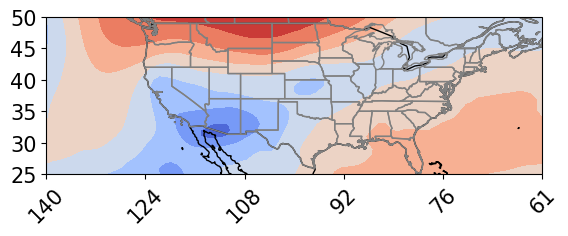

2015-05-04 00:00:00
precip rate:  0.0011095034863267625 mm/hr


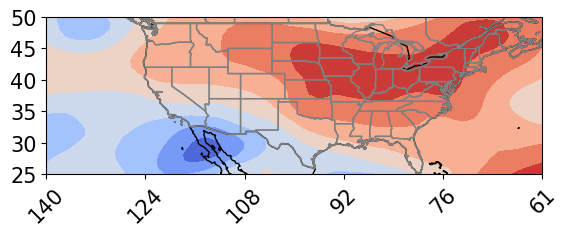

2007-06-16 00:00:00
precip rate:  0.04610264991010939 mm/hr


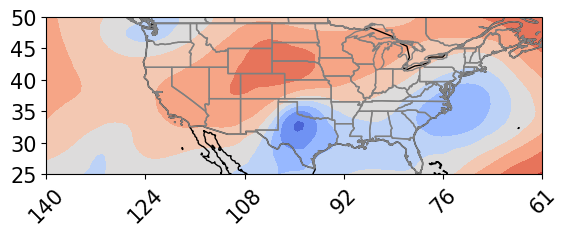

2007-06-04 00:00:00
precip rate:  4.8735913421426495e-05 mm/hr


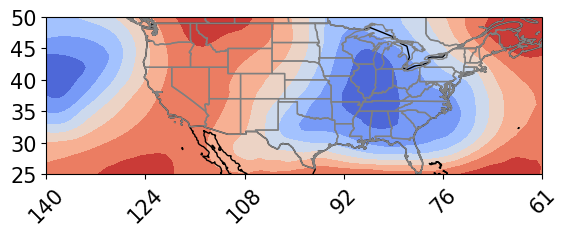

2006-05-15 00:00:00
precip rate:  0.00010889430131231038 mm/hr


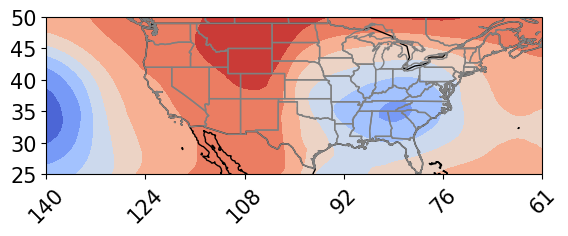

2007-05-14 00:00:00
precip rate:  5.025891054953849e-05 mm/hr


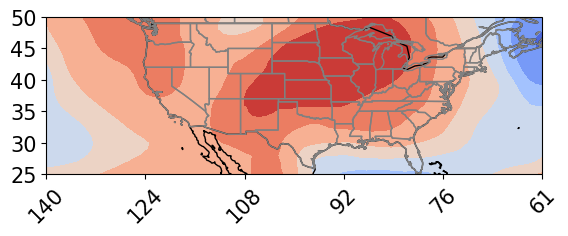

2017-07-05 00:00:00
precip rate:  3.5028936607497096e-05 mm/hr


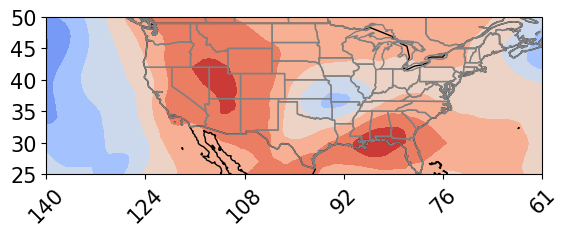

2002-06-28 00:00:00
precip rate:  0.002281449862888881 mm/hr


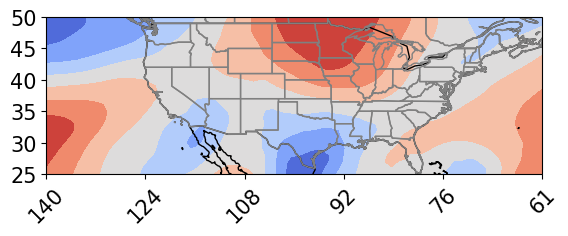

2018-09-06 00:00:00
precip rate:  0.1095590904780797 mm/hr


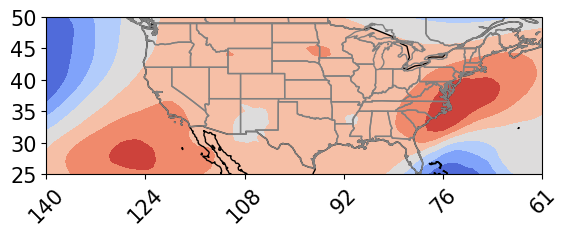

2018-07-10 00:00:00
precip rate:  0.00025129455008677084 mm/hr


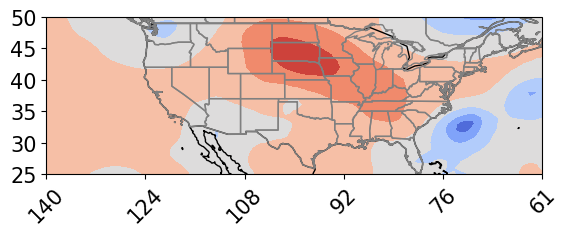

2010-07-16 00:00:00
precip rate:  0.030463753015335108 mm/hr


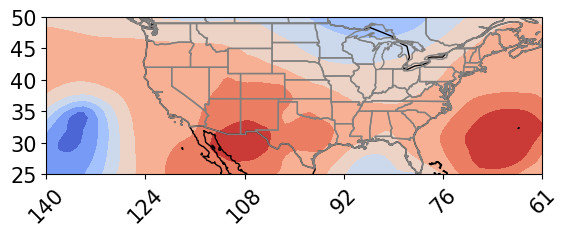

2016-06-11 00:00:00
precip rate:  0.004374809797321046 mm/hr


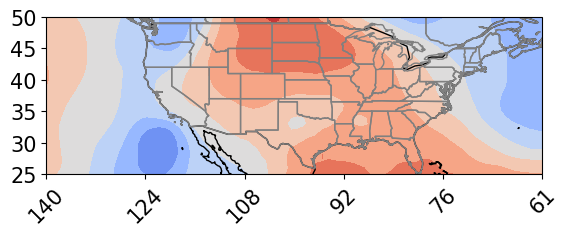

2015-06-16 00:00:00
precip rate:  0.10763554828707127 mm/hr


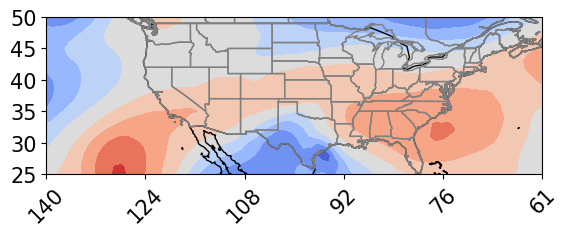

2007-06-22 00:00:00
precip rate:  0.06342445850372315 mm/hr


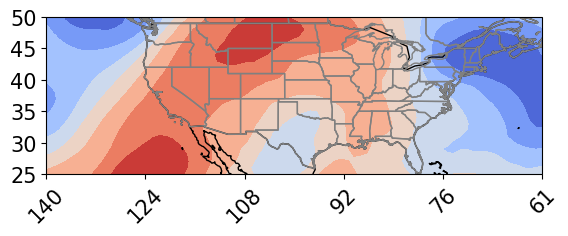

2018-09-16 00:00:00
precip rate:  0.025836126208305363 mm/hr


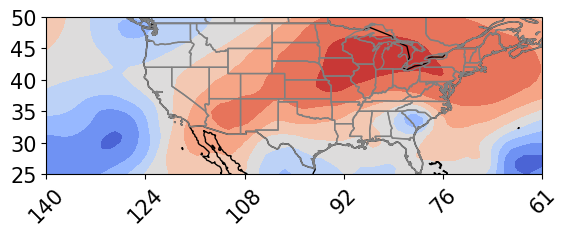

2015-06-08 00:00:00
precip rate:  0.004543100765773229 mm/hr


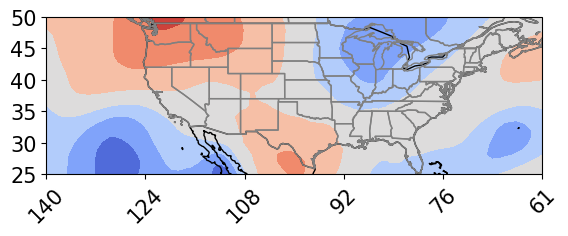

2014-06-20 00:00:00
precip rate:  4.8735913421426495e-05 mm/hr


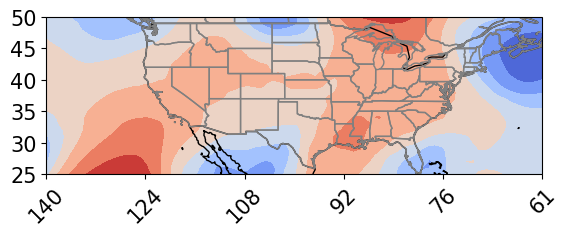

2007-05-25 00:00:00
precip rate:  0.0004325312030102525 mm/hr


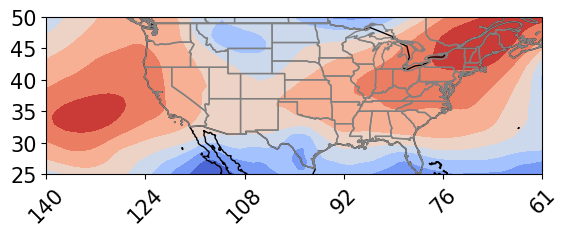

2010-05-26 00:00:00
precip rate:  0.12603944582598553 mm/hr


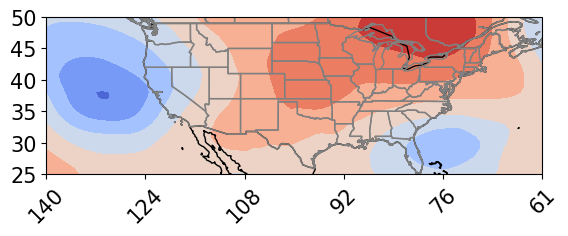

2016-06-12 00:00:00
precip rate:  0.010951111534876486 mm/hr


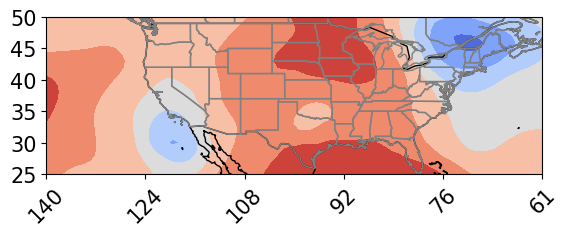

2007-06-21 00:00:00
precip rate:  0.07806655458041599 mm/hr


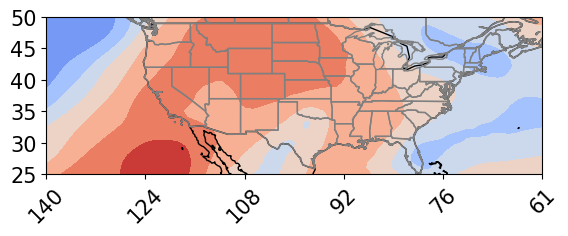

2018-09-15 00:00:00
precip rate:  0.06668443447777202 mm/hr


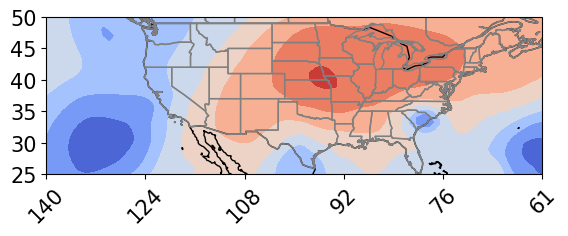

2007-07-15 00:00:00
precip rate:  0.04581480400902884 mm/hr


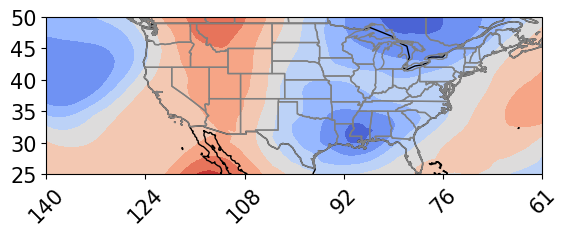

2008-07-15 00:00:00
precip rate:  1.066098056201424e-05 mm/hr


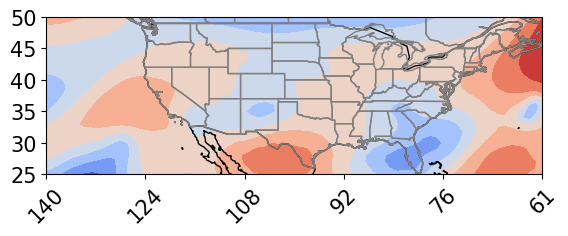

2015-07-31 00:00:00
precip rate:  0.1367605827535902 mm/hr


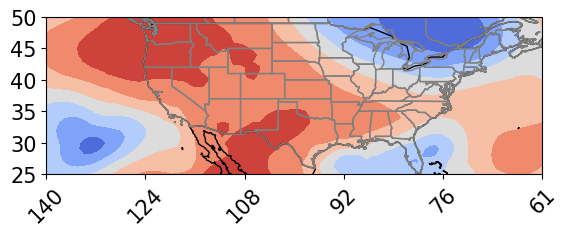

2002-05-12 00:00:00
precip rate:  0.1272273874282837 mm/hr


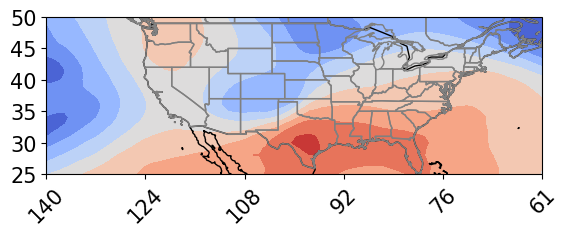

2007-07-21 00:00:00
precip rate:  0.0002611940300890377 mm/hr


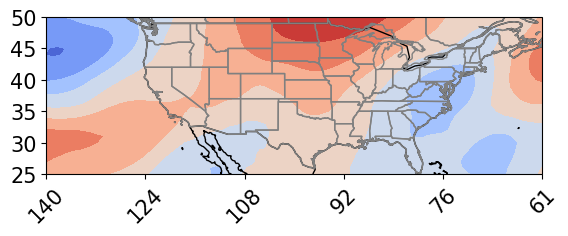

2008-07-16 00:00:00
precip rate:  0.05317849397659303 mm/hr


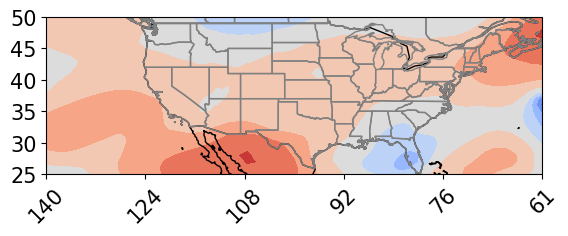

2015-05-20 00:00:00
precip rate:  0.01729287215641567 mm/hr


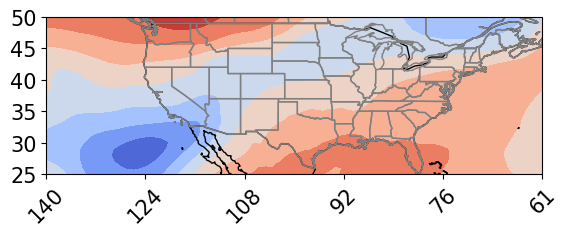

2007-06-25 00:00:00
precip rate:  0.11167834367070881 mm/hr


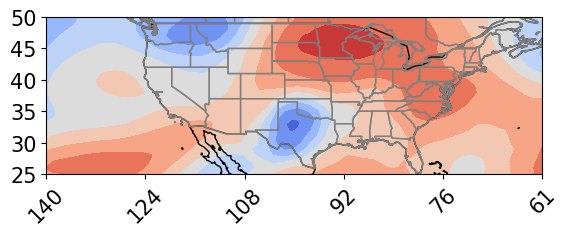

2017-08-27 00:00:00
precip rate:  0.018231038754539824 mm/hr


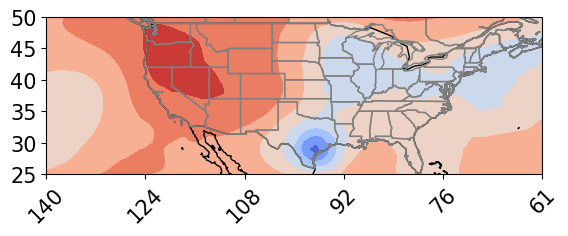

2014-07-02 00:00:00
precip rate:  9.137983433902261e-06 mm/hr


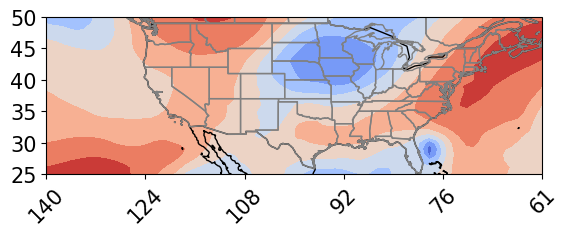

2014-07-13 00:00:00
precip rate:  0.09185958249228343 mm/hr


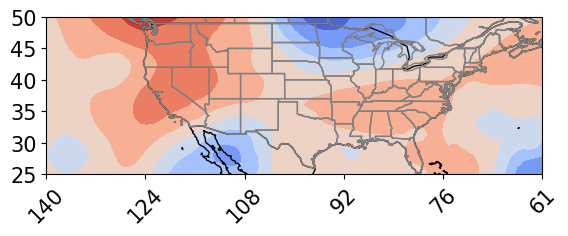

2018-07-09 00:00:00
precip rate:  7.310386747121809e-05 mm/hr


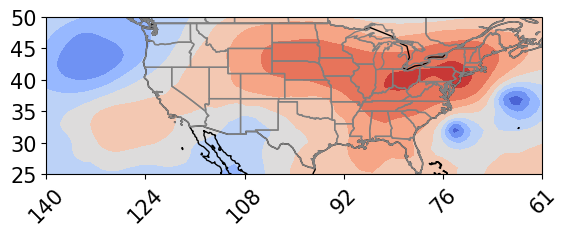

2007-05-28 00:00:00
precip rate:  0.08370469297681535 mm/hr


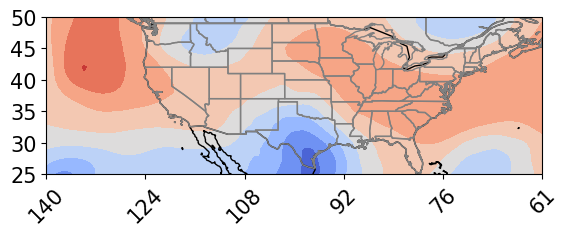

2016-06-10 00:00:00
precip rate:  0.005227688125201634 mm/hr


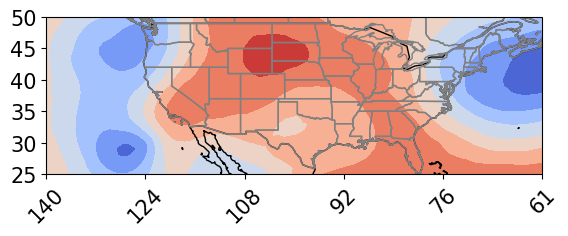

2007-06-24 00:00:00
precip rate:  0.049324549521718705 mm/hr


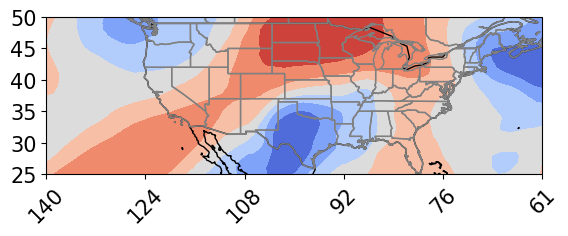

In [98]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs  # Import cartopy projections
import cartopy.feature as cfeature

latitude_size = 26
longitude_size = 80

latitudes = np.linspace(25, 50, latitude_size)
longitudes = np.linspace(220, 299, longitude_size)

for i in set(z['index']):
    print(i)
    # Create a new figure and axis for each iteration with the PlateCarree projection
    fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()})  

    # Extract and reshape z500 data
    z500 = np.array(z[z['index'] == i]['z500_stnd_anom'])
    z500 = z500.reshape(latitude_size, longitude_size)
    
    total_aft_p = np.mean(z[z['index'] == i]['afternoon'])
    print("precip rate: ", total_aft_p/7, "mm/hr")
                    
    # Contour plot
    cont = ax.contourf(longitudes, latitudes, z500, cmap='coolwarm', transform=ccrs.PlateCarree())

    # Add geographic features
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.STATES, edgecolor='gray')

    # Set longitude and latitude ticks
    ax.set_xticks(np.linspace(-140, -61, 6), crs=ccrs.PlateCarree())  # Set longitude ticks
    ax.set_yticks(np.linspace(25, 50, 6), crs=ccrs.PlateCarree())     # Set latitude ticks

    # Set labels
    ax.set_xticklabels(np.linspace(140, 61, 6).astype(int), rotation=45, fontsize=15)
    ax.set_yticklabels(np.linspace(25, 50, 6).astype(int), fontsize=15)

    # Show the plot
    plt.show()


In [59]:
# #including IVT

geo_ape_stats = z500_ivt_df[z500_ivt_df['APE']==True]

geo_ape_stats = geo_ape_stats.groupby(['lat', 'lon'])[['z500_stnd_anom', 'ivt_stnd_anom']].mean().reset_index()

geo_non_ape_stats = z500_ivt_df[z500_ivt_df['APE']==False]

geo_non_ape_stats = geo_non_ape_stats.groupby(['lat','lon'])[['z500_stnd_anom', 'ivt_stnd_anom']].mean().reset_index()

geo_wet_ape_stats = z500_ivt_df[(z500_ivt_df['APE']==True) & (z500_ivt_df['wet_coupling']==True)]

geo_wet_ape_stats = geo_wet_ape_stats.groupby(['lat','lon'])[['z500_stnd_anom', 'ivt_stnd_anom']].mean().reset_index()

geo_dry_ape_stats = z500_ivt_df[(z500_ivt_df['APE']==True) & (z500_ivt_df['dry_coupling']==True)]

geo_dry_ape_stats = geo_dry_ape_stats.groupby(['lat','lon'])[['z500_stnd_anom', 'ivt_stnd_anom']].mean().reset_index()

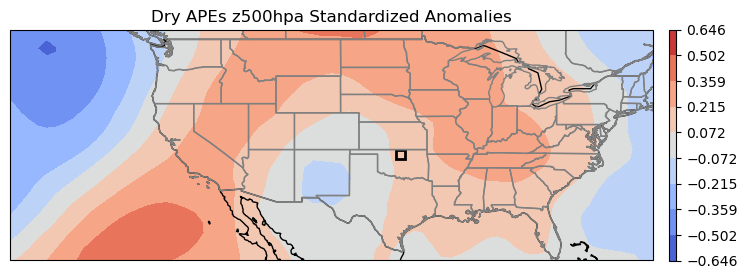

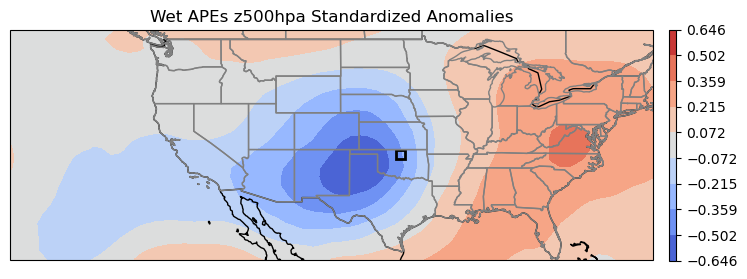

In [60]:
#z500 anomalies only 

cmap = plt.get_cmap('coolwarm')

norm = TwoSlopeNorm(vmin=-0.8, vcenter=0, vmax=0.8)

sgp_lon_min, sgp_lon_max = 262, 263

sgp_lat_min, sgp_lat_max = 36, 37

#'APEs z500hpa': geo_ape_stats,
#'Non-APEs z500hpa': geo_non_ape_stats,

dfs = {
       'Dry APEs z500hpa': geo_dry_ape_stats,
       'Wet APEs z500hpa': geo_wet_ape_stats}

min_dfs = abs(min(df['z500_stnd_anom'].min() for df in dfs.values()))

max_dfs = abs(max(df['z500_stnd_anom'].max() for df in dfs.values()))

global_max = max(min_dfs, max_dfs)

global_min = -global_max

# Adjust the normalization with the global min and max
norm = TwoSlopeNorm(vmin=global_min, vcenter=0, vmax=global_max)

for _name, df in dfs.items():
    
    lon_values = np.unique(df['lon'].values)
    
    lat_values = np.unique(df['lat'].values)
    
    norm_anom_values = df['z500_stnd_anom'].values

    lon_grid, lat_grid = np.meshgrid(lon_values, lat_values)
    
    norm_anom_2d = norm_anom_values.reshape(lon_grid.shape)
    
    plt.figure(figsize=(10, 6))
    
    ax = plt.axes(projection=ccrs.PlateCarree())
    
    ax.set_extent([220, 290, 25, 50], crs=ccrs.PlateCarree())
    
    levels = np.linspace(global_min, global_max, 10)

    contour_plot = ax.contourf(lon_grid, lat_grid, norm_anom_2d, levels=levels, cmap=cmap, norm=norm, transform=ccrs.PlateCarree())
    
    sgp_box = Rectangle((sgp_lon_min, sgp_lat_min), sgp_lon_max - sgp_lon_min, sgp_lat_max - sgp_lat_min,
                        edgecolor='black', facecolor='none', linewidth=2, transform=ccrs.PlateCarree())
    ax.add_patch(sgp_box)
    
    plt.colorbar(contour_plot, ax=ax, orientation='vertical', pad=0.02, aspect=30, shrink=0.5)
    
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    
    ax.add_feature(cfeature.COASTLINE)
    
    ax.add_feature(cfeature.BORDERS)
    
    ax.add_feature(cfeature.STATES, edgecolor='gray')
    
    plt.title('{} Standardized Anomalies'.format(_name))
    
    plt.grid(True)
    
    plt.show()



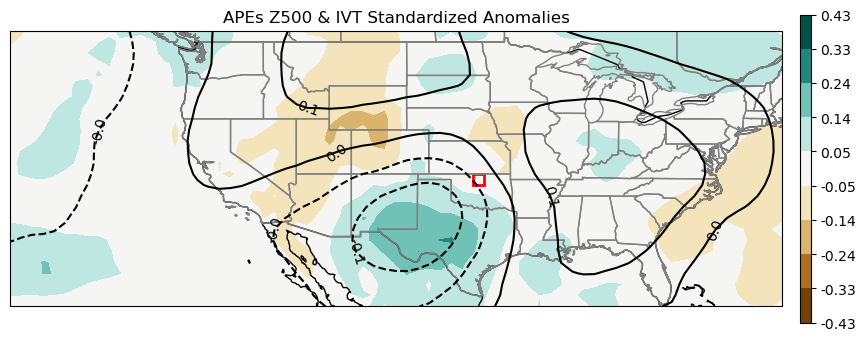

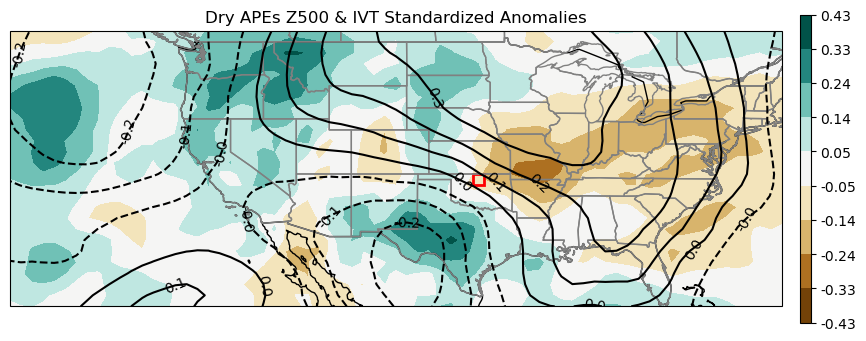

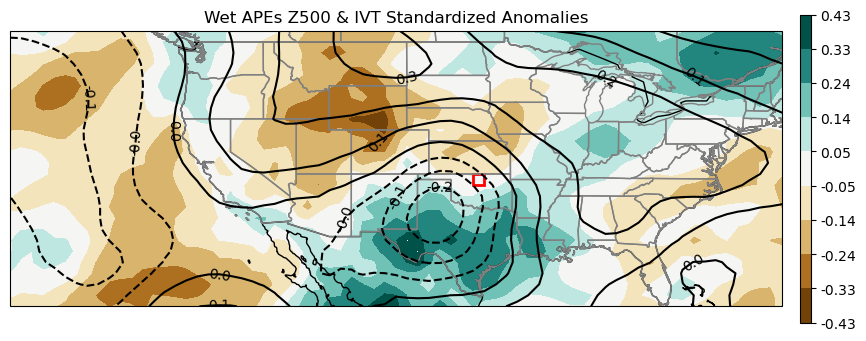

In [52]:
#same as above but including IVT

# Common parameters for color normalization
cmap = 'BrBG'

# Define the geographical boundaries and SGP box coordinates
sgp_lon_min, sgp_lon_max = 262, 263

sgp_lat_min, sgp_lat_max = 36, 37

dfs = {
    'APEs Z500 & IVT': geo_ape_stats,
    'Dry APEs Z500 & IVT': geo_dry_ape_stats,
    'Wet APEs Z500 & IVT': geo_wet_ape_stats
}

min_dfs = abs(min(df['z500_stnd_anom'].min() for df in dfs.values()))

max_dfs = abs(max(df['z500_stnd_anom'].max() for df in dfs.values()))

global_max = max(min_dfs, max_dfs)

global_min = -global_max

# Adjust the normalization with the global min and max
norm = TwoSlopeNorm(vmin=global_min, vcenter=0, vmax=global_max)

for _name, df in dfs.items():
    lon_values = np.unique(df['lon'].values)
    lat_values = np.unique(df['lat'].values)
    z500_anom_values = df['z500_stnd_anom'].values
    ivt_anom_values = df['ivt_stnd_anom'].values

    lon_grid, lat_grid = np.meshgrid(lon_values, lat_values)
    z500_anom_2d = z500_anom_values.reshape(lon_grid.shape)
    ivt_anom_2d = ivt_anom_values.reshape(lon_grid.shape)
    
    plt.figure(figsize=(12, 8))
    
    ax = plt.axes(projection=ccrs.PlateCarree())
    
    ax.set_extent([220, 290, 25, 50], crs=ccrs.PlateCarree())
    
    levels = np.linspace(global_min, global_max, 10)

    # Plot IVT data with diverging colormap
    ivt_plot = ax.contourf(lon_grid, lat_grid, ivt_anom_2d, cmap=cmap, norm=norm, transform=ccrs.PlateCarree(), levels=levels)

    # Add a colorbar for IVT with fixed vmin and vmax
    cbar = plt.colorbar(ivt_plot, ax=ax,orientation='vertical', pad=0.02, aspect=30, shrink=0.5, norm=norm)
    
    cbar.ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.2f'))

    # Define contour levels for Z500
#     levels = np.linspace(-0.9, 0.9, 10)
    
    # Plot Z500 contours with default linestyle (solid lines)
    cont = ax.contour(lon_grid, lat_grid, z500_anom_2d, levels=levels, colors='black', transform=ccrs.PlateCarree())
    
    # Update linestyle for negative contours to dashed
    for i, collection in enumerate(cont.collections):
        level = cont.levels[i]
        if level < 0:
            collection.set_linestyle('dashed')
    
    ax.clabel(cont, fmt='%1.1f', fontsize=10)

    # Add SGP box
    sgp_box = Rectangle((sgp_lon_min, sgp_lat_min), sgp_lon_max - sgp_lon_min, sgp_lat_max - sgp_lat_min,
                        edgecolor='red', facecolor='none', linewidth=2, transform=ccrs.PlateCarree())
    ax.add_patch(sgp_box)
    
    # Add geographical features
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.STATES, edgecolor='gray')
    
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    
    plt.title('{} Standardized Anomalies'.format(_name))
    plt.grid(True)
    plt.show()


## scratch below, wrong way for stnd anomalies

## Climatology of wind-speeds & humidity

In [65]:
def warm_season_climatology(df_list):
    
    count=0

    final_list = []

    for df in df_list: 

        plev = 700

        levels = df['level'].data

        time = df['time'].data

        idx_plev = np.where(levels==plev)[0][0]

        lat_range = df['latitude'].data[0:5]

        lon_range = df['longitude'].data[0:5]

        for t in range(time.shape[0]):

            lst = pd.to_datetime(time[t]) - timedelta(hours=6)

            if (5 <= lst.month <= 9):

                for lat_idx in range(lat_range.shape[0]):

                    for lon_idx in range(lon_range.shape[0]):

                        u = df['u'].data[t][idx_plev][lat_idx][lon_idx]

                        v = df['v'].data[t][idx_plev][lat_idx][lon_idx]

                        w = df['w'].data[t][idx_plev][lat_idx][lon_idx]
                        
                        q = df['q'].data[t][idx_plev][lat_idx][lon_idx]

                        tup = (lst, lat_range[lat_idx], lon_range[lon_idx], u, v, w, q)

                        final_list.append(tup)
                        
                        count+=1
                        print((count/550800)*100, "complete")
    
    return(final_list)


df_list = [era13, era46, era79, era1012, era1315, era1618]

clim = pd.DataFrame(warm_season_climatology(df_list),columns=['time', 'lat', 'lon', 'u','v','w','q'])               
        

0.00018155410312273057 complete
0.00036310820624546115 complete
0.0005446623093681917 complete
0.0007262164124909223 complete
0.0009077705156136529 complete
0.0010893246187363833 complete
0.001270878721859114 complete
0.0014524328249818446 complete
0.0016339869281045754 complete
0.0018155410312273058 complete
0.0019970951343500363 complete
0.0021786492374727667 complete
0.0023602033405954975 complete
0.002541757443718228 complete
0.0027233115468409583 complete
0.002904865649963689 complete
0.00308641975308642 complete
0.003267973856209151 complete
0.003449527959331881 complete
0.0036310820624546117 complete
0.0038126361655773417 complete
0.0039941902687000725 complete
0.004175744371822804 complete
0.004357298474945533 complete
0.004538852578068265 complete
0.004720406681190995 complete
0.004901960784313725 complete
0.005083514887436456 complete
0.005265068990559187 complete
0.005446623093681917 complete
0.005628177196804648 complete
0.005809731299927378 complete
0.005991285403050109 co

0.32861292665214237 complete
0.3287944807552651 complete
0.3289760348583878 complete
0.32915758896151054 complete
0.32933914306463324 complete
0.329520697167756 complete
0.3297022512708787 complete
0.32988380537400147 complete
0.3300653594771242 complete
0.33024691358024694 complete
0.33042846768336964 complete
0.3306100217864924 complete
0.3307915758896151 complete
0.3309731299927378 complete
0.3311546840958606 complete
0.3313362381989833 complete
0.331517792302106 complete
0.3316993464052288 complete
0.3318809005083515 complete
0.3320624546114742 complete
0.332244008714597 complete
0.3324255628177197 complete
0.3326071169208424 complete
0.33278867102396514 complete
0.33297022512708785 complete
0.3331517792302106 complete
0.33333333333333337 complete
0.3335148874364561 complete
0.3336964415395788 complete
0.33387799564270154 complete
0.33405954974582425 complete
0.334241103848947 complete
0.3344226579520697 complete
0.3346042120551924 complete
0.3347857661583152 complete
0.33496732026

0.764161220043573 complete
0.7643427741466957 complete
0.7645243282498184 complete
0.7647058823529412 complete
0.7648874364560639 complete
0.7650689905591866 complete
0.7652505446623094 complete
0.7654320987654322 complete
0.7656136528685549 complete
0.7657952069716776 complete
0.7659767610748003 complete
0.766158315177923 complete
0.7663398692810458 complete
0.7665214233841685 complete
0.7667029774872912 complete
0.7668845315904139 complete
0.7670660856935366 complete
0.7672476397966593 complete
0.7674291938997821 complete
0.7676107480029049 complete
0.7677923021060276 complete
0.7679738562091503 complete
0.7681554103122731 complete
0.7683369644153958 complete
0.7685185185185186 complete
0.7687000726216413 complete
0.768881626724764 complete
0.7690631808278867 complete
0.7692447349310094 complete
0.7694262890341321 complete
0.7696078431372549 complete
0.7697893972403776 complete
0.7699709513435004 complete
0.7701525054466231 complete
0.7703340595497458 complete
0.7705156136528686 comp

1.2024328249818446 complete
1.2026143790849673 complete
1.20279593318809 complete
1.202977487291213 complete
1.2031590413943356 complete
1.2033405954974583 complete
1.203522149600581 complete
1.2037037037037037 complete
1.2038852578068264 complete
1.2040668119099491 complete
1.2042483660130718 complete
1.2044299201161945 complete
1.2046114742193172 complete
1.20479302832244 complete
1.2049745824255629 complete
1.2051561365286856 complete
1.2053376906318083 complete
1.205519244734931 complete
1.2057007988380537 complete
1.2058823529411764 complete
1.206063907044299 complete
1.2062454611474218 complete
1.2064270152505445 complete
1.2066085693536672 complete
1.2067901234567902 complete
1.2069716775599129 complete
1.2071532316630356 complete
1.2073347857661585 complete
1.2075163398692812 complete
1.207697893972404 complete
1.2078794480755266 complete
1.2080610021786493 complete
1.208242556281772 complete
1.2084241103848947 complete
1.2086056644880174 complete
1.2087872185911401 complete
1.

1.6497821350762525 complete
1.6499636891793754 complete
1.6501452432824981 complete
1.650326797385621 complete
1.6505083514887435 complete
1.6506899055918665 complete
1.650871459694989 complete
1.6510530137981119 complete
1.6512345679012344 complete
1.6514161220043573 complete
1.6515976761074798 complete
1.6517792302106027 complete
1.6519607843137256 complete
1.6521423384168483 complete
1.652323892519971 complete
1.6525054466230937 complete
1.6526870007262167 complete
1.6528685548293391 complete
1.653050108932462 complete
1.6532316630355846 complete
1.6534132171387075 complete
1.65359477124183 complete
1.653776325344953 complete
1.6539578794480754 complete
1.6541394335511983 complete
1.654320987654321 complete
1.6545025417574437 complete
1.6546840958605664 complete
1.6548656499636893 complete
1.6550472040668118 complete
1.6552287581699348 complete
1.6554103122730572 complete
1.6555918663761802 complete
1.6557734204793026 complete
1.6559549745824256 complete
1.6561365286855483 complete


2.0929557007988384 complete
2.093137254901961 complete
2.093318809005084 complete
2.0935003631082063 complete
2.0936819172113292 complete
2.0938634713144517 complete
2.0940450254175746 complete
2.094226579520697 complete
2.09440813362382 complete
2.0945896877269425 complete
2.0947712418300655 complete
2.094952795933188 complete
2.095134350036311 complete
2.0953159041394334 complete
2.0954974582425563 complete
2.0956790123456788 complete
2.0958605664488017 complete
2.096042120551924 complete
2.096223674655047 complete
2.09640522875817 complete
2.0965867828612925 complete
2.0967683369644154 complete
2.0969498910675384 complete
2.097131445170661 complete
2.097312999273784 complete
2.0974945533769063 complete
2.097676107480029 complete
2.0978576615831517 complete
2.0980392156862746 complete
2.098220769789397 complete
2.09840232389252 complete
2.0985838779956425 complete
2.0987654320987654 complete
2.098946986201888 complete
2.099128540305011 complete
2.0993100944081333 complete
2.099491648

2.539760348583878 complete
2.5399419026870005 complete
2.5401234567901234 complete
2.540305010893246 complete
2.540486564996369 complete
2.5406681190994918 complete
2.5408496732026142 complete
2.541031227305737 complete
2.5412127814088596 complete
2.5413943355119826 complete
2.541575889615105 complete
2.541757443718228 complete
2.541938997821351 complete
2.542120551924474 complete
2.5423021060275963 complete
2.5424836601307192 complete
2.5426652142338417 complete
2.5428467683369647 complete
2.543028322440087 complete
2.54320987654321 complete
2.5433914306463326 complete
2.5435729847494555 complete
2.543754538852578 complete
2.543936092955701 complete
2.5441176470588234 complete
2.5442992011619463 complete
2.544480755265069 complete
2.5446623093681917 complete
2.544843863471314 complete
2.545025417574437 complete
2.5452069716775596 complete
2.5453885257806825 complete
2.5455700798838055 complete
2.545751633986928 complete
2.545933188090051 complete
2.546114742193174 complete
2.546296296

2.9865649963689176 complete
2.9867465504720405 complete
2.9869281045751634 complete
2.9871096586782864 complete
2.987291212781409 complete
2.987472766884532 complete
2.9876543209876543 complete
2.987835875090777 complete
2.9880174291938997 complete
2.9881989832970226 complete
2.988380537400145 complete
2.988562091503268 complete
2.988743645606391 complete
2.9889251997095134 complete
2.9891067538126364 complete
2.989288307915759 complete
2.9894698620188818 complete
2.9896514161220042 complete
2.989832970225127 complete
2.9900145243282497 complete
2.9901960784313726 complete
2.990377632534495 complete
2.990559186637618 complete
2.9907407407407405 complete
2.9909222948438634 complete
2.9911038489469863 complete
2.9912854030501093 complete
2.9914669571532317 complete
2.9916485112563547 complete
2.991830065359477 complete
2.9920116194626 complete
2.9921931735657226 complete
2.9923747276688455 complete
2.992556281771968 complete
2.992737835875091 complete
2.9929193899782134 complete
2.993100

3.433188090050835 complete
3.433369644153958 complete
3.433551198257081 complete
3.433732752360203 complete
3.433914306463326 complete
3.434095860566449 complete
3.434277414669572 complete
3.434458968772694 complete
3.434640522875817 complete
3.4348220769789397 complete
3.4350036310820626 complete
3.4351851851851847 complete
3.4353667392883076 complete
3.4355482933914305 complete
3.4357298474945535 complete
3.435911401597676 complete
3.436092955700799 complete
3.436274509803922 complete
3.4364560639070443 complete
3.436637618010167 complete
3.4368191721132897 complete
3.4370007262164126 complete
3.4371822803195355 complete
3.4373638344226585 complete
3.4375453885257805 complete
3.4377269426289034 complete
3.4379084967320264 complete
3.4380900508351493 complete
3.4382716049382713 complete
3.4384531590413943 complete
3.438634713144517 complete
3.43881626724764 complete
3.438997821350762 complete
3.439179375453885 complete
3.439360929557008 complete
3.439542483660131 complete
3.4397240377

3.881445170660857 complete
3.8816267247639797 complete
3.8818082788671022 complete
3.881989832970225 complete
3.882171387073348 complete
3.882352941176471 complete
3.882534495279593 complete
3.882716049382716 complete
3.882897603485839 complete
3.883079157588962 complete
3.883260711692084 complete
3.883442265795207 complete
3.8836238198983297 complete
3.8838053740014526 complete
3.8839869281045747 complete
3.8841684822076976 complete
3.8843500363108205 complete
3.8845315904139435 complete
3.8847131445170664 complete
3.8848946986201884 complete
3.8850762527233114 complete
3.8852578068264343 complete
3.885439360929557 complete
3.8856209150326797 complete
3.8858024691358026 complete
3.885984023238925 complete
3.886165577342048 complete
3.8863471314451705 complete
3.8865286855482934 complete
3.8867102396514164 complete
3.8868917937545393 complete
3.8870733478576613 complete
3.8872549019607843 complete
3.887436456063907 complete
3.88761801016703 complete
3.887799564270152 complete
3.8879811

4.325526506899056 complete
4.325708061002179 complete
4.325889615105302 complete
4.326071169208425 complete
4.326252723311547 complete
4.32643427741467 complete
4.326615831517793 complete
4.326797385620916 complete
4.326978939724038 complete
4.327160493827161 complete
4.3273420479302835 complete
4.3275236020334065 complete
4.3277051561365285 complete
4.327886710239651 complete
4.328068264342774 complete
4.328249818445897 complete
4.328431372549019 complete
4.328612926652142 complete
4.328794480755265 complete
4.328976034858388 complete
4.32915758896151 complete
4.329339143064633 complete
4.329520697167756 complete
4.329702251270879 complete
4.329883805374001 complete
4.330065359477124 complete
4.330246913580247 complete
4.33042846768337 complete
4.330610021786492 complete
4.330791575889615 complete
4.330973129992738 complete
4.331154684095861 complete
4.331336238198983 complete
4.3315177923021055 complete
4.3316993464052285 complete
4.331880900508351 complete
4.332062454611474 complete

4.773965141612201 complete
4.774146695715324 complete
4.774328249818446 complete
4.7745098039215685 complete
4.7746913580246915 complete
4.774872912127814 complete
4.775054466230936 complete
4.775236020334059 complete
4.775417574437182 complete
4.775599128540305 complete
4.775780682643427 complete
4.77596223674655 complete
4.776143790849673 complete
4.776325344952796 complete
4.776506899055918 complete
4.776688453159041 complete
4.776870007262164 complete
4.777051561365287 complete
4.777233115468409 complete
4.777414669571532 complete
4.777596223674655 complete
4.777777777777778 complete
4.777959331880901 complete
4.7781408859840235 complete
4.7783224400871465 complete
4.7785039941902685 complete
4.778685548293391 complete
4.778867102396514 complete
4.779048656499637 complete
4.77923021060276 complete
4.779411764705882 complete
4.779593318809005 complete
4.779774872912128 complete
4.779956427015251 complete
4.780137981118373 complete
4.780319535221496 complete
4.780501089324619 complet

5.2216775599128535 complete
5.2218591140159765 complete
5.222040668119099 complete
5.222222222222222 complete
5.222403776325344 complete
5.222585330428467 complete
5.22276688453159 complete
5.222948438634713 complete
5.223129992737836 complete
5.223311546840959 complete
5.223493100944081 complete
5.223674655047204 complete
5.223856209150327 complete
5.22403776325345 complete
5.224219317356573 complete
5.224400871459696 complete
5.224582425562818 complete
5.224763979665941 complete
5.224945533769064 complete
5.2251270878721865 complete
5.2253086419753085 complete
5.2254901960784315 complete
5.225671750181554 complete
5.225853304284677 complete
5.226034858387799 complete
5.226216412490922 complete
5.226397966594045 complete
5.226579520697168 complete
5.22676107480029 complete
5.226942628903413 complete
5.227124183006536 complete
5.227305737109659 complete
5.227487291212781 complete
5.227668845315904 complete
5.227850399419027 complete
5.22803195352215 complete
5.228213507625273 complete


5.555737109658678 complete
5.555918663761801 complete
5.556100217864924 complete
5.556281771968046 complete
5.556463326071169 complete
5.556644880174292 complete
5.556826434277415 complete
5.557007988380537 complete
5.55718954248366 complete
5.557371096586783 complete
5.557552650689906 complete
5.557734204793029 complete
5.557915758896151 complete
5.558097312999274 complete
5.558278867102397 complete
5.5584604212055195 complete
5.558641975308642 complete
5.5588235294117645 complete
5.559005083514887 complete
5.55918663761801 complete
5.559368191721132 complete
5.559549745824255 complete
5.559731299927378 complete
5.559912854030501 complete
5.560094408133623 complete
5.560275962236746 complete
5.560457516339869 complete
5.560639070442992 complete
5.560820624546114 complete
5.561002178649237 complete
5.56118373275236 complete
5.561365286855483 complete
5.561546840958606 complete
5.561728395061729 complete
5.561909949164852 complete
5.562091503267974 complete
5.562273057371097 complete
5.

6.0281408859840235 complete
6.028322440087146 complete
6.0285039941902685 complete
6.028685548293391 complete
6.028867102396514 complete
6.029048656499636 complete
6.029230210602759 complete
6.029411764705882 complete
6.029593318809005 complete
6.029774872912127 complete
6.02995642701525 complete
6.030137981118373 complete
6.030319535221496 complete
6.030501089324618 complete
6.030682643427741 complete
6.030864197530864 complete
6.031045751633987 complete
6.03122730573711 complete
6.031408859840233 complete
6.031590413943356 complete
6.031771968046478 complete
6.031953522149601 complete
6.0321350762527235 complete
6.032316630355846 complete
6.032498184458969 complete
6.032679738562091 complete
6.032861292665214 complete
6.033042846768337 complete
6.03322440087146 complete
6.033405954974583 complete
6.033587509077705 complete
6.033769063180828 complete
6.033950617283951 complete
6.034132171387074 complete
6.034313725490196 complete
6.034495279593319 complete
6.034676833696442 complete
6

6.477305737109659 complete
6.477487291212782 complete
6.477668845315904 complete
6.477850399419028 complete
6.47803195352215 complete
6.478213507625272 complete
6.478395061728396 complete
6.478576615831518 complete
6.4787581699346415 complete
6.4789397240377635 complete
6.479121278140886 complete
6.479302832244009 complete
6.479484386347131 complete
6.4796659404502535 complete
6.479847494553377 complete
6.480029048656499 complete
6.480210602759623 complete
6.480392156862745 complete
6.480573710965867 complete
6.480755265068991 complete
6.480936819172113 complete
6.481118373275237 complete
6.481299927378359 complete
6.481481481481481 complete
6.481663035584605 complete
6.481844589687727 complete
6.482026143790849 complete
6.482207697893973 complete
6.482389251997095 complete
6.4825708061002185 complete
6.482752360203341 complete
6.482933914306463 complete
6.483115468409586 complete
6.4832970225127085 complete
6.4834785766158305 complete
6.483660130718954 complete
6.483841684822076 compl

6.9264705882352935 complete
6.926652142338417 complete
6.926833696441539 complete
6.927015250544661 complete
6.927196804647785 complete
6.927378358750907 complete
6.927559912854031 complete
6.927741466957153 complete
6.927923021060275 complete
6.928104575163399 complete
6.928286129266521 complete
6.928467683369643 complete
6.928649237472767 complete
6.928830791575889 complete
6.929012345679013 complete
6.929193899782135 complete
6.929375453885258 complete
6.929557007988381 complete
6.929738562091503 complete
6.9299201161946264 complete
6.9301016702977485 complete
6.930283224400871 complete
6.930464778503994 complete
6.930646332607117 complete
6.930827886710239 complete
6.931009440813362 complete
6.931190994916485 complete
6.931372549019608 complete
6.931554103122731 complete
6.931735657225853 complete
6.931917211328977 complete
6.932098765432099 complete
6.932280319535221 complete
6.932461873638345 complete
6.932643427741467 complete
6.932824981844591 complete
6.933006535947713 complet

7.374727668845315 complete
7.374909222948439 complete
7.375090777051561 complete
7.375272331154684 complete
7.375453885257807 complete
7.37563543936093 complete
7.375816993464052 complete
7.375998547567175 complete
7.376180101670298 complete
7.376361655773421 complete
7.3765432098765435 complete
7.376724763979666 complete
7.376906318082789 complete
7.377087872185911 complete
7.377269426289034 complete
7.377450980392157 complete
7.377632534495279 complete
7.377814088598403 complete
7.377995642701525 complete
7.378177196804647 complete
7.378358750907771 complete
7.378540305010893 complete
7.378721859114017 complete
7.378903413217139 complete
7.379084967320261 complete
7.379266521423385 complete
7.379448075526507 complete
7.379629629629629 complete
7.379811183732753 complete
7.379992737835875 complete
7.3801742919389985 complete
7.380355846042121 complete
7.380537400145243 complete
7.380718954248366 complete
7.3809005083514885 complete
7.3810820624546105 complete
7.381263616557734 complet

7.810820624546115 complete
7.811002178649237 complete
7.811183732752361 complete
7.811365286855483 complete
7.811546840958606 complete
7.811728395061729 complete
7.811909949164851 complete
7.812091503267974 complete
7.812273057371097 complete
7.8124546114742195 complete
7.812636165577342 complete
7.812817719680465 complete
7.812999273783587 complete
7.81318082788671 complete
7.813362381989833 complete
7.813543936092955 complete
7.813725490196079 complete
7.813907044299201 complete
7.814088598402325 complete
7.814270152505447 complete
7.814451706608569 complete
7.814633260711693 complete
7.814814814814815 complete
7.814996368917937 complete
7.815177923021061 complete
7.815359477124183 complete
7.815541031227307 complete
7.815722585330429 complete
7.815904139433551 complete
7.8160856935366745 complete
7.8162672476397965 complete
7.816448801742919 complete
7.816630355846042 complete
7.816811909949164 complete
7.816993464052288 complete
7.81717501815541 complete
7.817356572258532 complete


8.247639796659405 complete
8.247821350762527 complete
8.24800290486565 complete
8.248184458968773 complete
8.248366013071895 complete
8.248547567175018 complete
8.24872912127814 complete
8.248910675381262 complete
8.249092229484386 complete
8.249273783587508 complete
8.249455337690632 complete
8.249636891793754 complete
8.249818445896876 complete
8.25 complete
8.250181554103122 complete
8.250363108206244 complete
8.250544662309368 complete
8.25072621641249 complete
8.250907770515614 complete
8.251089324618736 complete
8.251270878721858 complete
8.251452432824982 complete
8.251633986928104 complete
8.251815541031227 complete
8.25199709513435 complete
8.252178649237472 complete
8.252360203340595 complete
8.252541757443717 complete
8.252723311546841 complete
8.252904865649963 complete
8.253086419753085 complete
8.25326797385621 complete
8.253449527959331 complete
8.253631082062455 complete
8.253812636165577 complete
8.2539941902687 complete
8.254175744371823 complete
8.254357298474947 com

8.69553376906318 complete
8.695715323166302 complete
8.695896877269426 complete
8.696078431372548 complete
8.69625998547567 complete
8.696441539578794 complete
8.696623093681916 complete
8.69680464778504 complete
8.696986201888162 complete
8.697167755991284 complete
8.697349310094408 complete
8.69753086419753 complete
8.697712418300654 complete
8.697893972403776 complete
8.698075526506898 complete
8.698257080610022 complete
8.698438634713144 complete
8.698620188816268 complete
8.69880174291939 complete
8.698983297022513 complete
8.699164851125635 complete
8.69934640522876 complete
8.699527959331881 complete
8.699709513435003 complete
8.699891067538127 complete
8.70007262164125 complete
8.700254175744373 complete
8.700435729847495 complete
8.700617283950617 complete
8.70079883805374 complete
8.700980392156863 complete
8.701161946259987 complete
8.701343500363109 complete
8.70152505446623 complete
8.701706608569355 complete
8.701888162672477 complete
8.7020697167756 complete
8.7022512708

9.142883079157588 complete
9.14306463326071 complete
9.143246187363834 complete
9.143427741466956 complete
9.14360929557008 complete
9.143790849673202 complete
9.143972403776326 complete
9.144153957879448 complete
9.144335511982572 complete
9.144517066085694 complete
9.144698620188816 complete
9.14488017429194 complete
9.145061728395062 complete
9.145243282498186 complete
9.145424836601308 complete
9.14560639070443 complete
9.145787944807553 complete
9.145969498910675 complete
9.1461510530138 complete
9.146332607116921 complete
9.146514161220043 complete
9.146695715323167 complete
9.14687726942629 complete
9.147058823529413 complete
9.147240377632535 complete
9.147421931735657 complete
9.147603485838781 complete
9.147785039941903 complete
9.147966594045027 complete
9.148148148148149 complete
9.14832970225127 complete
9.148511256354395 complete
9.148692810457517 complete
9.148874364560639 complete
9.149055918663763 complete
9.149237472766885 complete
9.149419026870008 complete
9.1496005

9.580973129992739 complete
9.58115468409586 complete
9.581336238198983 complete
9.581517792302106 complete
9.581699346405228 complete
9.581880900508352 complete
9.582062454611474 complete
9.582244008714596 complete
9.58242556281772 complete
9.582607116920842 complete
9.582788671023964 complete
9.582970225127088 complete
9.58315177923021 complete
9.583333333333334 complete
9.583514887436456 complete
9.583696441539578 complete
9.583877995642702 complete
9.584059549745824 complete
9.584241103848946 complete
9.58442265795207 complete
9.584604212055192 complete
9.584785766158316 complete
9.584967320261438 complete
9.58514887436456 complete
9.585330428467683 complete
9.585511982570806 complete
9.585693536673928 complete
9.585875090777051 complete
9.586056644880173 complete
9.586238198983297 complete
9.58641975308642 complete
9.586601307189541 complete
9.586782861292665 complete
9.586964415395787 complete
9.58714596949891 complete
9.587327523602033 complete
9.587509077705155 complete
9.587690

10.0279593318809 complete
10.028140885984023 complete
10.028322440087146 complete
10.028503994190269 complete
10.02868554829339 complete
10.028867102396514 complete
10.029048656499636 complete
10.029230210602758 complete
10.029411764705882 complete
10.029593318809004 complete
10.029774872912128 complete
10.02995642701525 complete
10.030137981118372 complete
10.030319535221496 complete
10.030501089324618 complete
10.030682643427742 complete
10.030864197530864 complete
10.031045751633986 complete
10.03122730573711 complete
10.031408859840232 complete
10.031590413943354 complete
10.031771968046478 complete
10.0319535221496 complete
10.032135076252723 complete
10.032316630355846 complete
10.032498184458968 complete
10.032679738562091 complete
10.032861292665213 complete
10.033042846768335 complete
10.03322440087146 complete
10.033405954974581 complete
10.033587509077705 complete
10.033769063180827 complete
10.033950617283951 complete
10.034132171387073 complete
10.034313725490197 complete


10.458242556281771 complete
10.458424110384895 complete
10.458605664488017 complete
10.458787218591139 complete
10.458968772694263 complete
10.459150326797385 complete
10.459331880900509 complete
10.45951343500363 complete
10.459694989106753 complete
10.459876543209877 complete
10.460058097312999 complete
10.46023965141612 complete
10.460421205519244 complete
10.460602759622367 complete
10.46078431372549 complete
10.460965867828612 complete
10.461147421931734 complete
10.461328976034858 complete
10.46151053013798 complete
10.461692084241104 complete
10.461873638344226 complete
10.462055192447348 complete
10.462236746550472 complete
10.462418300653594 complete
10.462599854756718 complete
10.46278140885984 complete
10.462962962962962 complete
10.463144517066086 complete
10.463326071169208 complete
10.463507625272332 complete
10.463689179375454 complete
10.463870733478577 complete
10.4640522875817 complete
10.464233841684823 complete
10.464415395787945 complete
10.464596949891067 complete

10.895424836601308 complete
10.89560639070443 complete
10.895787944807553 complete
10.895969498910675 complete
10.8961510530138 complete
10.896332607116921 complete
10.896514161220043 complete
10.896695715323167 complete
10.89687726942629 complete
10.897058823529411 complete
10.897240377632535 complete
10.897421931735657 complete
10.897603485838781 complete
10.897785039941903 complete
10.897966594045025 complete
10.898148148148149 complete
10.89832970225127 complete
10.898511256354395 complete
10.898692810457517 complete
10.898874364560639 complete
10.899055918663763 complete
10.899237472766885 complete
10.899419026870007 complete
10.89960058097313 complete
10.899782135076252 complete
10.899963689179376 complete
10.900145243282498 complete
10.90032679738562 complete
10.900508351488744 complete
10.900689905591866 complete
10.900871459694988 complete
10.901053013798112 complete
10.901234567901234 complete
10.901416122004358 complete
10.90159767610748 complete
10.901779230210602 complete


11.167392883079158 complete
11.16757443718228 complete
11.167755991285402 complete
11.167937545388526 complete
11.168119099491648 complete
11.168300653594772 complete
11.168482207697894 complete
11.168663761801016 complete
11.16884531590414 complete
11.169026870007261 complete
11.169208424110384 complete
11.169389978213507 complete
11.16957153231663 complete
11.169753086419753 complete
11.169934640522875 complete
11.170116194625997 complete
11.170297748729121 complete
11.170479302832243 complete
11.170660856935367 complete
11.170842411038489 complete
11.171023965141611 complete
11.171205519244735 complete
11.171387073347857 complete
11.17156862745098 complete
11.171750181554103 complete
11.171931735657225 complete
11.172113289760349 complete
11.17229484386347 complete
11.172476397966594 complete
11.172657952069716 complete
11.17283950617284 complete
11.173021060275962 complete
11.173202614379086 complete
11.173384168482208 complete
11.17356572258533 complete
11.173747276688454 complete

11.611837327523602 complete
11.612018881626724 complete
11.612200435729847 complete
11.61238198983297 complete
11.612563543936092 complete
11.612745098039216 complete
11.612926652142338 complete
11.61310820624546 complete
11.613289760348584 complete
11.613471314451706 complete
11.613652868554828 complete
11.613834422657952 complete
11.614015976761074 complete
11.614197530864198 complete
11.61437908496732 complete
11.614560639070442 complete
11.614742193173566 complete
11.614923747276688 complete
11.61510530137981 complete
11.615286855482934 complete
11.615468409586056 complete
11.61564996368918 complete
11.615831517792301 complete
11.616013071895424 complete
11.616194625998547 complete
11.61637618010167 complete
11.616557734204793 complete
11.616739288307915 complete
11.616920842411037 complete
11.617102396514161 complete
11.617283950617283 complete
11.617465504720407 complete
11.617647058823529 complete
11.617828612926653 complete
11.618010167029775 complete
11.618191721132899 complet

12.057371096586783 complete
12.057552650689905 complete
12.057734204793029 complete
12.05791575889615 complete
12.058097312999273 complete
12.058278867102397 complete
12.058460421205519 complete
12.05864197530864 complete
12.058823529411764 complete
12.059005083514887 complete
12.05918663761801 complete
12.059368191721132 complete
12.059549745824254 complete
12.059731299927378 complete
12.0599128540305 complete
12.060094408133624 complete
12.060275962236746 complete
12.060457516339868 complete
12.060639070442992 complete
12.060820624546114 complete
12.061002178649236 complete
12.06118373275236 complete
12.061365286855482 complete
12.061546840958606 complete
12.061728395061728 complete
12.06190994916485 complete
12.062091503267974 complete
12.062273057371096 complete
12.06245461147422 complete
12.062636165577342 complete
12.062817719680465 complete
12.062999273783587 complete
12.063180827886711 complete
12.063362381989833 complete
12.063543936092955 complete
12.063725490196079 complete


12.500726216412492 complete
12.500907770515612 complete
12.501089324618736 complete
12.50127087872186 complete
12.501452432824983 complete
12.501633986928104 complete
12.501815541031227 complete
12.501997095134351 complete
12.502178649237472 complete
12.502360203340595 complete
12.50254175744372 complete
12.50272331154684 complete
12.502904865649963 complete
12.503086419753087 complete
12.503267973856207 complete
12.503449527959331 complete
12.503631082062455 complete
12.503812636165575 complete
12.503994190268699 complete
12.504175744371823 complete
12.504357298474947 complete
12.504538852578067 complete
12.50472040668119 complete
12.504901960784315 complete
12.505083514887435 complete
12.505265068990559 complete
12.505446623093682 complete
12.505628177196805 complete
12.505809731299927 complete
12.50599128540305 complete
12.506172839506172 complete
12.506354393609294 complete
12.506535947712418 complete
12.50671750181554 complete
12.506899055918662 complete
12.507080610021786 complet

12.946078431372548 complete
12.946259985475672 complete
12.946441539578796 complete
12.946623093681916 complete
12.94680464778504 complete
12.946986201888164 complete
12.947167755991284 complete
12.947349310094408 complete
12.947530864197532 complete
12.947712418300652 complete
12.947893972403776 complete
12.9480755265069 complete
12.94825708061002 complete
12.948438634713144 complete
12.948620188816268 complete
12.948801742919391 complete
12.948983297022512 complete
12.949164851125635 complete
12.94934640522876 complete
12.94952795933188 complete
12.949709513435003 complete
12.949891067538127 complete
12.950072621641247 complete
12.950254175744371 complete
12.950435729847495 complete
12.950617283950617 complete
12.950798838053739 complete
12.950980392156863 complete
12.951161946259985 complete
12.951343500363107 complete
12.95152505446623 complete
12.951706608569355 complete
12.951888162672475 complete
12.952069716775599 complete
12.952251270878723 complete
12.952432824981845 complete

13.39088598402324 complete
13.39106753812636 complete
13.391249092229485 complete
13.391430646332608 complete
13.391612200435729 complete
13.391793754538853 complete
13.391975308641976 complete
13.392156862745097 complete
13.39233841684822 complete
13.392519970951344 complete
13.392701525054465 complete
13.392883079157588 complete
13.393064633260712 complete
13.393246187363832 complete
13.393427741466956 complete
13.39360929557008 complete
13.393790849673204 complete
13.393972403776324 complete
13.394153957879448 complete
13.394335511982572 complete
13.394517066085692 complete
13.394698620188816 complete
13.39488017429194 complete
13.39506172839506 complete
13.395243282498184 complete
13.395424836601308 complete
13.39560639070443 complete
13.395787944807552 complete
13.395969498910675 complete
13.3961510530138 complete
13.39633260711692 complete
13.396514161220043 complete
13.396695715323167 complete
13.396877269426287 complete
13.397058823529411 complete
13.397240377632535 complete
13

13.837872185911401 complete
13.838053740014525 complete
13.838235294117649 complete
13.838416848220769 complete
13.838598402323893 complete
13.838779956427016 complete
13.838961510530137 complete
13.83914306463326 complete
13.839324618736384 complete
13.839506172839505 complete
13.839687726942628 complete
13.839869281045752 complete
13.840050835148872 complete
13.840232389251996 complete
13.84041394335512 complete
13.840595497458242 complete
13.840777051561364 complete
13.840958605664488 complete
13.841140159767612 complete
13.841321713870732 complete
13.841503267973856 complete
13.84168482207698 complete
13.8418663761801 complete
13.842047930283224 complete
13.842229484386348 complete
13.84241103848947 complete
13.842592592592592 complete
13.842774146695715 complete
13.842955700798838 complete
13.843137254901961 complete
13.843318809005083 complete
13.843500363108205 complete
13.84368191721133 complete
13.843863471314451 complete
13.844045025417575 complete
13.844226579520697 complete

14.284858387799565 complete
14.285039941902685 complete
14.285221496005809 complete
14.285403050108933 complete
14.285584604212056 complete
14.285766158315177 complete
14.2859477124183 complete
14.286129266521424 complete
14.286310820624545 complete
14.286492374727668 complete
14.286673928830792 complete
14.286855482933912 complete
14.287037037037036 complete
14.28721859114016 complete
14.287400145243282 complete
14.287581699346404 complete
14.287763253449528 complete
14.28794480755265 complete
14.288126361655774 complete
14.288307915758896 complete
14.28848946986202 complete
14.288671023965142 complete
14.288852578068264 complete
14.289034132171388 complete
14.28921568627451 complete
14.289397240377632 complete
14.289578794480756 complete
14.289760348583878 complete
14.289941902687001 complete
14.290123456790123 complete
14.290305010893245 complete
14.29048656499637 complete
14.290668119099493 complete
14.290849673202613 complete
14.291031227305737 complete
14.291212781408861 complete

14.727487291212782 complete
14.727668845315906 complete
14.727850399419026 complete
14.72803195352215 complete
14.728213507625274 complete
14.728395061728394 complete
14.728576615831518 complete
14.728758169934641 complete
14.728939724037762 complete
14.729121278140886 complete
14.72930283224401 complete
14.72948438634713 complete
14.729665940450253 complete
14.729847494553377 complete
14.730029048656498 complete
14.730210602759621 complete
14.730392156862745 complete
14.730573710965869 complete
14.73075526506899 complete
14.730936819172113 complete
14.731118373275237 complete
14.731299927378357 complete
14.731481481481481 complete
14.731663035584605 complete
14.731844589687725 complete
14.732026143790849 complete
14.732207697893973 complete
14.732389251997095 complete
14.732570806100217 complete
14.73275236020334 complete
14.732933914306464 complete
14.733115468409586 complete
14.733297022512708 complete
14.733478576615832 complete
14.733660130718954 complete
14.733841684822076 comple

15.17356572258533 complete
15.173747276688454 complete
15.173928830791574 complete
15.174110384894698 complete
15.174291938997822 complete
15.174473493100942 complete
15.174655047204066 complete
15.17483660130719 complete
15.175018155410314 complete
15.175199709513434 complete
15.175381263616558 complete
15.175562817719682 complete
15.175744371822802 complete
15.175925925925926 complete
15.17610748002905 complete
15.17628903413217 complete
15.176470588235293 complete
15.176652142338417 complete
15.176833696441538 complete
15.177015250544661 complete
15.177196804647785 complete
15.177378358750907 complete
15.17755991285403 complete
15.177741466957153 complete
15.177923021060277 complete
15.178104575163399 complete
15.178286129266521 complete
15.178467683369645 complete
15.178649237472767 complete
15.178830791575889 complete
15.179012345679013 complete
15.179193899782135 complete
15.179375453885257 complete
15.17955700798838 complete
15.179738562091503 complete
15.179920116194626 complet

15.61165577342048 complete
15.611837327523602 complete
15.612018881626724 complete
15.612200435729848 complete
15.612381989832972 complete
15.612563543936092 complete
15.612745098039216 complete
15.61292665214234 complete
15.61310820624546 complete
15.613289760348584 complete
15.613471314451708 complete
15.613652868554828 complete
15.613834422657952 complete
15.614015976761076 complete
15.614197530864196 complete
15.61437908496732 complete
15.614560639070444 complete
15.614742193173567 complete
15.614923747276688 complete
15.615105301379812 complete
15.615286855482935 complete
15.615468409586056 complete
15.61564996368918 complete
15.615831517792303 complete
15.616013071895424 complete
15.616194625998547 complete
15.616376180101671 complete
15.616557734204791 complete
15.616739288307915 complete
15.616920842411039 complete
15.617102396514163 complete
15.617283950617283 complete
15.617465504720407 complete
15.61764705882353 complete
15.617828612926651 complete
15.618010167029775 complet

16.05791575889615 complete
16.058097312999273 complete
16.058278867102395 complete
16.05846042120552 complete
16.05864197530864 complete
16.058823529411764 complete
16.059005083514887 complete
16.059186637618012 complete
16.05936819172113 complete
16.059549745824256 complete
16.05973129992738 complete
16.0599128540305 complete
16.060094408133622 complete
16.060275962236748 complete
16.06045751633987 complete
16.060639070442992 complete
16.060820624546114 complete
16.061002178649236 complete
16.06118373275236 complete
16.061365286855484 complete
16.061546840958606 complete
16.061728395061728 complete
16.06190994916485 complete
16.062091503267975 complete
16.062273057371097 complete
16.06245461147422 complete
16.06263616557734 complete
16.062817719680464 complete
16.06299927378359 complete
16.06318082788671 complete
16.063362381989833 complete
16.063543936092955 complete
16.063725490196077 complete
16.0639070442992 complete
16.064088598402325 complete
16.064270152505447 complete
16.06445

16.503631082062455 complete
16.503812636165577 complete
16.5039941902687 complete
16.504175744371825 complete
16.504357298474943 complete
16.50453885257807 complete
16.50472040668119 complete
16.504901960784313 complete
16.505083514887435 complete
16.50526506899056 complete
16.505446623093682 complete
16.505628177196805 complete
16.505809731299927 complete
16.50599128540305 complete
16.50617283950617 complete
16.506354393609296 complete
16.50653594771242 complete
16.50671750181554 complete
16.506899055918662 complete
16.507080610021788 complete
16.50726216412491 complete
16.507443718228032 complete
16.507625272331154 complete
16.507806826434276 complete
16.5079883805374 complete
16.508169934640524 complete
16.508351488743646 complete
16.508533042846768 complete
16.508714596949893 complete
16.508896151053012 complete
16.509077705156137 complete
16.50925925925926 complete
16.50944081336238 complete
16.509622367465504 complete
16.50980392156863 complete
16.50998547567175 complete
16.51016

16.66684822076979 complete
16.667029774872912 complete
16.667211328976034 complete
16.667392883079156 complete
16.66757443718228 complete
16.6677559912854 complete
16.667937545388526 complete
16.668119099491648 complete
16.668300653594773 complete
16.668482207697892 complete
16.668663761801017 complete
16.66884531590414 complete
16.66902687000726 complete
16.669208424110384 complete
16.66938997821351 complete
16.66957153231663 complete
16.669753086419753 complete
16.669934640522875 complete
16.670116194625997 complete
16.67029774872912 complete
16.670479302832245 complete
16.670660856935367 complete
16.67084241103849 complete
16.67102396514161 complete
16.671205519244737 complete
16.67138707334786 complete
16.67156862745098 complete
16.671750181554103 complete
16.671931735657225 complete
16.672113289760347 complete
16.672294843863472 complete
16.672476397966594 complete
16.672657952069716 complete
16.67283950617284 complete
16.67302106027596 complete
16.673202614379086 complete
16.6733

17.103485838779957 complete
17.10366739288308 complete
17.103848946986204 complete
17.104030501089323 complete
17.10421205519245 complete
17.10439360929557 complete
17.104575163398692 complete
17.104756717501814 complete
17.10493827160494 complete
17.105119825708062 complete
17.105301379811184 complete
17.105482933914306 complete
17.105664488017432 complete
17.10584604212055 complete
17.106027596223676 complete
17.106209150326798 complete
17.10639070442992 complete
17.106572258533042 complete
17.106753812636168 complete
17.106935366739286 complete
17.10711692084241 complete
17.107298474945534 complete
17.10748002904866 complete
17.107661583151778 complete
17.107843137254903 complete
17.108024691358025 complete
17.108206245461147 complete
17.10838779956427 complete
17.108569353667395 complete
17.108750907770514 complete
17.10893246187364 complete
17.10911401597676 complete
17.109295570079883 complete
17.109477124183005 complete
17.10965867828613 complete
17.10984023238925 complete
17.11

17.56245461147422 complete
17.56263616557734 complete
17.562817719680464 complete
17.56299927378359 complete
17.56318082788671 complete
17.563362381989833 complete
17.563543936092955 complete
17.563725490196077 complete
17.563907044299203 complete
17.564088598402325 complete
17.564270152505447 complete
17.56445170660857 complete
17.564633260711695 complete
17.564814814814813 complete
17.56499636891794 complete
17.56517792302106 complete
17.565359477124183 complete
17.565541031227305 complete
17.56572258533043 complete
17.565904139433552 complete
17.566085693536674 complete
17.566267247639797 complete
17.566448801742922 complete
17.56663035584604 complete
17.566811909949166 complete
17.56699346405229 complete
17.56717501815541 complete
17.567356572258532 complete
17.567538126361658 complete
17.567719680464776 complete
17.567901234567902 complete
17.568082788671024 complete
17.56826434277415 complete
17.568445896877268 complete
17.568627450980394 complete
17.568809005083516 complete
17.5

18.02051561365287 complete
18.02069716775599 complete
18.020878721859113 complete
18.021060275962235 complete
18.02124183006536 complete
18.021423384168482 complete
18.021604938271604 complete
18.021786492374726 complete
18.021968046477852 complete
18.022149600580974 complete
18.022331154684096 complete
18.022512708787218 complete
18.02269426289034 complete
18.022875816993462 complete
18.023057371096588 complete
18.02323892519971 complete
18.023420479302832 complete
18.023602033405954 complete
18.02378358750908 complete
18.0239651416122 complete
18.024146695715324 complete
18.024328249818446 complete
18.024509803921568 complete
18.02469135802469 complete
18.024872912127815 complete
18.025054466230937 complete
18.02523602033406 complete
18.02541757443718 complete
18.025599128540303 complete
18.02578068264343 complete
18.02596223674655 complete
18.026143790849673 complete
18.026325344952795 complete
18.02650689905592 complete
18.026688453159043 complete
18.026870007262165 complete
18.027

18.476579520697168 complete
18.47676107480029 complete
18.476942628903416 complete
18.477124183006534 complete
18.47730573710966 complete
18.477487291212782 complete
18.477668845315904 complete
18.477850399419026 complete
18.47803195352215 complete
18.47821350762527 complete
18.478395061728396 complete
18.478576615831518 complete
18.47875816993464 complete
18.47893972403776 complete
18.479121278140887 complete
18.47930283224401 complete
18.47948438634713 complete
18.479665940450253 complete
18.47984749455338 complete
18.480029048656498 complete
18.480210602759623 complete
18.480392156862745 complete
18.480573710965867 complete
18.48075526506899 complete
18.480936819172115 complete
18.481118373275233 complete
18.48129992737836 complete
18.48148148148148 complete
18.481663035584603 complete
18.481844589687725 complete
18.48202614379085 complete
18.482207697893973 complete
18.482389251997095 complete
18.482570806100217 complete
18.482752360203342 complete
18.48293391430646 complete
18.483

18.936637618010167 complete
18.93681917211329 complete
18.937000726216414 complete
18.937182280319533 complete
18.93736383442266 complete
18.93754538852578 complete
18.937726942628906 complete
18.937908496732025 complete
18.93809005083515 complete
18.938271604938272 complete
18.938453159041394 complete
18.938634713144516 complete
18.938816267247642 complete
18.93899782135076 complete
18.939179375453886 complete
18.939360929557008 complete
18.93954248366013 complete
18.939724037763252 complete
18.939905591866378 complete
18.9400871459695 complete
18.94026870007262 complete
18.940450254175744 complete
18.94063180827887 complete
18.940813362381988 complete
18.940994916485113 complete
18.941176470588236 complete
18.941358024691358 complete
18.94153957879448 complete
18.941721132897605 complete
18.941902687000724 complete
18.94208424110385 complete
18.94226579520697 complete
18.942447349310093 complete
18.942628903413215 complete
18.94281045751634 complete
18.942992011619463 complete
18.943

19.387799564270153 complete
19.387981118373276 complete
19.388162672476398 complete
19.38834422657952 complete
19.388525780682645 complete
19.388707334785764 complete
19.38888888888889 complete
19.38907044299201 complete
19.389251997095133 complete
19.389433551198255 complete
19.38961510530138 complete
19.389796659404503 complete
19.389978213507625 complete
19.390159767610747 complete
19.390341321713873 complete
19.39052287581699 complete
19.390704429920117 complete
19.39088598402324 complete
19.39106753812636 complete
19.391249092229483 complete
19.39143064633261 complete
19.39161220043573 complete
19.391793754538853 complete
19.391975308641975 complete
19.392156862745097 complete
19.39233841684822 complete
19.392519970951344 complete
19.392701525054466 complete
19.39288307915759 complete
19.39306463326071 complete
19.393246187363836 complete
19.393427741466958 complete
19.39360929557008 complete
19.393790849673202 complete
19.393972403776324 complete
19.39415395787945 complete
19.394

19.834241103848946 complete
19.834422657952068 complete
19.834604212055194 complete
19.834785766158312 complete
19.834967320261438 complete
19.83514887436456 complete
19.835330428467685 complete
19.835511982570804 complete
19.83569353667393 complete
19.83587509077705 complete
19.836056644880173 complete
19.836238198983295 complete
19.83641975308642 complete
19.836601307189543 complete
19.836782861292665 complete
19.836964415395787 complete
19.83714596949891 complete
19.837327523602035 complete
19.837509077705157 complete
19.83769063180828 complete
19.8378721859114 complete
19.838053740014523 complete
19.83823529411765 complete
19.83841684822077 complete
19.838598402323893 complete
19.838779956427015 complete
19.838961510530137 complete
19.839143064633262 complete
19.839324618736384 complete
19.839506172839506 complete
19.83968772694263 complete
19.83986928104575 complete
19.840050835148872 complete
19.840232389251998 complete
19.84041394335512 complete
19.840595497458242 complete
19.84

20.271060275962235 complete
20.27124183006536 complete
20.271423384168482 complete
20.271604938271608 complete
20.271786492374726 complete
20.271968046477852 complete
20.272149600580974 complete
20.272331154684096 complete
20.272512708787218 complete
20.272694262890344 complete
20.272875816993462 complete
20.273057371096588 complete
20.27323892519971 complete
20.273420479302832 complete
20.273602033405954 complete
20.27378358750908 complete
20.273965141612198 complete
20.274146695715324 complete
20.274328249818446 complete
20.27450980392157 complete
20.27469135802469 complete
20.274872912127815 complete
20.275054466230937 complete
20.27523602033406 complete
20.27541757443718 complete
20.275599128540307 complete
20.275780682643425 complete
20.27596223674655 complete
20.276143790849673 complete
20.276325344952795 complete
20.276506899055917 complete
20.276688453159043 complete
20.276870007262165 complete
20.277051561365287 complete
20.27723311546841 complete
20.277414669571534 complete
2

20.714596949891067 complete
20.71477850399419 complete
20.71496005809731 complete
20.715141612200437 complete
20.71532316630356 complete
20.71550472040668 complete
20.715686274509803 complete
20.71586782861293 complete
20.716049382716047 complete
20.716230936819173 complete
20.716412490922295 complete
20.71659404502542 complete
20.71677559912854 complete
20.716957153231665 complete
20.717138707334787 complete
20.71732026143791 complete
20.71750181554103 complete
20.717683369644156 complete
20.717864923747275 complete
20.7180464778504 complete
20.718228031953522 complete
20.718409586056644 complete
20.718591140159766 complete
20.718772694262892 complete
20.718954248366014 complete
20.719135802469136 complete
20.719317356572258 complete
20.719498910675384 complete
20.719680464778502 complete
20.719862018881628 complete
20.72004357298475 complete
20.720225127087872 complete
20.720406681190994 complete
20.72058823529412 complete
20.720769789397238 complete
20.720951343500364 complete
20.72

21.163035584604213 complete
21.163217138707335 complete
21.163398692810457 complete
21.16358024691358 complete
21.163761801016705 complete
21.163943355119827 complete
21.16412490922295 complete
21.16430646332607 complete
21.164488017429196 complete
21.164669571532315 complete
21.16485112563544 complete
21.165032679738562 complete
21.165214233841684 complete
21.165395787944806 complete
21.165577342047932 complete
21.16575889615105 complete
21.165940450254176 complete
21.166122004357298 complete
21.166303558460424 complete
21.166485112563542 complete
21.166666666666668 complete
21.16684822076979 complete
21.167029774872912 complete
21.167211328976034 complete
21.16739288307916 complete
21.167574437182278 complete
21.167755991285404 complete
21.167937545388526 complete
21.168119099491648 complete
21.16830065359477 complete
21.168482207697895 complete
21.168663761801014 complete
21.16884531590414 complete
21.16902687000726 complete
21.169208424110387 complete
21.169389978213506 complete
21

21.610748002904863 complete
21.61092955700799 complete
21.61111111111111 complete
21.611292665214236 complete
21.611474219317355 complete
21.61165577342048 complete
21.611837327523602 complete
21.612018881626724 complete
21.612200435729847 complete
21.612381989832972 complete
21.61256354393609 complete
21.612745098039216 complete
21.612926652142338 complete
21.61310820624546 complete
21.613289760348582 complete
21.613471314451708 complete
21.61365286855483 complete
21.613834422657952 complete
21.614015976761074 complete
21.6141975308642 complete
21.614379084967318 complete
21.614560639070444 complete
21.614742193173566 complete
21.614923747276688 complete
21.61510530137981 complete
21.615286855482935 complete
21.615468409586054 complete
21.61564996368918 complete
21.6158315177923 complete
21.616013071895424 complete
21.616194625998546 complete
21.61637618010167 complete
21.616557734204793 complete
21.616739288307915 complete
21.616920842411037 complete
21.617102396514163 complete
21.61

22.05573710965868 complete
22.0559186637618 complete
22.056100217864923 complete
22.05628177196805 complete
22.056463326071167 complete
22.056644880174293 complete
22.056826434277415 complete
22.057007988380537 complete
22.05718954248366 complete
22.057371096586785 complete
22.057552650689903 complete
22.05773420479303 complete
22.05791575889615 complete
22.058097312999273 complete
22.058278867102395 complete
22.05846042120552 complete
22.058641975308642 complete
22.058823529411764 complete
22.059005083514887 complete
22.059186637618012 complete
22.05936819172113 complete
22.059549745824256 complete
22.05973129992738 complete
22.0599128540305 complete
22.060094408133622 complete
22.060275962236748 complete
22.060457516339866 complete
22.060639070442992 complete
22.060820624546114 complete
22.06100217864924 complete
22.061183732752358 complete
22.061365286855484 complete
22.061546840958606 complete
22.061728395061728 complete
22.06190994916485 complete
22.062091503267975 complete
22.062

22.316085693536674 complete
22.316267247639797 complete
22.31644880174292 complete
22.316630355846044 complete
22.316811909949163 complete
22.31699346405229 complete
22.31717501815541 complete
22.317356572258536 complete
22.317538126361654 complete
22.31771968046478 complete
22.317901234567902 complete
22.318082788671024 complete
22.318264342774146 complete
22.31844589687727 complete
22.31862745098039 complete
22.318809005083516 complete
22.318990559186638 complete
22.31917211328976 complete
22.319353667392882 complete
22.319535221496007 complete
22.31971677559913 complete
22.31989832970225 complete
22.320079883805374 complete
22.3202614379085 complete
22.320442992011618 complete
22.320624546114743 complete
22.320806100217865 complete
22.320987654320987 complete
22.32116920842411 complete
22.321350762527235 complete
22.321532316630353 complete
22.32171387073348 complete
22.3218954248366 complete
22.322076978939723 complete
22.322258533042845 complete
22.32244008714597 complete
22.32262

22.751815541031227 complete
22.75199709513435 complete
22.75217864923747 complete
22.752360203340597 complete
22.752541757443716 complete
22.75272331154684 complete
22.752904865649963 complete
22.753086419753085 complete
22.753267973856207 complete
22.753449527959333 complete
22.753631082062455 complete
22.753812636165577 complete
22.7539941902687 complete
22.754175744371825 complete
22.754357298474943 complete
22.75453885257807 complete
22.75472040668119 complete
22.754901960784313 complete
22.755083514887435 complete
22.75526506899056 complete
22.755446623093682 complete
22.755628177196805 complete
22.755809731299927 complete
22.75599128540305 complete
22.75617283950617 complete
22.756354393609296 complete
22.75653594771242 complete
22.75671750181554 complete
22.756899055918662 complete
22.757080610021788 complete
22.75726216412491 complete
22.757443718228032 complete
22.757625272331154 complete
22.757806826434276 complete
22.7579883805374 complete
22.758169934640524 complete
22.7583

23.189179375453886 complete
23.189360929557008 complete
23.18954248366013 complete
23.189724037763256 complete
23.189905591866374 complete
23.1900871459695 complete
23.19026870007262 complete
23.190450254175747 complete
23.190631808278866 complete
23.19081336238199 complete
23.190994916485113 complete
23.191176470588236 complete
23.191358024691358 complete
23.191539578794483 complete
23.1917211328976 complete
23.191902687000727 complete
23.19208424110385 complete
23.19226579520697 complete
23.192447349310093 complete
23.19262890341322 complete
23.192810457516337 complete
23.192992011619463 complete
23.193173565722585 complete
23.19335511982571 complete
23.19353667392883 complete
23.193718228031955 complete
23.193899782135077 complete
23.1940813362382 complete
23.19426289034132 complete
23.194444444444446 complete
23.194625998547565 complete
23.19480755265069 complete
23.194989106753813 complete
23.195170660856935 complete
23.195352214960057 complete
23.195533769063182 complete
23.19571

23.63543936092956 complete
23.63562091503268 complete
23.635802469135804 complete
23.635984023238926 complete
23.636165577342048 complete
23.63634713144517 complete
23.636528685548296 complete
23.636710239651414 complete
23.63689179375454 complete
23.637073347857662 complete
23.637254901960784 complete
23.637436456063906 complete
23.63761801016703 complete
23.637799564270153 complete
23.637981118373276 complete
23.638162672476398 complete
23.638344226579523 complete
23.63852578068264 complete
23.638707334785767 complete
23.63888888888889 complete
23.63907044299201 complete
23.639251997095133 complete
23.63943355119826 complete
23.639615105301377 complete
23.639796659404503 complete
23.639978213507625 complete
23.640159767610747 complete
23.64034132171387 complete
23.640522875816995 complete
23.640704429920117 complete
23.64088598402324 complete
23.64106753812636 complete
23.641249092229486 complete
23.641430646332605 complete
23.64161220043573 complete
23.641793754538853 complete
23.64

24.074800290486564 complete
24.074981844589686 complete
24.075163398692812 complete
24.075344952795934 complete
24.075526506899056 complete
24.075708061002178 complete
24.0758896151053 complete
24.076071169208426 complete
24.076252723311548 complete
24.07643427741467 complete
24.076615831517792 complete
24.076797385620914 complete
24.07697893972404 complete
24.07716049382716 complete
24.077342047930284 complete
24.077523602033406 complete
24.077705156136528 complete
24.077886710239653 complete
24.078068264342775 complete
24.078249818445897 complete
24.07843137254902 complete
24.07861292665214 complete
24.078794480755263 complete
24.07897603485839 complete
24.07915758896151 complete
24.079339143064633 complete
24.079520697167755 complete
24.07970225127088 complete
24.079883805374003 complete
24.080065359477125 complete
24.080246913580247 complete
24.080428467683372 complete
24.08061002178649 complete
24.080791575889616 complete
24.08097312999274 complete
24.08115468409586 complete
24.08

24.512164124909223 complete
24.512345679012345 complete
24.51252723311547 complete
24.51270878721859 complete
24.512890341321715 complete
24.513071895424837 complete
24.51325344952796 complete
24.51343500363108 complete
24.513616557734206 complete
24.51379811183733 complete
24.51397966594045 complete
24.514161220043572 complete
24.514342774146698 complete
24.514524328249816 complete
24.514705882352942 complete
24.514887436456064 complete
24.515068990559186 complete
24.515250544662308 complete
24.515432098765434 complete
24.515613652868552 complete
24.515795206971678 complete
24.5159767610748 complete
24.516158315177922 complete
24.516339869281044 complete
24.51652142338417 complete
24.51670297748729 complete
24.516884531590414 complete
24.517066085693536 complete
24.51724763979666 complete
24.51742919389978 complete
24.517610748002905 complete
24.517792302106027 complete
24.51797385620915 complete
24.51815541031227 complete
24.518336964415397 complete
24.51851851851852 complete
24.5187

24.9440813362382 complete
24.94426289034132 complete
24.944444444444443 complete
24.94462599854757 complete
24.94480755265069 complete
24.944989106753813 complete
24.945170660856935 complete
24.94535221496006 complete
24.94553376906318 complete
24.945715323166304 complete
24.945896877269426 complete
24.94607843137255 complete
24.94625998547567 complete
24.946441539578796 complete
24.946623093681914 complete
24.94680464778504 complete
24.946986201888162 complete
24.947167755991284 complete
24.947349310094406 complete
24.94753086419753 complete
24.947712418300654 complete
24.947893972403776 complete
24.948075526506898 complete
24.948257080610023 complete
24.948438634713142 complete
24.948620188816268 complete
24.94880174291939 complete
24.94898329702251 complete
24.949164851125634 complete
24.94934640522876 complete
24.94952795933188 complete
24.949709513435003 complete
24.949891067538125 complete
24.950072621641247 complete
24.950254175744373 complete
24.950435729847495 complete
24.9506

25.39415395787945 complete
25.394335511982568 complete
25.394517066085694 complete
25.394698620188816 complete
25.394880174291938 complete
25.395061728395063 complete
25.395243282498186 complete
25.395424836601304 complete
25.39560639070443 complete
25.39578794480755 complete
25.395969498910674 complete
25.3961510530138 complete
25.39633260711692 complete
25.396514161220047 complete
25.396695715323165 complete
25.396877269426287 complete
25.397058823529413 complete
25.397240377632535 complete
25.397421931735657 complete
25.397603485838783 complete
25.3977850399419 complete
25.397966594045023 complete
25.39814814814815 complete
25.39832970225127 complete
25.398511256354396 complete
25.39869281045752 complete
25.398874364560637 complete
25.39905591866376 complete
25.399237472766885 complete
25.399419026870007 complete
25.399600580973132 complete
25.399782135076254 complete
25.399963689179376 complete
25.400145243282495 complete
25.40032679738562 complete
25.400508351488742 complete
25.40

25.842774146695714 complete
25.842955700798836 complete
25.84313725490196 complete
25.843318809005083 complete
25.843500363108205 complete
25.84368191721133 complete
25.843863471314453 complete
25.84404502541757 complete
25.844226579520697 complete
25.84440813362382 complete
25.844589687726945 complete
25.844771241830067 complete
25.84495279593319 complete
25.845134350036307 complete
25.845315904139433 complete
25.845497458242555 complete
25.84567901234568 complete
25.845860566448803 complete
25.846042120551928 complete
25.846223674655043 complete
25.84640522875817 complete
25.84658678286129 complete
25.846768336964416 complete
25.84694989106754 complete
25.847131445170664 complete
25.847312999273786 complete
25.847494553376904 complete
25.847676107480027 complete
25.847857661583152 complete
25.848039215686274 complete
25.8482207697894 complete
25.848402323892522 complete
25.84858387799564 complete
25.848765432098762 complete
25.848946986201888 complete
25.84912854030501 complete
25.84

26.291575889615103 complete
26.29175744371823 complete
26.29193899782135 complete
26.292120551924477 complete
26.2923021060276 complete
26.292483660130717 complete
26.29266521423384 complete
26.292846768336965 complete
26.293028322440087 complete
26.293209876543212 complete
26.293391430646334 complete
26.293572984749453 complete
26.293754538852575 complete
26.2939360929557 complete
26.294117647058822 complete
26.294299201161948 complete
26.29448075526507 complete
26.294662309368196 complete
26.29484386347131 complete
26.295025417574436 complete
26.29520697167756 complete
26.295388525780684 complete
26.295570079883806 complete
26.29575163398693 complete
26.295933188090046 complete
26.296114742193172 complete
26.296296296296294 complete
26.29647785039942 complete
26.29665940450254 complete
26.296840958605667 complete
26.29702251270879 complete
26.297204066811908 complete
26.29738562091503 complete
26.297567175018155 complete
26.297748729121277 complete
26.297930283224403 complete
26.2981

26.734931009440814 complete
26.735112563543932 complete
26.735294117647058 complete
26.73547567175018 complete
26.735657225853306 complete
26.735838779956428 complete
26.736020334059553 complete
26.736201888162675 complete
26.736383442265794 complete
26.736564996368916 complete
26.73674655047204 complete
26.736928104575163 complete
26.73710965867829 complete
26.73729121278141 complete
26.73747276688453 complete
26.73765432098765 complete
26.737835875090777 complete
26.7380174291939 complete
26.738198983297025 complete
26.738380537400147 complete
26.73856209150327 complete
26.738743645606387 complete
26.738925199709513 complete
26.739106753812635 complete
26.73928830791576 complete
26.739469862018883 complete
26.73965141612201 complete
26.739832970225123 complete
26.74001452432825 complete
26.74019607843137 complete
26.740377632534496 complete
26.74055918663762 complete
26.740740740740744 complete
26.740922294843863 complete
26.741103848946985 complete
26.741285403050107 complete
26.741

27.1837327523602 complete
27.183914306463326 complete
27.184095860566448 complete
27.184277414669573 complete
27.184458968772695 complete
27.18464052287582 complete
27.184822076978936 complete
27.18500363108206 complete
27.185185185185183 complete
27.18536673928831 complete
27.18554829339143 complete
27.185729847494557 complete
27.18591140159768 complete
27.186092955700797 complete
27.18627450980392 complete
27.186456063907045 complete
27.186637618010167 complete
27.186819172113292 complete
27.187000726216414 complete
27.187182280319533 complete
27.187363834422655 complete
27.18754538852578 complete
27.187726942628903 complete
27.187908496732028 complete
27.18809005083515 complete
27.18827160493827 complete
27.188453159041394 complete
27.188634713144516 complete
27.18881626724764 complete
27.188997821350764 complete
27.189179375453886 complete
27.18936092955701 complete
27.18954248366013 complete
27.189724037763252 complete
27.189905591866374 complete
27.1900871459695 complete
27.19026

27.62236746550472 complete
27.622549019607845 complete
27.622730573710967 complete
27.622912127814086 complete
27.62309368191721 complete
27.623275236020334 complete
27.623456790123456 complete
27.62363834422658 complete
27.623819898329703 complete
27.62400145243282 complete
27.624183006535947 complete
27.62436456063907 complete
27.624546114742195 complete
27.624727668845317 complete
27.62490922294844 complete
27.625090777051565 complete
27.625272331154683 complete
27.625453885257805 complete
27.62563543936093 complete
27.625816993464053 complete
27.62599854756718 complete
27.6261801016703 complete
27.62636165577342 complete
27.62654320987654 complete
27.626724763979666 complete
27.62690631808279 complete
27.627087872185914 complete
27.627269426289036 complete
27.627450980392155 complete
27.627632534495277 complete
27.627814088598402 complete
27.627995642701524 complete
27.62817719680465 complete
27.628358750907772 complete
27.628540305010894 complete
27.628721859114012 complete
27.628

27.8937908496732 complete
27.893972403776324 complete
27.894153957879446 complete
27.89433551198257 complete
27.894517066085694 complete
27.89469862018882 complete
27.89488017429194 complete
27.89506172839506 complete
27.895243282498182 complete
27.895424836601308 complete
27.89560639070443 complete
27.895787944807555 complete
27.895969498910677 complete
27.896151053013796 complete
27.896332607116918 complete
27.896514161220043 complete
27.896695715323165 complete
27.89687726942629 complete
27.897058823529413 complete
27.89724037763253 complete
27.897421931735657 complete
27.89760348583878 complete
27.8977850399419 complete
27.897966594045027 complete
27.89814814814815 complete
27.898329702251274 complete
27.898511256354393 complete
27.898692810457515 complete
27.898874364560637 complete
27.899055918663763 complete
27.899237472766885 complete
27.89941902687001 complete
27.89960058097313 complete
27.89978213507625 complete
27.899963689179373 complete
27.9001452432825 complete
27.9003267

28.344771241830063 complete
28.34495279593319 complete
28.34513435003631 complete
28.345315904139433 complete
28.34549745824256 complete
28.34567901234568 complete
28.3458605664488 complete
28.346042120551925 complete
28.346223674655047 complete
28.34640522875817 complete
28.346586782861294 complete
28.346768336964416 complete
28.346949891067535 complete
28.34713144517066 complete
28.347312999273782 complete
28.347494553376904 complete
28.34767610748003 complete
28.347857661583152 complete
28.348039215686278 complete
28.348220769789396 complete
28.34840232389252 complete
28.348583877995644 complete
28.348765432098766 complete
28.348946986201888 complete
28.349128540305014 complete
28.349310094408132 complete
28.349491648511254 complete
28.34967320261438 complete
28.3498547567175 complete
28.350036310820627 complete
28.35021786492375 complete
28.35039941902687 complete
28.35058097312999 complete
28.350762527233115 complete
28.350944081336237 complete
28.351125635439363 complete
28.35130

28.78667392883079 complete
28.786855482933916 complete
28.787037037037038 complete
28.787218591140164 complete
28.787400145243282 complete
28.787581699346404 complete
28.787763253449526 complete
28.787944807552652 complete
28.788126361655774 complete
28.7883079157589 complete
28.788489469862018 complete
28.78867102396514 complete
28.788852578068262 complete
28.789034132171388 complete
28.78921568627451 complete
28.789397240377635 complete
28.789578794480757 complete
28.789760348583876 complete
28.789941902686998 complete
28.790123456790123 complete
28.790305010893245 complete
28.79048656499637 complete
28.790668119099493 complete
28.79084967320261 complete
28.791031227305737 complete
28.79121278140886 complete
28.79139433551198 complete
28.791575889615107 complete
28.79175744371823 complete
28.791938997821347 complete
28.792120551924473 complete
28.792302106027595 complete
28.79248366013072 complete
28.792665214233843 complete
28.792846768336965 complete
28.79302832244009 complete
28.7

29.22476397966594 complete
29.224945533769066 complete
29.22512708787219 complete
29.225308641975307 complete
29.22549019607843 complete
29.225671750181554 complete
29.225853304284676 complete
29.226034858387802 complete
29.226216412490924 complete
29.226397966594046 complete
29.226579520697165 complete
29.22676107480029 complete
29.226942628903412 complete
29.227124183006538 complete
29.22730573710966 complete
29.227487291212782 complete
29.2276688453159 complete
29.227850399419026 complete
29.228031953522148 complete
29.228213507625274 complete
29.228395061728396 complete
29.22857661583152 complete
29.228758169934643 complete
29.22893972403776 complete
29.229121278140884 complete
29.22930283224401 complete
29.22948438634713 complete
29.229665940450257 complete
29.22984749455338 complete
29.230029048656498 complete
29.23021060275962 complete
29.230392156862745 complete
29.230573710965867 complete
29.230755265068993 complete
29.230936819172115 complete
29.231118373275233 complete
29.23

29.673928830791574 complete
29.674110384894696 complete
29.674291938997822 complete
29.674473493100944 complete
29.67465504720407 complete
29.67483660130719 complete
29.67501815541031 complete
29.675199709513432 complete
29.675381263616558 complete
29.67556281771968 complete
29.675744371822805 complete
29.675925925925927 complete
29.676107480029053 complete
29.676289034132168 complete
29.676470588235293 complete
29.676652142338416 complete
29.67683369644154 complete
29.677015250544663 complete
29.67719680464779 complete
29.677378358750907 complete
29.67755991285403 complete
29.67774146695715 complete
29.677923021060277 complete
29.6781045751634 complete
29.678286129266525 complete
29.678467683369643 complete
29.678649237472765 complete
29.678830791575887 complete
29.679012345679013 complete
29.679193899782135 complete
29.67937545388526 complete
29.679557007988382 complete
29.6797385620915 complete
29.679920116194623 complete
29.68010167029775 complete
29.68028322440087 complete
29.6804

30.121822803195354 complete
30.122004357298476 complete
30.1221859114016 complete
30.122367465504716 complete
30.122549019607842 complete
30.122730573710964 complete
30.12291212781409 complete
30.12309368191721 complete
30.123275236020337 complete
30.12345679012346 complete
30.123638344226578 complete
30.1238198983297 complete
30.124001452432825 complete
30.124183006535947 complete
30.124364560639073 complete
30.124546114742195 complete
30.124727668845313 complete
30.12490922294844 complete
30.12509077705156 complete
30.125272331154683 complete
30.12545388525781 complete
30.12563543936093 complete
30.12581699346405 complete
30.125998547567175 complete
30.126180101670297 complete
30.12636165577342 complete
30.126543209876544 complete
30.126724763979666 complete
30.126906318082792 complete
30.12708787218591 complete
30.127269426289033 complete
30.127450980392155 complete
30.12763253449528 complete
30.127814088598402 complete
30.127995642701528 complete
30.128177196804646 complete
30.1283

30.560820624546114 complete
30.56100217864924 complete
30.56118373275236 complete
30.561365286855484 complete
30.561546840958602 complete
30.561728395061728 complete
30.56190994916485 complete
30.562091503267975 complete
30.562273057371097 complete
30.562454611474223 complete
30.562636165577338 complete
30.562817719680464 complete
30.562999273783586 complete
30.56318082788671 complete
30.563362381989833 complete
30.56354393609296 complete
30.56372549019608 complete
30.5639070442992 complete
30.56408859840232 complete
30.564270152505447 complete
30.56445170660857 complete
30.564633260711695 complete
30.564814814814817 complete
30.564996368917935 complete
30.565177923021057 complete
30.565359477124183 complete
30.565541031227305 complete
30.56572258533043 complete
30.565904139433552 complete
30.566085693536678 complete
30.566267247639793 complete
30.56644880174292 complete
30.56663035584604 complete
30.566811909949166 complete
30.56699346405229 complete
30.567175018155414 complete
30.567

31.00671750181554 complete
31.006899055918662 complete
31.007080610021788 complete
31.00726216412491 complete
31.007443718228032 complete
31.007625272331158 complete
31.007806826434276 complete
31.007988380537398 complete
31.008169934640524 complete
31.008351488743646 complete
31.00853304284677 complete
31.008714596949893 complete
31.008896151053012 complete
31.009077705156134 complete
31.00925925925926 complete
31.00944081336238 complete
31.009622367465507 complete
31.00980392156863 complete
31.009985475671748 complete
31.01016702977487 complete
31.010348583877995 complete
31.010530137981117 complete
31.010711692084243 complete
31.010893246187365 complete
31.01107480029049 complete
31.011256354393606 complete
31.01143790849673 complete
31.011619462599853 complete
31.01180101670298 complete
31.0119825708061 complete
31.012164124909226 complete
31.01234567901234 complete
31.012527233115467 complete
31.01270878721859 complete
31.012890341321715 complete
31.013071895424837 complete
31.013

31.46677559912854 complete
31.46695715323166 complete
31.467138707334787 complete
31.46732026143791 complete
31.467501815541034 complete
31.467683369644156 complete
31.467864923747275 complete
31.468046477850397 complete
31.468228031953522 complete
31.468409586056644 complete
31.46859114015977 complete
31.468772694262892 complete
31.468954248366014 complete
31.469135802469133 complete
31.469317356572258 complete
31.46949891067538 complete
31.469680464778506 complete
31.469862018881628 complete
31.47004357298475 complete
31.47022512708787 complete
31.470406681190994 complete
31.470588235294116 complete
31.47076978939724 complete
31.470951343500364 complete
31.47113289760349 complete
31.47131445170661 complete
31.47149600580973 complete
31.47167755991285 complete
31.471859114015977 complete
31.4720406681191 complete
31.472222222222225 complete
31.472403776325347 complete
31.472585330428466 complete
31.472766884531588 complete
31.472948438634713 complete
31.473129992737835 complete
31.473

31.925018155410314 complete
31.925199709513436 complete
31.925381263616558 complete
31.925562817719683 complete
31.925744371822802 complete
31.925925925925924 complete
31.92610748002905 complete
31.92628903413217 complete
31.926470588235293 complete
31.92665214233842 complete
31.92683369644154 complete
31.92701525054466 complete
31.927196804647785 complete
31.927378358750907 complete
31.92755991285403 complete
31.927741466957155 complete
31.927923021060277 complete
31.928104575163395 complete
31.92828612926652 complete
31.928467683369643 complete
31.92864923747277 complete
31.92883079157589 complete
31.929012345679013 complete
31.92919389978214 complete
31.929375453885257 complete
31.92955700798838 complete
31.929738562091504 complete
31.929920116194626 complete
31.930101670297752 complete
31.930283224400874 complete
31.930464778503993 complete
31.930646332607115 complete
31.93082788671024 complete
31.931009440813362 complete
31.931190994916488 complete
31.93137254901961 complete
31.93

32.383623819898325 complete
32.383805374001454 complete
32.38398692810458 complete
32.3841684822077 complete
32.38435003631082 complete
32.38453159041394 complete
32.38471314451707 complete
32.38489469862019 complete
32.38507625272331 complete
32.38525780682643 complete
32.38543936092956 complete
32.38562091503268 complete
32.385802469135804 complete
32.385984023238926 complete
32.38616557734205 complete
32.38634713144517 complete
32.38652868554829 complete
32.386710239651414 complete
32.38689179375454 complete
32.38707334785766 complete
32.38725490196078 complete
32.38743645606391 complete
32.38761801016703 complete
32.38779956427015 complete
32.387981118373276 complete
32.3881626724764 complete
32.38834422657952 complete
32.38852578068264 complete
32.388707334785764 complete
32.388888888888886 complete
32.389070442992015 complete
32.38925199709514 complete
32.38943355119825 complete
32.38961510530138 complete
32.3897966594045 complete
32.389978213507625 complete
32.39015976761075 com

32.844589687726945 complete
32.84477124183007 complete
32.84495279593319 complete
32.84513435003631 complete
32.84531590413943 complete
32.845497458242555 complete
32.84567901234568 complete
32.845860566448806 complete
32.84604212055193 complete
32.84622367465504 complete
32.84640522875817 complete
32.846586782861294 complete
32.846768336964416 complete
32.84694989106754 complete
32.84713144517066 complete
32.84731299927378 complete
32.847494553376904 complete
32.84767610748003 complete
32.84785766158315 complete
32.84803921568628 complete
32.8482207697894 complete
32.84840232389252 complete
32.848583877995644 complete
32.848765432098766 complete
32.84894698620189 complete
32.84912854030501 complete
32.84931009440813 complete
32.84949164851126 complete
32.849673202614376 complete
32.8498547567175 complete
32.85003631082063 complete
32.85021786492375 complete
32.85039941902687 complete
32.85058097312999 complete
32.850762527233115 complete
32.85094408133624 complete
32.85112563543936 co

33.28848946986202 complete
33.28867102396514 complete
33.28885257806826 complete
33.28903413217139 complete
33.28921568627451 complete
33.28939724037763 complete
33.289578794480754 complete
33.28976034858388 complete
33.289941902687 complete
33.29012345679012 complete
33.29030501089324 complete
33.29048656499637 complete
33.29066811909949 complete
33.290849673202615 complete
33.29103122730574 complete
33.29121278140886 complete
33.29139433551198 complete
33.2915758896151 complete
33.291757443718225 complete
33.291938997821354 complete
33.29212055192448 complete
33.29230210602759 complete
33.29248366013072 complete
33.29266521423384 complete
33.292846768336965 complete
33.29302832244009 complete
33.29320987654321 complete
33.29339143064634 complete
33.29357298474945 complete
33.293754538852575 complete
33.293936092955704 complete
33.294117647058826 complete
33.29429920116195 complete
33.29448075526507 complete
33.29466230936819 complete
33.294843863471314 complete
33.295025417574436 com

33.7699709513435 complete
33.770152505446625 complete
33.77033405954975 complete
33.77051561365287 complete
33.77069716775599 complete
33.77087872185911 complete
33.77106027596224 complete
33.77124183006536 complete
33.77142338416848 complete
33.77160493827161 complete
33.77178649237473 complete
33.77196804647785 complete
33.772149600580974 complete
33.772331154684096 complete
33.77251270878722 complete
33.77269426289034 complete
33.77287581699346 complete
33.773057371096584 complete
33.77323892519971 complete
33.773420479302835 complete
33.77360203340595 complete
33.77378358750908 complete
33.7739651416122 complete
33.774146695715324 complete
33.774328249818446 complete
33.77450980392157 complete
33.77469135802469 complete
33.77487291212781 complete
33.775054466230934 complete
33.77523602033406 complete
33.775417574437185 complete
33.77559912854031 complete
33.77578068264343 complete
33.77596223674655 complete
33.77614379084967 complete
33.776325344952795 complete
33.77650689905592 co

34.210058097313 complete
34.210239651416124 complete
34.21042120551924 complete
34.21060275962237 complete
34.21078431372549 complete
34.21096586782861 complete
34.211147421931734 complete
34.211328976034864 complete
34.21151053013798 complete
34.2116920842411 complete
34.21187363834422 complete
34.21205519244735 complete
34.212236746550474 complete
34.212418300653596 complete
34.21259985475672 complete
34.21278140885984 complete
34.21296296296296 complete
34.213144517066084 complete
34.213326071169206 complete
34.213507625272335 complete
34.21368917937546 complete
34.21387073347857 complete
34.214052287581694 complete
34.21423384168482 complete
34.214415395787945 complete
34.21459694989107 complete
34.21477850399419 complete
34.21496005809732 complete
34.21514161220043 complete
34.215323166303556 complete
34.21550472040668 complete
34.21568627450981 complete
34.21586782861293 complete
34.21604938271605 complete
34.21623093681917 complete
34.216412490922295 complete
34.21659404502542 c

34.670297748729126 complete
34.67047930283225 complete
34.67066085693536 complete
34.670842411038485 complete
34.671023965141615 complete
34.67120551924474 complete
34.67138707334786 complete
34.67156862745098 complete
34.6717501815541 complete
34.671931735657225 complete
34.67211328976035 complete
34.67229484386347 complete
34.6724763979666 complete
34.67265795206972 complete
34.67283950617284 complete
34.67302106027596 complete
34.673202614379086 complete
34.67338416848221 complete
34.67356572258533 complete
34.67374727668845 complete
34.67392883079158 complete
34.674110384894696 complete
34.67429193899782 complete
34.67447349310094 complete
34.67465504720407 complete
34.67483660130719 complete
34.675018155410314 complete
34.675199709513436 complete
34.67538126361656 complete
34.67556281771968 complete
34.6757443718228 complete
34.675925925925924 complete
34.67610748002905 complete
34.676289034132175 complete
34.67647058823529 complete
34.67665214233841 complete
34.67683369644154 com

35.12999273783588 complete
35.130174291939 complete
35.13035584604212 complete
35.13053740014524 complete
35.130718954248366 complete
35.13090050835149 complete
35.13108206245461 complete
35.13126361655773 complete
35.13144517066086 complete
35.13162672476398 complete
35.131808278867105 complete
35.13198983297022 complete
35.13217138707335 complete
35.13235294117647 complete
35.13253449527959 complete
35.132716049382715 complete
35.132897603485844 complete
35.13307915758896 complete
35.13326071169208 complete
35.1334422657952 complete
35.13362381989833 complete
35.133805374001454 complete
35.13398692810458 complete
35.1341684822077 complete
35.13435003631082 complete
35.13453159041394 complete
35.134713144517065 complete
35.13489469862019 complete
35.135076252723316 complete
35.13525780682644 complete
35.13543936092955 complete
35.135620915032675 complete
35.135802469135804 complete
35.135984023238926 complete
35.13616557734205 complete
35.13634713144517 complete
35.1365286855483 compl

35.58896151053014 complete
35.58914306463326 complete
35.589324618736384 complete
35.589506172839506 complete
35.58968772694263 complete
35.58986928104575 complete
35.59005083514887 complete
35.590232389251995 complete
35.590413943355124 complete
35.590595497458246 complete
35.59077705156137 complete
35.59095860566448 complete
35.59114015976761 complete
35.591321713870734 complete
35.591503267973856 complete
35.59168482207698 complete
35.59186637618011 complete
35.59204793028323 complete
35.592229484386344 complete
35.592411038489466 complete
35.592592592592595 complete
35.59277414669572 complete
35.59295570079884 complete
35.59313725490196 complete
35.59331880900508 complete
35.593500363108205 complete
35.59368191721133 complete
35.59386347131445 complete
35.59404502541758 complete
35.5942265795207 complete
35.594408133623816 complete
35.59458968772694 complete
35.59477124183007 complete
35.59495279593319 complete
35.59513435003631 complete
35.59531590413943 complete
35.59549745824256

36.04956427015251 complete
36.04974582425563 complete
36.049927378358746 complete
36.050108932461875 complete
36.050290486565 complete
36.05047204066812 complete
36.05065359477124 complete
36.05083514887436 complete
36.05101670297749 complete
36.05119825708061 complete
36.05137981118373 complete
36.05156136528686 complete
36.05174291938998 complete
36.0519244734931 complete
36.052106027596224 complete
36.052287581699346 complete
36.05246913580247 complete
36.05265068990559 complete
36.05283224400871 complete
36.05301379811184 complete
36.05319535221496 complete
36.053376906318086 complete
36.0535584604212 complete
36.05374001452433 complete
36.05392156862745 complete
36.054103122730574 complete
36.054284676833696 complete
36.054466230936825 complete
36.05464778503994 complete
36.05482933914306 complete
36.055010893246184 complete
36.05519244734931 complete
36.055374001452435 complete
36.05555555555556 complete
36.05573710965868 complete
36.0559186637618 complete
36.05610021786492 compl

36.51053013798112 complete
36.51071169208424 complete
36.510893246187365 complete
36.51107480029049 complete
36.51125635439361 complete
36.51143790849673 complete
36.51161946259985 complete
36.511801016702975 complete
36.5119825708061 complete
36.512164124909226 complete
36.51234567901235 complete
36.51252723311546 complete
36.51270878721859 complete
36.512890341321715 complete
36.51307189542484 complete
36.51325344952796 complete
36.51343500363108 complete
36.51361655773421 complete
36.513798111837325 complete
36.51397966594045 complete
36.514161220043576 complete
36.5143427741467 complete
36.51452432824982 complete
36.51470588235294 complete
36.514887436456064 complete
36.515068990559186 complete
36.51525054466231 complete
36.51543209876543 complete
36.51561365286856 complete
36.51579520697168 complete
36.515976761074796 complete
36.51615831517792 complete
36.51633986928105 complete
36.51652142338417 complete
36.51670297748729 complete
36.516884531590414 complete
36.51706608569354 co

36.96459694989107 complete
36.96477850399419 complete
36.96496005809731 complete
36.96514161220043 complete
36.96532316630356 complete
36.965504720406685 complete
36.9656862745098 complete
36.96586782861292 complete
36.96604938271605 complete
36.96623093681917 complete
36.966412490922295 complete
36.96659404502542 complete
36.966775599128546 complete
36.96695715323166 complete
36.96713870733478 complete
36.967320261437905 complete
36.967501815541034 complete
36.967683369644156 complete
36.96786492374728 complete
36.9680464778504 complete
36.96822803195352 complete
36.968409586056644 complete
36.968591140159766 complete
36.96877269426289 complete
36.96895424836602 complete
36.96913580246914 complete
36.969317356572255 complete
36.969498910675384 complete
36.969680464778506 complete
36.96986201888163 complete
36.97004357298475 complete
36.97022512708787 complete
36.970406681190994 complete
36.970588235294116 complete
36.97076978939724 complete
36.97095134350036 complete
36.97113289760349

37.423202614379086 complete
37.42338416848221 complete
37.42356572258533 complete
37.42374727668845 complete
37.423928830791574 complete
37.424110384894696 complete
37.424291938997825 complete
37.42447349310095 complete
37.42465504720407 complete
37.424836601307184 complete
37.425018155410314 complete
37.425199709513436 complete
37.42538126361656 complete
37.42556281771968 complete
37.42574437182281 complete
37.425925925925924 complete
37.426107480029046 complete
37.42628903413217 complete
37.4264705882353 complete
37.42665214233842 complete
37.42683369644154 complete
37.427015250544656 complete
37.427196804647785 complete
37.42737835875091 complete
37.42755991285403 complete
37.42774146695715 complete
37.42792302106028 complete
37.4281045751634 complete
37.42828612926652 complete
37.42846768336964 complete
37.42864923747277 complete
37.42883079157589 complete
37.42901234567901 complete
37.429193899782135 complete
37.42937545388526 complete
37.42955700798838 complete
37.4297385620915 c

37.88489469862019 complete
37.88507625272331 complete
37.88525780682643 complete
37.88543936092956 complete
37.88562091503268 complete
37.885802469135804 complete
37.885984023238926 complete
37.88616557734205 complete
37.88634713144517 complete
37.88652868554829 complete
37.886710239651414 complete
37.88689179375454 complete
37.887073347857665 complete
37.88725490196078 complete
37.8874364560639 complete
37.88761801016703 complete
37.88779956427015 complete
37.887981118373276 complete
37.8881626724764 complete
37.88834422657953 complete
37.88852578068264 complete
37.888707334785764 complete
37.888888888888886 complete
37.889070442992015 complete
37.88925199709514 complete
37.88943355119826 complete
37.889615105301374 complete
37.8897966594045 complete
37.889978213507625 complete
37.89015976761075 complete
37.89034132171387 complete
37.890522875817 complete
37.89070442992011 complete
37.890885984023235 complete
37.89106753812636 complete
37.89124909222949 complete
37.89143064633261 comp

38.344226579520694 complete
38.34440813362382 complete
38.344589687726945 complete
38.34477124183007 complete
38.34495279593319 complete
38.34513435003631 complete
38.34531590413943 complete
38.345497458242555 complete
38.34567901234568 complete
38.345860566448806 complete
38.34604212055193 complete
38.34622367465504 complete
38.346405228758165 complete
38.346586782861294 complete
38.346768336964416 complete
38.34694989106754 complete
38.34713144517066 complete
38.34731299927378 complete
38.347494553376904 complete
38.34767610748003 complete
38.34785766158315 complete
38.34803921568628 complete
38.3482207697894 complete
38.34840232389252 complete
38.34858387799564 complete
38.348765432098766 complete
38.34894698620189 complete
38.34912854030501 complete
38.34931009440813 complete
38.34949164851126 complete
38.34967320261438 complete
38.3498547567175 complete
38.35003631082062 complete
38.35021786492375 complete
38.35039941902687 complete
38.35058097312999 complete
38.350762527233115 co

38.78540305010893 complete
38.785584604212055 complete
38.78576615831518 complete
38.7859477124183 complete
38.78612926652142 complete
38.78631082062455 complete
38.78649237472767 complete
38.78667392883079 complete
38.786855482933916 complete
38.78703703703704 complete
38.78721859114016 complete
38.78740014524328 complete
38.787581699346404 complete
38.787763253449526 complete
38.78794480755265 complete
38.78812636165577 complete
38.7883079157589 complete
38.78848946986202 complete
38.78867102396514 complete
38.788852578068266 complete
38.78903413217139 complete
38.78921568627451 complete
38.78939724037763 complete
38.789578794480754 complete
38.78976034858388 complete
38.789941902687005 complete
38.79012345679012 complete
38.79030501089324 complete
38.79048656499637 complete
38.79066811909949 complete
38.790849673202615 complete
38.79103122730574 complete
38.79121278140886 complete
38.79139433551198 complete
38.7915758896151 complete
38.791757443718225 complete
38.791938997821354 com

39.04974582425563 complete
39.04992737835875 complete
39.050108932461875 complete
39.050290486565 complete
39.05047204066812 complete
39.05065359477124 complete
39.05083514887436 complete
39.051016702977485 complete
39.051198257080614 complete
39.051379811183736 complete
39.05156136528686 complete
39.05174291938997 complete
39.0519244734931 complete
39.052106027596224 complete
39.052287581699346 complete
39.05246913580247 complete
39.05265068990559 complete
39.05283224400872 complete
39.053013798111834 complete
39.053195352214956 complete
39.053376906318086 complete
39.05355846042121 complete
39.05374001452433 complete
39.05392156862745 complete
39.054103122730574 complete
39.054284676833696 complete
39.05446623093682 complete
39.05464778503994 complete
39.05482933914307 complete
39.05501089324619 complete
39.05519244734931 complete
39.05537400145243 complete
39.05555555555556 complete
39.05573710965868 complete
39.0559186637618 complete
39.05610021786492 complete
39.056281771968045 co

39.4856572258533 complete
39.48583877995643 complete
39.48602033405955 complete
39.48620188816267 complete
39.48638344226579 complete
39.48656499636892 complete
39.48674655047204 complete
39.48692810457516 complete
39.487109658678285 complete
39.487291212781415 complete
39.48747276688453 complete
39.48765432098765 complete
39.487835875090774 complete
39.4880174291939 complete
39.488198983297025 complete
39.48838053740015 complete
39.48856209150327 complete
39.48874364560639 complete
39.48892519970951 complete
39.489106753812635 complete
39.48928830791576 complete
39.489469862018886 complete
39.48965141612201 complete
39.48983297022512 complete
39.490014524328245 complete
39.490196078431374 complete
39.490377632534496 complete
39.49055918663762 complete
39.49074074074074 complete
39.49092229484386 complete
39.491103848946985 complete
39.49128540305011 complete
39.49146695715323 complete
39.49164851125636 complete
39.49183006535948 complete
39.4920116194626 complete
39.492193173565724 co

39.92229484386347 complete
39.92247639796659 complete
39.92265795206972 complete
39.92283950617284 complete
39.923021060275964 complete
39.923202614379086 complete
39.92338416848221 complete
39.92356572258533 complete
39.92374727668845 complete
39.923928830791574 complete
39.9241103848947 complete
39.92429193899782 complete
39.92447349310094 complete
39.92465504720407 complete
39.92483660130719 complete
39.925018155410314 complete
39.925199709513436 complete
39.92538126361656 complete
39.92556281771968 complete
39.9257443718228 complete
39.925925925925924 complete
39.926107480029046 complete
39.926289034132175 complete
39.9264705882353 complete
39.92665214233841 complete
39.92683369644154 complete
39.92701525054466 complete
39.927196804647785 complete
39.92737835875091 complete
39.92755991285403 complete
39.92774146695715 complete
39.92792302106027 complete
39.928104575163395 complete
39.928286129266525 complete
39.92846768336965 complete
39.92864923747277 complete
39.92883079157589 co

40.36873638344227 complete
40.36891793754539 complete
40.36909949164851 complete
40.369281045751634 complete
40.36946259985476 complete
40.36964415395788 complete
40.369825708061 complete
40.37000726216412 complete
40.37018881626725 complete
40.370370370370374 complete
40.37055192447349 complete
40.37073347857662 complete
40.37091503267974 complete
40.37109658678286 complete
40.371278140885984 complete
40.371459694989106 complete
40.37164124909223 complete
40.37182280319535 complete
40.37200435729847 complete
40.3721859114016 complete
40.37236746550472 complete
40.372549019607845 complete
40.37273057371096 complete
40.37291212781409 complete
40.37309368191721 complete
40.37327523602033 complete
40.373456790123456 complete
40.37363834422658 complete
40.37381989832971 complete
40.37400145243282 complete
40.374183006535944 complete
40.37436456063907 complete
40.374546114742195 complete
40.37472766884532 complete
40.37490922294844 complete
40.37509077705156 complete
40.37527233115468 compl

40.81717501815541 complete
40.81735657225853 complete
40.817538126361654 complete
40.81771968046478 complete
40.8179012345679 complete
40.81808278867102 complete
40.81826434277415 complete
40.81844589687727 complete
40.818627450980394 complete
40.818809005083516 complete
40.81899055918664 complete
40.81917211328976 complete
40.81935366739288 complete
40.819535221496004 complete
40.81971677559913 complete
40.819898329702255 complete
40.82007988380537 complete
40.82026143790849 complete
40.82044299201162 complete
40.82062454611474 complete
40.820806100217865 complete
40.82098765432099 complete
40.82116920842411 complete
40.82135076252723 complete
40.82153231663035 complete
40.821713870733475 complete
40.821895424836605 complete
40.82207697893973 complete
40.82225853304285 complete
40.822440087145964 complete
40.82262164124909 complete
40.822803195352215 complete
40.82298474945534 complete
40.82316630355846 complete
40.82334785766159 complete
40.82352941176471 complete
40.823710965867825 

41.25435729847495 complete
41.25453885257807 complete
41.25472040668119 complete
41.25490196078431 complete
41.25508351488744 complete
41.25526506899056 complete
41.25544662309368 complete
41.255628177196805 complete
41.25580973129993 complete
41.25599128540305 complete
41.25617283950617 complete
41.25635439360929 complete
41.25653594771242 complete
41.256717501815544 complete
41.25689905591866 complete
41.25708061002179 complete
41.25726216412491 complete
41.25744371822803 complete
41.257625272331154 complete
41.257806826434276 complete
41.257988380537405 complete
41.25816993464052 complete
41.25835148874364 complete
41.258533042846764 complete
41.25871459694989 complete
41.258896151053015 complete
41.25907770515614 complete
41.25925925925926 complete
41.25944081336238 complete
41.259622367465504 complete
41.259803921568626 complete
41.25998547567175 complete
41.26016702977488 complete
41.260348583878 complete
41.260530137981114 complete
41.26071169208424 complete
41.260893246187365 c

41.70243282498184 complete
41.70261437908497 complete
41.70279593318809 complete
41.702977487291214 complete
41.703159041394336 complete
41.70334059549746 complete
41.70352214960058 complete
41.7037037037037 complete
41.703885257806824 complete
41.704066811909954 complete
41.70424836601307 complete
41.70442992011619 complete
41.70461147421932 complete
41.70479302832244 complete
41.704974582425564 complete
41.705156136528686 complete
41.70533769063181 complete
41.70551924473493 complete
41.70570079883805 complete
41.705882352941174 complete
41.706063907044296 complete
41.706245461147425 complete
41.70642701525055 complete
41.70660856935366 complete
41.70679012345679 complete
41.70697167755991 complete
41.707153231663035 complete
41.70733478576616 complete
41.70751633986928 complete
41.70769789397241 complete
41.70787944807552 complete
41.708061002178646 complete
41.708242556281775 complete
41.7084241103849 complete
41.70860566448802 complete
41.70878721859114 complete
41.70896877269426 

42.14796659404503 complete
42.148148148148145 complete
42.14832970225127 complete
42.148511256354396 complete
42.14869281045752 complete
42.14887436456064 complete
42.14905591866376 complete
42.149237472766885 complete
42.14941902687001 complete
42.14960058097313 complete
42.14978213507625 complete
42.14996368917937 complete
42.1501452432825 complete
42.150326797385624 complete
42.15050835148874 complete
42.15068990559187 complete
42.15087145969499 complete
42.15105301379811 complete
42.151234567901234 complete
42.151416122004356 complete
42.15159767610748 complete
42.1517792302106 complete
42.15196078431372 complete
42.15214233841685 complete
42.15232389251997 complete
42.152505446623096 complete
42.15268700072622 complete
42.15286855482934 complete
42.15305010893246 complete
42.153231663035584 complete
42.153413217138706 complete
42.15359477124183 complete
42.15377632534496 complete
42.15395787944807 complete
42.154139433551194 complete
42.15432098765432 complete
42.154502541757445 c

42.59495279593319 complete
42.59513435003631 complete
42.59531590413943 complete
42.595497458242555 complete
42.59567901234568 complete
42.5958605664488 complete
42.59604212055193 complete
42.59622367465505 complete
42.59640522875817 complete
42.596586782861294 complete
42.596768336964416 complete
42.59694989106754 complete
42.59713144517066 complete
42.59731299927378 complete
42.597494553376904 complete
42.597676107480034 complete
42.59785766158315 complete
42.59803921568627 complete
42.5982207697894 complete
42.59840232389252 complete
42.598583877995644 complete
42.598765432098766 complete
42.59894698620189 complete
42.59912854030501 complete
42.59931009440813 complete
42.599491648511254 complete
42.59967320261438 complete
42.599854756717505 complete
42.60003631082063 complete
42.60021786492374 complete
42.60039941902687 complete
42.60058097312999 complete
42.600762527233115 complete
42.60094408133624 complete
42.60112563543936 complete
42.60130718954248 complete
42.601488743645604 c

43.028685548293396 complete
43.02886710239651 complete
43.02904865649963 complete
43.02923021060276 complete
43.029411764705884 complete
43.029593318809006 complete
43.02977487291213 complete
43.02995642701525 complete
43.03013798111837 complete
43.030319535221494 complete
43.030501089324616 complete
43.030682643427745 complete
43.03086419753087 complete
43.03104575163399 complete
43.031227305737104 complete
43.031408859840234 complete
43.031590413943356 complete
43.03177196804648 complete
43.0319535221496 complete
43.03213507625273 complete
43.032316630355844 complete
43.032498184458966 complete
43.03267973856209 complete
43.03286129266522 complete
43.03304284676834 complete
43.03322440087146 complete
43.03340595497458 complete
43.033587509077705 complete
43.03376906318083 complete
43.03395061728395 complete
43.03413217138707 complete
43.0343137254902 complete
43.03449527959332 complete
43.03467683369644 complete
43.03485838779956 complete
43.03503994190269 complete
43.03522149600581 

43.46132897603486 complete
43.46151053013798 complete
43.46169208424111 complete
43.46187363834423 complete
43.46205519244735 complete
43.46223674655047 complete
43.462418300653596 complete
43.46259985475672 complete
43.46278140885984 complete
43.46296296296296 complete
43.46314451706609 complete
43.463326071169206 complete
43.46350762527233 complete
43.46368917937545 complete
43.46387073347858 complete
43.4640522875817 complete
43.46423384168482 complete
43.464415395787945 complete
43.46459694989107 complete
43.46477850399419 complete
43.46496005809731 complete
43.46514161220043 complete
43.46532316630356 complete
43.465504720406685 complete
43.4656862745098 complete
43.46586782861293 complete
43.46604938271605 complete
43.46623093681917 complete
43.466412490922295 complete
43.46659404502542 complete
43.46677559912854 complete
43.46695715323166 complete
43.46713870733478 complete
43.467320261437905 complete
43.467501815541034 complete
43.467683369644156 complete
43.46786492374728 comp

43.908496732026144 complete
43.908678286129266 complete
43.90885984023239 complete
43.90904139433551 complete
43.90922294843864 complete
43.90940450254176 complete
43.909586056644876 complete
43.909767610748 complete
43.90994916485113 complete
43.91013071895425 complete
43.91031227305737 complete
43.910493827160494 complete
43.910675381263616 complete
43.91085693536674 complete
43.91103848946986 complete
43.91122004357298 complete
43.91140159767611 complete
43.91158315177923 complete
43.911764705882355 complete
43.91194625998548 complete
43.9121278140886 complete
43.91230936819172 complete
43.91249092229484 complete
43.912672476397965 complete
43.912854030501094 complete
43.91303558460421 complete
43.91321713870733 complete
43.91339869281046 complete
43.91358024691358 complete
43.913761801016705 complete
43.91394335511983 complete
43.91412490922295 complete
43.91430646332607 complete
43.91448801742919 complete
43.914669571532315 complete
43.91485112563544 complete
43.915032679738566 co

44.343500363108205 complete
44.34368191721133 complete
44.34386347131446 complete
44.34404502541757 complete
44.344226579520694 complete
44.34440813362382 complete
44.344589687726945 complete
44.34477124183007 complete
44.34495279593319 complete
44.34513435003631 complete
44.34531590413943 complete
44.345497458242555 complete
44.34567901234568 complete
44.345860566448806 complete
44.34604212055193 complete
44.34622367465505 complete
44.346405228758165 complete
44.346586782861294 complete
44.346768336964416 complete
44.34694989106754 complete
44.34713144517066 complete
44.34731299927378 complete
44.347494553376904 complete
44.34767610748003 complete
44.34785766158315 complete
44.34803921568628 complete
44.3482207697894 complete
44.34840232389252 complete
44.348583877995644 complete
44.348765432098766 complete
44.34894698620189 complete
44.34912854030501 complete
44.34931009440813 complete
44.34949164851126 complete
44.34967320261438 complete
44.3498547567175 complete
44.35003631082062 c

44.60221496005809 complete
44.60239651416122 complete
44.60257806826434 complete
44.602759622367465 complete
44.60294117647059 complete
44.603122730573716 complete
44.60330428467683 complete
44.60348583877995 complete
44.603667392883075 complete
44.603848946986204 complete
44.604030501089326 complete
44.60421205519245 complete
44.60439360929557 complete
44.60457516339869 complete
44.604756717501814 complete
44.60493827160494 complete
44.60511982570806 complete
44.60530137981119 complete
44.60548293391431 complete
44.605664488017425 complete
44.605846042120554 complete
44.606027596223676 complete
44.6062091503268 complete
44.60639070442992 complete
44.60657225853304 complete
44.606753812636164 complete
44.606935366739286 complete
44.60711692084241 complete
44.60729847494554 complete
44.60748002904866 complete
44.60766158315178 complete
44.6078431372549 complete
44.608024691358025 complete
44.60820624546115 complete
44.60838779956427 complete
44.60856935366739 complete
44.60875090777051 

45.03413217138708 complete
45.03431372549019 complete
45.034495279593315 complete
45.03467683369644 complete
45.03485838779957 complete
45.03503994190269 complete
45.03522149600581 complete
45.03540305010893 complete
45.035584604212055 complete
45.03576615831518 complete
45.0359477124183 complete
45.03612926652142 complete
45.03631082062455 complete
45.03649237472767 complete
45.03667392883079 complete
45.036855482933916 complete
45.03703703703704 complete
45.03721859114016 complete
45.03740014524328 complete
45.037581699346404 complete
45.037763253449526 complete
45.03794480755265 complete
45.03812636165577 complete
45.0383079157589 complete
45.03848946986202 complete
45.03867102396514 complete
45.038852578068266 complete
45.03903413217139 complete
45.03921568627451 complete
45.03939724037763 complete
45.039578794480754 complete
45.03976034858388 complete
45.039941902687005 complete
45.04012345679012 complete
45.04030501089324 complete
45.04048656499637 complete
45.04066811909949 comp

45.46895424836601 complete
45.46913580246913 complete
45.46931735657226 complete
45.469498910675384 complete
45.469680464778506 complete
45.46986201888163 complete
45.47004357298475 complete
45.47022512708787 complete
45.470406681190994 complete
45.470588235294116 complete
45.470769789397245 complete
45.47095134350037 complete
45.47113289760348 complete
45.471314451706604 complete
45.47149600580973 complete
45.471677559912855 complete
45.47185911401598 complete
45.4720406681191 complete
45.47222222222223 complete
45.47240377632534 complete
45.472585330428466 complete
45.47276688453159 complete
45.47294843863472 complete
45.47312999273784 complete
45.47331154684096 complete
45.473493100944076 complete
45.473674655047205 complete
45.47385620915033 complete
45.47403776325345 complete
45.47421931735657 complete
45.4744008714597 complete
45.474582425562815 complete
45.47476397966594 complete
45.47494553376906 complete
45.47512708787219 complete
45.47530864197531 complete
45.47549019607843 c

45.903413217138706 complete
45.90359477124183 complete
45.90377632534495 complete
45.90395787944808 complete
45.9041394335512 complete
45.90432098765432 complete
45.90450254175744 complete
45.90468409586057 complete
45.90486564996369 complete
45.90504720406681 complete
45.90522875816993 complete
45.90541031227306 complete
45.90559186637618 complete
45.9057734204793 complete
45.90595497458242 complete
45.90613652868555 complete
45.90631808278867 complete
45.906499636891795 complete
45.90668119099492 complete
45.90686274509804 complete
45.90704429920116 complete
45.90722585330428 complete
45.907407407407405 complete
45.907588961510534 complete
45.907770515613656 complete
45.90795206971677 complete
45.9081336238199 complete
45.90831517792302 complete
45.908496732026144 complete
45.908678286129266 complete
45.90885984023239 complete
45.90904139433552 complete
45.90922294843863 complete
45.909404502541754 complete
45.90958605664488 complete
45.909767610748005 complete
45.90994916485113 comp

46.34912854030501 complete
46.34931009440814 complete
46.349491648511254 complete
46.349673202614376 complete
46.3498547567175 complete
46.35003631082063 complete
46.35021786492375 complete
46.35039941902687 complete
46.35058097312999 complete
46.350762527233115 complete
46.35094408133624 complete
46.35112563543936 complete
46.35130718954248 complete
46.35148874364561 complete
46.35167029774873 complete
46.35185185185185 complete
46.35203340595497 complete
46.3522149600581 complete
46.35239651416122 complete
46.35257806826434 complete
46.352759622367465 complete
46.35294117647059 complete
46.35312273057371 complete
46.35330428467683 complete
46.35348583877995 complete
46.35366739288308 complete
46.353848946986204 complete
46.354030501089326 complete
46.35421205519245 complete
46.35439360929557 complete
46.35457516339869 complete
46.354756717501814 complete
46.35493827160494 complete
46.355119825708066 complete
46.35530137981118 complete
46.3554829339143 complete
46.35566448801743 compl

46.793936092955704 complete
46.794117647058826 complete
46.79429920116195 complete
46.79448075526507 complete
46.79466230936819 complete
46.794843863471314 complete
46.795025417574436 complete
46.79520697167756 complete
46.79538852578069 complete
46.79557007988381 complete
46.795751633986924 complete
46.795933188090046 complete
46.796114742193176 complete
46.7962962962963 complete
46.79647785039942 complete
46.79665940450254 complete
46.796840958605664 complete
46.797022512708786 complete
46.79720406681191 complete
46.79738562091503 complete
46.79756717501816 complete
46.79774872912128 complete
46.797930283224396 complete
46.798111837327525 complete
46.79829339143065 complete
46.79847494553377 complete
46.79865649963689 complete
46.79883805374001 complete
46.79901960784314 complete
46.79920116194626 complete
46.79938271604938 complete
46.7995642701525 complete
46.79974582425563 complete
46.79992737835875 complete
46.800108932461875 complete
46.800290486565 complete
46.80047204066812 co

47.21423384168482 complete
47.214415395787945 complete
47.21459694989107 complete
47.21477850399419 complete
47.21496005809731 complete
47.21514161220043 complete
47.215323166303556 complete
47.215504720406685 complete
47.21568627450981 complete
47.21586782861293 complete
47.21604938271605 complete
47.21623093681917 complete
47.216412490922295 complete
47.21659404502542 complete
47.21677559912854 complete
47.21695715323166 complete
47.21713870733479 complete
47.217320261437905 complete
47.21750181554103 complete
47.217683369644156 complete
47.21786492374728 complete
47.2180464778504 complete
47.21822803195352 complete
47.218409586056644 complete
47.218591140159766 complete
47.21877269426289 complete
47.21895424836601 complete
47.21913580246914 complete
47.21931735657226 complete
47.219498910675384 complete
47.2196804647785 complete
47.21986201888163 complete
47.22004357298475 complete
47.22022512708787 complete
47.220406681190994 complete
47.22058823529412 complete
47.22076978939724 co

47.661764705882355 complete
47.66194625998548 complete
47.6621278140886 complete
47.66230936819172 complete
47.66249092229484 complete
47.662672476397965 complete
47.66285403050109 complete
47.663035584604216 complete
47.66321713870734 complete
47.66339869281046 complete
47.663580246913575 complete
47.663761801016705 complete
47.66394335511983 complete
47.66412490922295 complete
47.66430646332607 complete
47.66448801742919 complete
47.664669571532315 complete
47.66485112563544 complete
47.66503267973856 complete
47.66521423384169 complete
47.66539578794481 complete
47.66557734204793 complete
47.66575889615105 complete
47.665940450254176 complete
47.6661220043573 complete
47.66630355846042 complete
47.66648511256354 complete
47.66666666666667 complete
47.66684822076979 complete
47.66702977487291 complete
47.66721132897603 complete
47.66739288307916 complete
47.66757443718228 complete
47.667755991285404 complete
47.667937545388526 complete
47.66811909949165 complete
47.66830065359477 com

48.099854756717505 complete
48.10003631082063 complete
48.10021786492375 complete
48.10039941902687 complete
48.10058097312999 complete
48.100762527233115 complete
48.10094408133624 complete
48.10112563543936 complete
48.10130718954249 complete
48.101488743645604 complete
48.101670297748726 complete
48.10185185185185 complete
48.10203340595498 complete
48.1022149600581 complete
48.10239651416122 complete
48.10257806826434 complete
48.102759622367465 complete
48.10294117647059 complete
48.10312273057371 complete
48.10330428467683 complete
48.10348583877996 complete
48.10366739288308 complete
48.1038489469862 complete
48.104030501089326 complete
48.10421205519245 complete
48.10439360929557 complete
48.10457516339869 complete
48.104756717501814 complete
48.10493827160494 complete
48.10511982570806 complete
48.10530137981118 complete
48.10548293391431 complete
48.10566448801743 complete
48.105846042120554 complete
48.106027596223676 complete
48.1062091503268 complete
48.10639070442992 comp

48.53522149600581 complete
48.53540305010893 complete
48.535584604212055 complete
48.53576615831518 complete
48.5359477124183 complete
48.53612926652142 complete
48.53631082062454 complete
48.53649237472767 complete
48.536673928830794 complete
48.536855482933916 complete
48.53703703703704 complete
48.53721859114016 complete
48.53740014524328 complete
48.537581699346404 complete
48.537763253449526 complete
48.537944807552655 complete
48.53812636165578 complete
48.53830791575889 complete
48.538489469862014 complete
48.53867102396514 complete
48.538852578068266 complete
48.53903413217139 complete
48.53921568627451 complete
48.53939724037764 complete
48.539578794480754 complete
48.539760348583876 complete
48.539941902687 complete
48.54012345679013 complete
48.54030501089325 complete
48.54048656499637 complete
48.540668119099486 complete
48.540849673202615 complete
48.54103122730574 complete
48.54121278140886 complete
48.54139433551198 complete
48.54157588961511 complete
48.541757443718225 

48.98075526506899 complete
48.98093681917211 complete
48.98111837327524 complete
48.98129992737836 complete
48.98148148148148 complete
48.9816630355846 complete
48.981844589687725 complete
48.982026143790854 complete
48.98220769789397 complete
48.98238925199709 complete
48.98257080610022 complete
48.98275236020334 complete
48.982933914306464 complete
48.983115468409586 complete
48.98329702251271 complete
48.98347857661583 complete
48.98366013071895 complete
48.983841684822075 complete
48.984023238925204 complete
48.984204793028326 complete
48.98438634713145 complete
48.98456790123456 complete
48.98474945533769 complete
48.984931009440814 complete
48.985112563543936 complete
48.98529411764706 complete
48.98547567175019 complete
48.9856572258533 complete
48.985838779956424 complete
48.986020334059546 complete
48.986201888162675 complete
48.9863834422658 complete
48.98656499636892 complete
48.98674655047204 complete
48.98692810457516 complete
48.987109658678285 complete
48.98729121278141 

49.40196078431372 complete
49.40214233841685 complete
49.40232389251997 complete
49.402505446623096 complete
49.40268700072622 complete
49.40286855482934 complete
49.40305010893246 complete
49.403231663035584 complete
49.403413217138706 complete
49.403594771241835 complete
49.40377632534495 complete
49.40395787944807 complete
49.404139433551194 complete
49.40432098765432 complete
49.404502541757445 complete
49.40468409586057 complete
49.40486564996369 complete
49.40504720406681 complete
49.40522875816993 complete
49.405410312273055 complete
49.40559186637618 complete
49.405773420479306 complete
49.40595497458243 complete
49.40613652868554 complete
49.40631808278867 complete
49.406499636891795 complete
49.40668119099492 complete
49.40686274509804 complete
49.40704429920116 complete
49.40722585330429 complete
49.407407407407405 complete
49.40758896151053 complete
49.407770515613656 complete
49.40795206971678 complete
49.4081336238199 complete
49.40831517792302 complete
49.408496732026144

49.83678286129267 complete
49.83696441539579 complete
49.837145969498906 complete
49.837327523602035 complete
49.83750907770516 complete
49.83769063180828 complete
49.8378721859114 complete
49.83805374001452 complete
49.838235294117645 complete
49.83841684822077 complete
49.83859840232389 complete
49.83877995642702 complete
49.83896151053014 complete
49.83914306463326 complete
49.839324618736384 complete
49.839506172839506 complete
49.83968772694263 complete
49.83986928104575 complete
49.84005083514887 complete
49.840232389252 complete
49.840413943355124 complete
49.84059549745824 complete
49.84077705156136 complete
49.84095860566449 complete
49.84114015976761 complete
49.841321713870734 complete
49.841503267973856 complete
49.841684822076985 complete
49.8418663761801 complete
49.84204793028322 complete
49.842229484386344 complete
49.84241103848947 complete
49.842592592592595 complete
49.84277414669572 complete
49.84295570079883 complete
49.84313725490196 complete
49.84331880900508 com

50.000181554103115 complete
50.000363108206244 complete
50.000544662309366 complete
50.000726216412495 complete
50.00090777051561 complete
50.00108932461874 complete
50.00127087872186 complete
50.001452432824976 complete
50.001633986928105 complete
50.00181554103123 complete
50.00199709513436 complete
50.00217864923747 complete
50.00236020334059 complete
50.00254175744372 complete
50.00272331154684 complete
50.00290486564997 complete
50.00308641975308 complete
50.00326797385621 complete
50.00344952795933 complete
50.00363108206245 complete
50.00381263616558 complete
50.0039941902687 complete
50.00417574437183 complete
50.00435729847494 complete
50.00453885257807 complete
50.004720406681194 complete
50.00490196078431 complete
50.00508351488744 complete
50.00526506899055 complete
50.00544662309368 complete
50.005628177196805 complete
50.005809731299934 complete
50.00599128540305 complete
50.00617283950617 complete
50.0063543936093 complete
50.006535947712415 complete
50.006717501815544 c

50.42737835875091 complete
50.42755991285402 complete
50.42774146695715 complete
50.42792302106027 complete
50.4281045751634 complete
50.42828612926652 complete
50.42846768336965 complete
50.42864923747277 complete
50.42883079157588 complete
50.42901234567901 complete
50.429193899782135 complete
50.429375453885264 complete
50.42955700798838 complete
50.42973856209151 complete
50.42992011619462 complete
50.430101670297745 complete
50.430283224400874 complete
50.43046477850399 complete
50.43064633260712 complete
50.43082788671024 complete
50.431009440813355 complete
50.431190994916484 complete
50.431372549019606 complete
50.431554103122735 complete
50.43173565722585 complete
50.43191721132898 complete
50.4320987654321 complete
50.43228031953522 complete
50.432461873638346 complete
50.43264342774146 complete
50.43282498184459 complete
50.43300653594771 complete
50.43318809005084 complete
50.433369644153956 complete
50.43355119825708 complete
50.43373275236021 complete
50.43391430646332 co

50.87726942628903 complete
50.877450980392155 complete
50.87763253449528 complete
50.877814088598406 complete
50.87799564270152 complete
50.87817719680465 complete
50.87835875090777 complete
50.87854030501089 complete
50.878721859114016 complete
50.87890341321714 complete
50.87908496732027 complete
50.87926652142338 complete
50.87944807552651 complete
50.87962962962963 complete
50.87981118373275 complete
50.87999273783588 complete
50.88017429193899 complete
50.88035584604212 complete
50.88053740014524 complete
50.88071895424836 complete
50.88090050835149 complete
50.88108206245461 complete
50.88126361655774 complete
50.881445170660854 complete
50.88162672476398 complete
50.881808278867105 complete
50.88198983297022 complete
50.88217138707335 complete
50.882352941176464 complete
50.8825344952796 complete
50.882716049382715 complete
50.882897603485844 complete
50.88307915758896 complete
50.88326071169208 complete
50.88344226579521 complete
50.883623819898325 complete
50.883805374001454 c

51.31753812636165 complete
51.317719680464776 complete
51.3179012345679 complete
51.31808278867103 complete
51.31826434277414 complete
51.31844589687727 complete
51.318627450980394 complete
51.31880900508351 complete
51.31899055918664 complete
51.31917211328976 complete
51.31935366739289 complete
51.319535221496004 complete
51.31971677559913 complete
51.319898329702255 complete
51.32007988380537 complete
51.3202614379085 complete
51.320442992011614 complete
51.32062454611474 complete
51.320806100217865 complete
51.320987654320994 complete
51.32116920842411 complete
51.32135076252723 complete
51.32153231663036 complete
51.321713870733475 complete
51.321895424836605 complete
51.32207697893973 complete
51.32225853304284 complete
51.32244008714597 complete
51.322621641249086 complete
51.322803195352215 complete
51.32298474945534 complete
51.323166303558466 complete
51.32334785766158 complete
51.3235294117647 complete
51.32371096586783 complete
51.32389251997095 complete
51.324074074074076 

51.75907770515613 complete
51.75925925925926 complete
51.75944081336238 complete
51.75962236746551 complete
51.759803921568626 complete
51.759985475671755 complete
51.76016702977487 complete
51.76034858387799 complete
51.76053013798112 complete
51.760711692084236 complete
51.760893246187365 complete
51.76107480029049 complete
51.761256354393616 complete
51.76143790849673 complete
51.76161946259985 complete
51.76180101670298 complete
51.7619825708061 complete
51.762164124909226 complete
51.76234567901234 complete
51.76252723311546 complete
51.76270878721859 complete
51.76289034132171 complete
51.76307189542484 complete
51.76325344952796 complete
51.76343500363109 complete
51.7636165577342 complete
51.763798111837325 complete
51.763979665940454 complete
51.76416122004357 complete
51.7643427741467 complete
51.76452432824982 complete
51.76470588235295 complete
51.764887436456064 complete
51.76506899055918 complete
51.76525054466231 complete
51.76543209876543 complete
51.76561365286856 comp

52.20951343500363 complete
52.20969498910676 complete
52.20987654320987 complete
52.210058097312995 complete
52.210239651416124 complete
52.21042120551924 complete
52.21060275962237 complete
52.21078431372549 complete
52.21096586782862 complete
52.211147421931734 complete
52.21132897603486 complete
52.211510530137986 complete
52.2116920842411 complete
52.21187363834423 complete
52.21205519244735 complete
52.21223674655047 complete
52.212418300653596 complete
52.21259985475671 complete
52.21278140885984 complete
52.21296296296296 complete
52.21314451706609 complete
52.213326071169206 complete
52.21350762527233 complete
52.21368917937546 complete
52.21387073347857 complete
52.2140522875817 complete
52.21423384168482 complete
52.21441539578795 complete
52.21459694989107 complete
52.21477850399418 complete
52.21496005809732 complete
52.21514161220043 complete
52.21532316630356 complete
52.21550472040668 complete
52.21568627450981 complete
52.21586782861293 complete
52.216049382716044 compl

52.65994916485113 complete
52.66013071895424 complete
52.66031227305737 complete
52.660493827160494 complete
52.66067538126362 complete
52.66085693536674 complete
52.66103848946986 complete
52.66122004357299 complete
52.661401597676104 complete
52.66158315177923 complete
52.661764705882355 complete
52.66194625998547 complete
52.6621278140886 complete
52.662309368191714 complete
52.66249092229485 complete
52.662672476397965 complete
52.662854030501094 complete
52.66303558460421 complete
52.66321713870733 complete
52.66339869281046 complete
52.663580246913575 complete
52.663761801016705 complete
52.66394335511983 complete
52.664124909222956 complete
52.66430646332607 complete
52.66448801742919 complete
52.66466957153232 complete
52.66485112563544 complete
52.665032679738566 complete
52.66521423384168 complete
52.6653957879448 complete
52.66557734204793 complete
52.66575889615105 complete
52.665940450254176 complete
52.6661220043573 complete
52.66630355846043 complete
52.66648511256354 co

53.1125635439361 complete
53.11274509803921 complete
53.112926652142335 complete
53.113108206245464 complete
53.11328976034858 complete
53.11347131445171 complete
53.11365286855483 complete
53.11383442265796 complete
53.114015976761074 complete
53.114197530864196 complete
53.114379084967325 complete
53.11456063907044 complete
53.11474219317357 complete
53.11492374727669 complete
53.115105301379806 complete
53.115286855482935 complete
53.11546840958605 complete
53.11564996368918 complete
53.1158315177923 complete
53.11601307189543 complete
53.116194625998546 complete
53.11637618010167 complete
53.1165577342048 complete
53.11673928830791 complete
53.11692084241104 complete
53.11710239651416 complete
53.11728395061729 complete
53.11746550472041 complete
53.11764705882352 complete
53.11782861292665 complete
53.11801016702977 complete
53.1181917211329 complete
53.11837327523602 complete
53.118554829339146 complete
53.11873638344227 complete
53.11891793754538 complete
53.11909949164851 compl

53.56535947712418 complete
53.565541031227305 complete
53.565722585330434 complete
53.56590413943355 complete
53.56608569353667 complete
53.5662672476398 complete
53.566448801742915 complete
53.566630355846044 complete
53.566811909949166 complete
53.566993464052295 complete
53.56717501815541 complete
53.56735657225853 complete
53.567538126361654 complete
53.567719680464776 complete
53.567901234567906 complete
53.56808278867102 complete
53.56826434277414 complete
53.56844589687727 complete
53.56862745098039 complete
53.568809005083516 complete
53.56899055918664 complete
53.56917211328977 complete
53.56935366739288 complete
53.569535221496004 complete
53.56971677559913 complete
53.56989832970225 complete
53.57007988380538 complete
53.57026143790849 complete
53.57044299201162 complete
53.57062454611474 complete
53.57080610021786 complete
53.57098765432099 complete
53.57116920842411 complete
53.57135076252724 complete
53.57153231663035 complete
53.57171387073348 complete
53.571895424836605

54.01633986928105 complete
54.01652142338417 complete
54.0167029774873 complete
54.016884531590414 complete
54.017066085693536 complete
54.017247639796665 complete
54.01742919389978 complete
54.01761074800291 complete
54.017792302106024 complete
54.017973856209146 complete
54.018155410312275 complete
54.01833696441539 complete
54.01851851851852 complete
54.01870007262164 complete
54.01888162672477 complete
54.019063180827885 complete
54.01924473493101 complete
54.019426289034136 complete
54.01960784313725 complete
54.01978939724038 complete
54.019970951343495 complete
54.02015250544663 complete
54.02033405954975 complete
54.02051561365286 complete
54.02069716775599 complete
54.02087872185911 complete
54.02106027596224 complete
54.02124183006536 complete
54.021423384168486 complete
54.02160493827161 complete
54.02178649237472 complete
54.02196804647785 complete
54.022149600580974 complete
54.0223311546841 complete
54.02251270878722 complete
54.02269426289033 complete
54.02287581699346 c

54.46713870733478 complete
54.46732026143791 complete
54.46750181554103 complete
54.46768336964415 complete
54.46786492374728 complete
54.46804647785039 complete
54.46822803195352 complete
54.468409586056644 complete
54.46859114015977 complete
54.46877269426289 complete
54.46895424836601 complete
54.46913580246914 complete
54.469317356572255 complete
54.469498910675384 complete
54.469680464778506 complete
54.469862018881635 complete
54.47004357298475 complete
54.470225127087865 complete
54.470406681190994 complete
54.470588235294116 complete
54.470769789397245 complete
54.47095134350036 complete
54.47113289760348 complete
54.47131445170661 complete
54.471496005809726 complete
54.471677559912855 complete
54.47185911401598 complete
54.47204066811911 complete
54.47222222222222 complete
54.472403776325336 complete
54.47258533042847 complete
54.47276688453159 complete
54.47294843863472 complete
54.47312999273783 complete
54.47331154684096 complete
54.47349310094408 complete
54.4736746550472

54.901416122004356 complete
54.901597676107485 complete
54.9017792302106 complete
54.90196078431373 complete
54.90214233841685 complete
54.902323892519966 complete
54.902505446623096 complete
54.90268700072621 complete
54.90286855482934 complete
54.90305010893246 complete
54.90323166303559 complete
54.903413217138706 complete
54.90359477124183 complete
54.90377632534496 complete
54.90395787944807 complete
54.9041394335512 complete
54.90432098765432 complete
54.90450254175744 complete
54.90468409586057 complete
54.90486564996368 complete
54.90504720406682 complete
54.90522875816993 complete
54.90541031227306 complete
54.90559186637618 complete
54.9057734204793 complete
54.90595497458243 complete
54.90613652868554 complete
54.90631808278867 complete
54.906499636891795 complete
54.906681190994924 complete
54.90686274509804 complete
54.90704429920116 complete
54.90722585330429 complete
54.907407407407405 complete
54.907588961510534 complete
54.90777051561365 complete
54.90795206971678 comp

55.36256354393609 complete
55.36274509803921 complete
55.36292665214234 complete
55.36310820624546 complete
55.363289760348586 complete
55.36347131445171 complete
55.36365286855482 complete
55.36383442265795 complete
55.364015976761074 complete
55.3641975308642 complete
55.36437908496732 complete
55.36456063907045 complete
55.36474219317357 complete
55.364923747276684 complete
55.36510530137981 complete
55.36528685548293 complete
55.36546840958606 complete
55.36564996368918 complete
55.365831517792294 complete
55.36601307189542 complete
55.366194625998546 complete
55.366376180101675 complete
55.36655773420479 complete
55.36673928830792 complete
55.36692084241104 complete
55.367102396514156 complete
55.367283950617285 complete
55.3674655047204 complete
55.367647058823536 complete
55.36782861292665 complete
55.36801016702978 complete
55.368191721132895 complete
55.36837327523602 complete
55.368554829339146 complete
55.36873638344226 complete
55.36891793754539 complete
55.36909949164851 c

55.63307915758896 complete
55.63326071169209 complete
55.63344226579521 complete
55.633623819898325 complete
55.633805374001454 complete
55.63398692810458 complete
55.6341684822077 complete
55.63435003631082 complete
55.634531590413935 complete
55.634713144517065 complete
55.63489469862019 complete
55.635076252723316 complete
55.63525780682643 complete
55.63543936092956 complete
55.63562091503268 complete
55.6358024691358 complete
55.635984023238926 complete
55.63616557734205 complete
55.63634713144518 complete
55.63652868554829 complete
55.63671023965142 complete
55.636891793754536 complete
55.63707334785766 complete
55.63725490196079 complete
55.6374364560639 complete
55.63761801016703 complete
55.63779956427015 complete
55.63798111837327 complete
55.6381626724764 complete
55.63834422657952 complete
55.63852578068265 complete
55.638707334785764 complete
55.63888888888889 complete
55.63907044299201 complete
55.63925199709513 complete
55.63943355119826 complete
55.639615105301374 compl

56.07389251997095 complete
56.074074074074076 complete
56.07425562817719 complete
56.07443718228032 complete
56.07461873638344 complete
56.07480029048656 complete
56.074981844589686 complete
56.07516339869281 complete
56.07534495279594 complete
56.07552650689905 complete
56.07570806100218 complete
56.075889615105304 complete
56.07607116920842 complete
56.07625272331155 complete
56.07643427741466 complete
56.0766158315178 complete
56.076797385620914 complete
56.07697893972404 complete
56.07716049382716 complete
56.07734204793028 complete
56.07752360203341 complete
56.077705156136524 complete
56.07788671023965 complete
56.078068264342775 complete
56.078249818445904 complete
56.07843137254902 complete
56.07861292665214 complete
56.07879448075527 complete
56.078976034858385 complete
56.079157588961515 complete
56.07933914306463 complete
56.07952069716775 complete
56.07970225127088 complete
56.079883805373996 complete
56.080065359477125 complete
56.08024691358025 complete
56.080428467683376

56.52650689905592 complete
56.526688453159046 complete
56.52687000726216 complete
56.52705156136528 complete
56.52723311546841 complete
56.52741466957153 complete
56.52759622367466 complete
56.52777777777778 complete
56.52795933188091 complete
56.52814088598402 complete
56.528322440087145 complete
56.528503994190274 complete
56.52868554829339 complete
56.52886710239652 complete
56.52904865649964 complete
56.529230210602755 complete
56.529411764705884 complete
56.529593318809 complete
56.52977487291213 complete
56.52995642701525 complete
56.53013798111838 complete
56.530319535221494 complete
56.530501089324616 complete
56.530682643427745 complete
56.53086419753086 complete
56.53104575163399 complete
56.53122730573711 complete
56.53140885984024 complete
56.531590413943356 complete
56.53177196804647 complete
56.5319535221496 complete
56.53213507625272 complete
56.53231663035585 complete
56.532498184458966 complete
56.53267973856209 complete
56.53286129266522 complete
56.53304284676833 com

56.962236746550474 complete
56.962418300653596 complete
56.96259985475671 complete
56.96278140885984 complete
56.96296296296296 complete
56.96314451706609 complete
56.963326071169206 complete
56.963507625272335 complete
56.96368917937546 complete
56.96387073347857 complete
56.9640522875817 complete
56.964233841684816 complete
56.964415395787945 complete
56.96459694989107 complete
56.9647785039942 complete
56.96496005809731 complete
56.96514161220043 complete
56.96532316630356 complete
56.96550472040668 complete
56.96568627450981 complete
56.96586782861293 complete
56.966049382716044 complete
56.96623093681917 complete
56.966412490922295 complete
56.96659404502542 complete
56.96677559912854 complete
56.96695715323167 complete
56.96713870733478 complete
56.967320261437905 complete
56.967501815541034 complete
56.96768336964415 complete
56.96786492374728 complete
56.9680464778504 complete
56.96822803195353 complete
56.968409586056644 complete
56.968591140159766 complete
56.968772694262896 

57.41321713870734 complete
57.41339869281046 complete
57.413580246913575 complete
57.413761801016705 complete
57.41394335511983 complete
57.41412490922295 complete
57.41430646332607 complete
57.4144880174292 complete
57.414669571532315 complete
57.41485112563544 complete
57.415032679738566 complete
57.41521423384168 complete
57.41539578794481 complete
57.41557734204793 complete
57.41575889615105 complete
57.415940450254176 complete
57.4161220043573 complete
57.41630355846043 complete
57.41648511256354 complete
57.41666666666667 complete
57.416848220769786 complete
57.41702977487291 complete
57.41721132897604 complete
57.41739288307915 complete
57.41757443718228 complete
57.417755991285404 complete
57.41793754538853 complete
57.41811909949165 complete
57.41830065359477 complete
57.4184822076979 complete
57.418663761801014 complete
57.41884531590414 complete
57.41902687000726 complete
57.41920842411038 complete
57.41938997821351 complete
57.419571532316624 complete
57.41975308641975 comp

57.865286855482935 complete
57.86546840958605 complete
57.86564996368918 complete
57.8658315177923 complete
57.86601307189543 complete
57.866194625998546 complete
57.866376180101675 complete
57.86655773420479 complete
57.86673928830791 complete
57.86692084241104 complete
57.867102396514156 complete
57.867283950617285 complete
57.86746550472041 complete
57.867647058823536 complete
57.86782861292665 complete
57.86801016702977 complete
57.8681917211329 complete
57.86837327523602 complete
57.868554829339146 complete
57.86873638344227 complete
57.86891793754538 complete
57.86909949164851 complete
57.86928104575163 complete
57.86946259985476 complete
57.86964415395788 complete
57.86982570806101 complete
57.87000726216412 complete
57.870188816267245 complete
57.870370370370374 complete
57.87055192447349 complete
57.87073347857662 complete
57.87091503267974 complete
57.87109658678287 complete
57.871278140885984 complete
57.8714596949891 complete
57.871641249092235 complete
57.87182280319535 co

58.31535947712418 complete
58.315541031227305 complete
58.315722585330434 complete
58.31590413943355 complete
58.31608569353668 complete
58.3162672476398 complete
58.316448801742915 complete
58.316630355846044 complete
58.31681190994916 complete
58.31699346405229 complete
58.31717501815541 complete
58.31735657225854 complete
58.317538126361654 complete
58.317719680464776 complete
58.317901234567906 complete
58.31808278867102 complete
58.31826434277415 complete
58.31844589687727 complete
58.31862745098039 complete
58.318809005083516 complete
58.31899055918663 complete
58.31917211328977 complete
58.31935366739288 complete
58.31953522149601 complete
58.319716775599126 complete
58.31989832970225 complete
58.32007988380538 complete
58.32026143790849 complete
58.32044299201162 complete
58.32062454611474 complete
58.32080610021787 complete
58.32098765432099 complete
58.32116920842411 complete
58.32135076252724 complete
58.32153231663035 complete
58.32171387073348 complete
58.3218954248366 com

58.7659767610748 complete
58.76615831517792 complete
58.76633986928105 complete
58.76652142338416 complete
58.7667029774873 complete
58.766884531590414 complete
58.76706608569353 complete
58.76724763979666 complete
58.76742919389978 complete
58.76761074800291 complete
58.767792302106024 complete
58.76797385620915 complete
58.768155410312275 complete
58.76833696441539 complete
58.76851851851852 complete
58.76870007262164 complete
58.76888162672477 complete
58.769063180827885 complete
58.769244734931014 complete
58.76942628903413 complete
58.76960784313725 complete
58.76978939724038 complete
58.769970951343495 complete
58.770152505446625 complete
58.77033405954975 complete
58.770515613652876 complete
58.77069716775599 complete
58.77087872185911 complete
58.77106027596224 complete
58.77124183006536 complete
58.771423384168486 complete
58.77160493827161 complete
58.77178649237472 complete
58.77196804647785 complete
58.77214960058097 complete
58.772331154684096 complete
58.77251270878722 co

59.214415395787945 complete
59.21459694989106 complete
59.21477850399419 complete
59.21496005809731 complete
59.21514161220044 complete
59.215323166303556 complete
59.215504720406685 complete
59.21568627450981 complete
59.21586782861292 complete
59.21604938271605 complete
59.21623093681917 complete
59.2164124909223 complete
59.21659404502542 complete
59.21677559912853 complete
59.21695715323166 complete
59.21713870733478 complete
59.21732026143791 complete
59.21750181554103 complete
59.217683369644156 complete
59.21786492374728 complete
59.21804647785039 complete
59.21822803195352 complete
59.218409586056644 complete
59.21859114015977 complete
59.21877269426289 complete
59.21895424836602 complete
59.21913580246914 complete
59.219317356572255 complete
59.219498910675384 complete
59.2196804647785 complete
59.21986201888163 complete
59.22004357298475 complete
59.22022512708788 complete
59.220406681190994 complete
59.220588235294116 complete
59.220769789397245 complete
59.22095134350036 co

59.664306463326064 complete
59.66448801742919 complete
59.664669571532315 complete
59.664851125635444 complete
59.66503267973856 complete
59.66521423384169 complete
59.66539578794481 complete
59.665577342047925 complete
59.665758896151054 complete
59.665940450254176 complete
59.666122004357305 complete
59.66630355846042 complete
59.666485112563535 complete
59.66666666666667 complete
59.666848220769786 complete
59.667029774872915 complete
59.66721132897603 complete
59.66739288307916 complete
59.66757443718228 complete
59.6677559912854 complete
59.667937545388526 complete
59.66811909949165 complete
59.66830065359478 complete
59.66848220769789 complete
59.66866376180102 complete
59.66884531590414 complete
59.66902687000726 complete
59.66920842411039 complete
59.6693899782135 complete
59.66957153231663 complete
59.66975308641975 complete
59.66993464052287 complete
59.670116194626 complete
59.67029774872912 complete
59.67047930283225 complete
59.67066085693536 complete
59.67084241103849 com

60.11510530137981 complete
60.11528685548293 complete
60.11546840958606 complete
60.11564996368918 complete
60.11583151779231 complete
60.11601307189542 complete
60.116194625998546 complete
60.116376180101675 complete
60.11655773420479 complete
60.11673928830792 complete
60.116920842411034 complete
60.11710239651416 complete
60.117283950617285 complete
60.1174655047204 complete
60.11764705882353 complete
60.11782861292665 complete
60.11801016702978 complete
60.118191721132895 complete
60.118373275236024 complete
60.118554829339146 complete
60.11873638344226 complete
60.11891793754539 complete
60.11909949164851 complete
60.119281045751634 complete
60.11946259985476 complete
60.11964415395787 complete
60.119825708061 complete
60.12000726216412 complete
60.12018881626725 complete
60.12037037037037 complete
60.120551924473496 complete
60.12073347857662 complete
60.12091503267973 complete
60.12109658678286 complete
60.121278140885984 complete
60.12145969498911 complete
60.12164124909223 com

60.56699346405229 complete
60.5671750181554 complete
60.56735657225853 complete
60.567538126361654 complete
60.56771968046478 complete
60.5679012345679 complete
60.56808278867103 complete
60.56826434277415 complete
60.568445896877265 complete
60.568627450980394 complete
60.568809005083516 complete
60.568990559186645 complete
60.56917211328976 complete
60.569353667392875 complete
60.569535221496004 complete
60.569716775599126 complete
60.569898329702255 complete
60.57007988380537 complete
60.5702614379085 complete
60.57044299201162 complete
60.570624546114736 complete
60.570806100217865 complete
60.57098765432099 complete
60.57116920842412 complete
60.57135076252723 complete
60.57153231663036 complete
60.571713870733475 complete
60.5718954248366 complete
60.57207697893973 complete
60.57225853304284 complete
60.57244008714597 complete
60.57262164124909 complete
60.57280319535221 complete
60.57298474945534 complete
60.57316630355846 complete
60.57334785766159 complete
60.5735294117647 com

61.01779230210603 complete
61.01797385620915 complete
61.01815541031227 complete
61.0183369644154 complete
61.01851851851852 complete
61.01870007262165 complete
61.01888162672476 complete
61.019063180827885 complete
61.01924473493101 complete
61.01942628903413 complete
61.01960784313726 complete
61.01978939724037 complete
61.0199709513435 complete
61.020152505446625 complete
61.02033405954974 complete
61.02051561365287 complete
61.02069716775599 complete
61.02087872185912 complete
61.021060275962235 complete
61.021241830065364 complete
61.021423384168486 complete
61.0216049382716 complete
61.02178649237473 complete
61.021968046477845 complete
61.022149600580974 complete
61.022331154684096 complete
61.02251270878721 complete
61.02269426289034 complete
61.02287581699346 complete
61.02305737109659 complete
61.023238925199706 complete
61.023420479302835 complete
61.02360203340596 complete
61.02378358750907 complete
61.0239651416122 complete
61.02414669571532 complete
61.02432824981845 comp

61.283405954974576 complete
61.283587509077705 complete
61.28376906318083 complete
61.283950617283956 complete
61.28413217138707 complete
61.28431372549019 complete
61.28449527959332 complete
61.28467683369644 complete
61.28485838779957 complete
61.28503994190269 complete
61.28522149600582 complete
61.28540305010893 complete
61.28558460421205 complete
61.285766158315184 complete
61.2859477124183 complete
61.28612926652143 complete
61.28631082062454 complete
61.286492374727665 complete
61.286673928830794 complete
61.28685548293391 complete
61.28703703703704 complete
61.28721859114016 complete
61.28740014524329 complete
61.287581699346404 complete
61.287763253449526 complete
61.287944807552655 complete
61.28812636165577 complete
61.2883079157589 complete
61.288489469862014 complete
61.28867102396514 complete
61.288852578068266 complete
61.28903413217138 complete
61.28921568627451 complete
61.28939724037763 complete
61.28957879448076 complete
61.289760348583876 complete
61.289941902687005

61.733841684822075 complete
61.7340232389252 complete
61.734204793028326 complete
61.73438634713144 complete
61.73456790123457 complete
61.73474945533769 complete
61.73493100944082 complete
61.735112563543936 complete
61.73529411764706 complete
61.73547567175019 complete
61.7356572258533 complete
61.73583877995643 complete
61.736020334059546 complete
61.73620188816267 complete
61.7363834422658 complete
61.73656499636891 complete
61.73674655047204 complete
61.73692810457516 complete
61.73710965867829 complete
61.73729121278141 complete
61.73747276688453 complete
61.73765432098766 complete
61.737835875090774 complete
61.7380174291939 complete
61.738198983297025 complete
61.73838053740015 complete
61.73856209150327 complete
61.738743645606384 complete
61.73892519970951 complete
61.739106753812635 complete
61.739288307915764 complete
61.73946986201888 complete
61.739651416122 complete
61.73983297022513 complete
61.740014524328245 complete
61.740196078431374 complete
61.740377632534496 comp

62.186274509803916 complete
62.186456063907045 complete
62.18663761801017 complete
62.186819172113296 complete
62.18700072621641 complete
62.18718228031953 complete
62.18736383442266 complete
62.18754538852578 complete
62.187726942628906 complete
62.18790849673203 complete
62.18809005083516 complete
62.18827160493827 complete
62.18845315904139 complete
62.188634713144516 complete
62.18881626724764 complete
62.18899782135077 complete
62.18917937545388 complete
62.189360929557004 complete
62.189542483660134 complete
62.18972403776325 complete
62.18990559186638 complete
62.1900871459695 complete
62.19026870007263 complete
62.190450254175744 complete
62.190631808278866 complete
62.19081336238199 complete
62.19099491648511 complete
62.19117647058824 complete
62.191358024691354 complete
62.19153957879448 complete
62.191721132897605 complete
62.19190268700072 complete
62.19208424110385 complete
62.19226579520697 complete
62.1924473493101 complete
62.192628903413215 complete
62.192810457516345

62.63779956427016 complete
62.637981118373276 complete
62.6381626724764 complete
62.63834422657952 complete
62.63852578068264 complete
62.63870733478577 complete
62.638888888888886 complete
62.63907044299201 complete
62.63925199709514 complete
62.63943355119825 complete
62.63961510530138 complete
62.6397966594045 complete
62.63997821350763 complete
62.64015976761075 complete
62.64034132171387 complete
62.640522875817 complete
62.64070442992011 complete
62.64088598402324 complete
62.64106753812636 complete
62.64124909222949 complete
62.64143064633261 complete
62.64161220043572 complete
62.64179375453885 complete
62.641975308641975 complete
62.642156862745104 complete
62.64233841684822 complete
62.64251997095134 complete
62.64270152505447 complete
62.642883079157585 complete
62.643064633260714 complete
62.64324618736383 complete
62.643427741466965 complete
62.64360929557008 complete
62.643790849673195 complete
62.643972403776324 complete
62.644153957879446 complete
62.644335511982575 com

63.088235294117645 complete
63.088416848220774 complete
63.08859840232389 complete
63.08877995642701 complete
63.08896151053014 complete
63.089143064633255 complete
63.089324618736384 complete
63.089506172839506 complete
63.089687726942635 complete
63.08986928104575 complete
63.09005083514887 complete
63.090232389252 complete
63.09041394335512 complete
63.090595497458246 complete
63.09077705156136 complete
63.0909586056645 complete
63.09114015976761 complete
63.09132171387073 complete
63.091503267973856 complete
63.09168482207698 complete
63.09186637618011 complete
63.09204793028322 complete
63.092229484386344 complete
63.09241103848947 complete
63.09259259259259 complete
63.09277414669572 complete
63.09295570079884 complete
63.09313725490197 complete
63.09331880900508 complete
63.0935003631082 complete
63.09368191721133 complete
63.09386347131445 complete
63.09404502541758 complete
63.094226579520694 complete
63.09440813362382 complete
63.094589687726945 complete
63.09477124183006 com

63.52923021060276 complete
63.52941176470588 complete
63.529593318809006 complete
63.52977487291213 complete
63.52995642701526 complete
63.53013798111837 complete
63.530319535221494 complete
63.53050108932462 complete
63.53068264342774 complete
63.53086419753087 complete
63.53104575163398 complete
63.53122730573711 complete
63.531408859840234 complete
63.53159041394335 complete
63.53177196804648 complete
63.5319535221496 complete
63.53213507625273 complete
63.532316630355844 complete
63.53249818445897 complete
63.532679738562095 complete
63.53286129266521 complete
63.53304284676834 complete
63.53322440087146 complete
63.53340595497458 complete
63.533587509077705 complete
63.53376906318082 complete
63.53395061728395 complete
63.53413217138707 complete
63.5343137254902 complete
63.534495279593315 complete
63.534676833696444 complete
63.53485838779957 complete
63.53503994190268 complete
63.53522149600581 complete
63.53540305010893 complete
63.53558460421206 complete
63.53576615831518 comp

63.97095134350036 complete
63.97113289760349 complete
63.971314451706604 complete
63.97149600580973 complete
63.971677559912855 complete
63.97185911401597 complete
63.9720406681191 complete
63.97222222222222 complete
63.97240377632535 complete
63.972585330428466 complete
63.972766884531595 complete
63.97294843863472 complete
63.97312999273783 complete
63.97331154684096 complete
63.973493100944076 complete
63.973674655047205 complete
63.97385620915033 complete
63.97403776325344 complete
63.97421931735657 complete
63.97440087145969 complete
63.97458242556282 complete
63.97476397966594 complete
63.974945533769066 complete
63.97512708787219 complete
63.9753086419753 complete
63.97549019607843 complete
63.97567175018155 complete
63.97585330428468 complete
63.9760348583878 complete
63.97621641249093 complete
63.97639796659404 complete
63.976579520697165 complete
63.976761074800294 complete
63.97694262890341 complete
63.97712418300654 complete
63.97730573710966 complete
63.97748729121279 comp

64.41103848946986 complete
64.41122004357298 complete
64.4114015976761 complete
64.41158315177923 complete
64.41176470588236 complete
64.41194625998547 complete
64.41212781408859 complete
64.41230936819173 complete
64.41249092229484 complete
64.41267247639797 complete
64.4128540305011 complete
64.41303558460422 complete
64.41321713870734 complete
64.41339869281045 complete
64.41358024691358 complete
64.4137618010167 complete
64.41394335511983 complete
64.41412490922295 complete
64.41430646332607 complete
64.41448801742919 complete
64.41466957153231 complete
64.41485112563544 complete
64.41503267973856 complete
64.4152142338417 complete
64.4153957879448 complete
64.41557734204792 complete
64.41575889615106 complete
64.41594045025417 complete
64.4161220043573 complete
64.41630355846041 complete
64.41648511256355 complete
64.41666666666667 complete
64.41684822076978 complete
64.41702977487292 complete
64.41721132897604 complete
64.41739288307916 complete
64.41757443718228 complete
64.4177

64.86328976034858 complete
64.8634713144517 complete
64.86365286855484 complete
64.86383442265794 complete
64.86401597676108 complete
64.8641975308642 complete
64.86437908496731 complete
64.86456063907045 complete
64.86474219317357 complete
64.86492374727669 complete
64.86510530137981 complete
64.86528685548294 complete
64.86546840958606 complete
64.86564996368918 complete
64.8658315177923 complete
64.86601307189542 complete
64.86619462599855 complete
64.86637618010167 complete
64.86655773420479 complete
64.86673928830791 complete
64.86692084241103 complete
64.86710239651417 complete
64.86728395061728 complete
64.86746550472041 complete
64.86764705882354 complete
64.86782861292664 complete
64.86801016702978 complete
64.86819172113289 complete
64.86837327523602 complete
64.86855482933915 complete
64.86873638344225 complete
64.86891793754539 complete
64.86909949164851 complete
64.86928104575163 complete
64.86946259985476 complete
64.86964415395788 complete
64.869825708061 complete
64.870

65.3042846768337 complete
65.30446623093682 complete
65.30464778503993 complete
65.30482933914307 complete
65.30501089324619 complete
65.30519244734931 complete
65.30537400145244 complete
65.30555555555554 complete
65.30573710965868 complete
65.3059186637618 complete
65.30610021786492 complete
65.30628177196805 complete
65.30646332607117 complete
65.30664488017429 complete
65.30682643427741 complete
65.30700798838053 complete
65.30718954248366 complete
65.30737109658679 complete
65.3075526506899 complete
65.30773420479304 complete
65.30791575889616 complete
65.30809731299927 complete
65.3082788671024 complete
65.30846042120551 complete
65.30864197530865 complete
65.30882352941177 complete
65.30900508351489 complete
65.30918663761801 complete
65.30936819172113 complete
65.30954974582426 complete
65.30973129992738 complete
65.3099128540305 complete
65.31009440813362 complete
65.31027596223674 complete
65.31045751633987 complete
65.31063907044299 complete
65.31082062454612 complete
65.311

65.73892519970951 complete
65.73910675381264 complete
65.73928830791576 complete
65.73946986201888 complete
65.739651416122 complete
65.73983297022514 complete
65.74001452432825 complete
65.74019607843137 complete
65.7403776325345 complete
65.74055918663761 complete
65.74074074074075 complete
65.74092229484386 complete
65.74110384894699 complete
65.74128540305011 complete
65.74146695715322 complete
65.74164851125636 complete
65.74183006535948 complete
65.7420116194626 complete
65.74219317356572 complete
65.74237472766885 complete
65.74255628177197 complete
65.74273783587509 complete
65.74291938997821 complete
65.74310094408133 complete
65.74328249818447 complete
65.74346405228758 complete
65.7436456063907 complete
65.74382716049382 complete
65.74400871459694 complete
65.74419026870008 complete
65.74437182280319 complete
65.74455337690632 complete
65.74473493100945 complete
65.74491648511255 complete
65.74509803921569 complete
65.74527959331881 complete
65.74546114742193 complete
65.745

66.19117647058823 complete
66.19135802469135 complete
66.19153957879448 complete
66.19172113289761 complete
66.19190268700072 complete
66.19208424110384 complete
66.19226579520698 complete
66.19244734931009 complete
66.19262890341322 complete
66.19281045751634 complete
66.19299201161947 complete
66.19317356572259 complete
66.1933551198257 complete
66.19353667392883 complete
66.19371822803195 complete
66.19389978213508 complete
66.1940813362382 complete
66.19426289034132 complete
66.19444444444444 complete
66.19462599854756 complete
66.19480755265069 complete
66.19498910675381 complete
66.19517066085695 complete
66.19535221496005 complete
66.19553376906319 complete
66.1957153231663 complete
66.19589687726942 complete
66.19607843137256 complete
66.19625998547566 complete
66.1964415395788 complete
66.19662309368192 complete
66.19680464778503 complete
66.19698620188817 complete
66.19716775599129 complete
66.19734931009441 complete
66.19753086419753 complete
66.19771241830065 complete
66.19

66.62890341321713 complete
66.62908496732027 complete
66.62926652142338 complete
66.62944807552651 complete
66.62962962962963 complete
66.62981118373276 complete
66.62999273783588 complete
66.630174291939 complete
66.63035584604212 complete
66.63053740014524 complete
66.63071895424837 complete
66.63090050835149 complete
66.63108206245461 complete
66.63126361655773 complete
66.63144517066085 complete
66.63162672476398 complete
66.6318082788671 complete
66.63198983297023 complete
66.63217138707334 complete
66.63235294117648 complete
66.6325344952796 complete
66.63271604938271 complete
66.63289760348584 complete
66.63307915758895 complete
66.63326071169209 complete
66.63344226579521 complete
66.63362381989832 complete
66.63380537400145 complete
66.63398692810458 complete
66.6341684822077 complete
66.63435003631082 complete
66.63453159041394 complete
66.63471314451706 complete
66.63489469862019 complete
66.63507625272331 complete
66.63525780682643 complete
66.63543936092957 complete
66.635

67.10439360929557 complete
67.10457516339869 complete
67.10475671750181 complete
67.10493827160494 complete
67.10511982570806 complete
67.1053013798112 complete
67.1054829339143 complete
67.10566448801742 complete
67.10584604212056 complete
67.10602759622367 complete
67.1062091503268 complete
67.10639070442991 complete
67.10657225853305 complete
67.10675381263617 complete
67.10693536673928 complete
67.10711692084242 complete
67.10729847494554 complete
67.10748002904866 complete
67.10766158315178 complete
67.1078431372549 complete
67.10802469135803 complete
67.10820624546115 complete
67.10838779956427 complete
67.10856935366739 complete
67.10875090777051 complete
67.10893246187364 complete
67.10911401597676 complete
67.10929557007988 complete
67.109477124183 complete
67.10965867828614 complete
67.10984023238925 complete
67.11002178649238 complete
67.1102033405955 complete
67.11038489469861 complete
67.11056644880175 complete
67.11074800290487 complete
67.11092955700799 complete
67.11111

67.56190994916486 complete
67.56209150326798 complete
67.56227305737109 complete
67.56245461147422 complete
67.56263616557735 complete
67.56281771968047 complete
67.56299927378359 complete
67.56318082788671 complete
67.56336238198983 complete
67.56354393609296 complete
67.56372549019608 complete
67.5639070442992 complete
67.56408859840232 complete
67.56427015250544 complete
67.56445170660858 complete
67.56463326071169 complete
67.56481481481481 complete
67.56499636891795 complete
67.56517792302105 complete
67.56535947712419 complete
67.56554103122731 complete
67.56572258533042 complete
67.56590413943356 complete
67.56608569353666 complete
67.5662672476398 complete
67.56644880174292 complete
67.56663035584604 complete
67.56681190994917 complete
67.56699346405229 complete
67.56717501815541 complete
67.56735657225853 complete
67.56753812636165 complete
67.56771968046478 complete
67.56790123456791 complete
67.56808278867102 complete
67.56826434277414 complete
67.56844589687728 complete
67.

68.01924473493101 complete
68.01942628903413 complete
68.01960784313725 complete
68.01978939724039 complete
68.0199709513435 complete
68.02015250544662 complete
68.02033405954975 complete
68.02051561365286 complete
68.020697167756 complete
68.0208787218591 complete
68.02106027596224 complete
68.02124183006536 complete
68.02142338416847 complete
68.02160493827161 complete
68.02178649237473 complete
68.02196804647785 complete
68.02214960058097 complete
68.0223311546841 complete
68.02251270878722 complete
68.02269426289034 complete
68.02287581699346 complete
68.02305737109658 complete
68.02323892519972 complete
68.02342047930283 complete
68.02360203340595 complete
68.02378358750907 complete
68.0239651416122 complete
68.02414669571533 complete
68.02432824981844 complete
68.02450980392157 complete
68.0246913580247 complete
68.0248729121278 complete
68.02505446623094 complete
68.02523602033406 complete
68.02541757443718 complete
68.0255991285403 complete
68.02578068264343 complete
68.0259622

68.47730573710966 complete
68.47748729121278 complete
68.4776688453159 complete
68.47785039941903 complete
68.47803195352215 complete
68.47821350762527 complete
68.47839506172839 complete
68.47857661583151 complete
68.47875816993464 complete
68.47893972403777 complete
68.47912127814088 complete
68.479302832244 complete
68.47948438634714 complete
68.47966594045025 complete
68.47984749455338 complete
68.4800290486565 complete
68.48021060275961 complete
68.48039215686275 complete
68.48057371096587 complete
68.48075526506899 complete
68.48093681917211 complete
68.48111837327524 complete
68.48129992737836 complete
68.48148148148148 complete
68.4816630355846 complete
68.48184458968773 complete
68.48202614379085 complete
68.48220769789397 complete
68.4823892519971 complete
68.48257080610021 complete
68.48275236020334 complete
68.48293391430647 complete
68.48311546840958 complete
68.48329702251272 complete
68.48347857661582 complete
68.48366013071896 complete
68.48384168482208 complete
68.4840

68.93173565722586 complete
68.93191721132898 complete
68.9320987654321 complete
68.93228031953522 complete
68.93246187363835 complete
68.93264342774147 complete
68.93282498184459 complete
68.93300653594771 complete
68.93318809005083 complete
68.93336964415397 complete
68.93355119825708 complete
68.9337327523602 complete
68.93391430646332 complete
68.93409586056644 complete
68.93427741466958 complete
68.93445896877269 complete
68.93464052287581 complete
68.93482207697895 complete
68.93500363108205 complete
68.93518518518519 complete
68.93536673928831 complete
68.93554829339143 complete
68.93572984749456 complete
68.93591140159768 complete
68.9360929557008 complete
68.93627450980392 complete
68.93645606390704 complete
68.93663761801017 complete
68.93681917211329 complete
68.93700072621641 complete
68.93718228031953 complete
68.93736383442265 complete
68.93754538852578 complete
68.93772694262891 complete
68.93790849673202 complete
68.93809005083514 complete
68.93827160493828 complete
68.9

69.38707334785767 complete
69.38725490196079 complete
69.38743645606391 complete
69.38761801016703 complete
69.38779956427015 complete
69.38798111837328 complete
69.3881626724764 complete
69.38834422657952 complete
69.38852578068264 complete
69.38870733478578 complete
69.38888888888889 complete
69.38907044299201 complete
69.38925199709513 complete
69.38943355119825 complete
69.38961510530139 complete
69.3897966594045 complete
69.38997821350763 complete
69.39015976761075 complete
69.39034132171386 complete
69.390522875817 complete
69.39070442992012 complete
69.39088598402324 complete
69.39106753812636 complete
69.39124909222947 complete
69.39143064633261 complete
69.39161220043573 complete
69.39179375453885 complete
69.39197530864197 complete
69.3921568627451 complete
69.39233841684822 complete
69.39251997095134 complete
69.39270152505446 complete
69.39288307915758 complete
69.39306463326072 complete
69.39324618736383 complete
69.39342774146697 complete
69.39360929557009 complete
69.393

69.82607116920843 complete
69.82625272331154 complete
69.82643427741468 complete
69.82661583151778 complete
69.82679738562092 complete
69.82697893972404 complete
69.82716049382715 complete
69.82734204793029 complete
69.82752360203341 complete
69.82770515613653 complete
69.82788671023965 complete
69.82806826434278 complete
69.8282498184459 complete
69.82843137254902 complete
69.82861292665214 complete
69.82879448075526 complete
69.82897603485839 complete
69.82915758896151 complete
69.82933914306463 complete
69.82952069716775 complete
69.82970225127087 complete
69.82988380537401 complete
69.83006535947712 complete
69.83024691358025 complete
69.83042846768338 complete
69.83061002178648 complete
69.83079157588962 complete
69.83097312999274 complete
69.83115468409586 complete
69.83133623819899 complete
69.83151779230211 complete
69.83169934640523 complete
69.83188090050835 complete
69.83206245461147 complete
69.8322440087146 complete
69.83242556281772 complete
69.83260711692084 complete
69.

70.27378358750907 complete
70.27396514161221 complete
70.27414669571532 complete
70.27432824981844 complete
70.27450980392157 complete
70.27469135802468 complete
70.27487291212782 complete
70.27505446623094 complete
70.27523602033406 complete
70.27541757443718 complete
70.2755991285403 complete
70.27578068264343 complete
70.27596223674655 complete
70.27614379084967 complete
70.2763253449528 complete
70.27650689905592 complete
70.27668845315904 complete
70.27687000726216 complete
70.27705156136528 complete
70.2772331154684 complete
70.27741466957154 complete
70.27759622367465 complete
70.27777777777777 complete
70.27795933188091 complete
70.27814088598402 complete
70.27832244008715 complete
70.27850399419026 complete
70.2786855482934 complete
70.27886710239652 complete
70.27904865649963 complete
70.27923021060276 complete
70.27941176470588 complete
70.279593318809 complete
70.27977487291213 complete
70.27995642701525 complete
70.28013798111837 complete
70.2803195352215 complete
70.28050

70.72076978939724 complete
70.72095134350036 complete
70.7211328976035 complete
70.7213144517066 complete
70.72149600580974 complete
70.72167755991285 complete
70.72185911401597 complete
70.7220406681191 complete
70.72222222222221 complete
70.72240377632535 complete
70.72258533042847 complete
70.72276688453158 complete
70.72294843863472 complete
70.72312999273784 complete
70.72331154684096 complete
70.72349310094408 complete
70.7236746550472 complete
70.72385620915033 complete
70.72403776325345 complete
70.72421931735657 complete
70.7244008714597 complete
70.72458242556282 complete
70.72476397966594 complete
70.72494553376907 complete
70.72512708787218 complete
70.7253086419753 complete
70.72549019607844 complete
70.72567175018155 complete
70.72585330428468 complete
70.7260348583878 complete
70.72621641249093 complete
70.72639796659405 complete
70.72657952069716 complete
70.7267610748003 complete
70.72694262890342 complete
70.72712418300654 complete
70.72730573710966 complete
70.727487

71.16303558460422 complete
71.16321713870734 complete
71.16339869281046 complete
71.16358024691358 complete
71.1637618010167 complete
71.16394335511983 complete
71.16412490922295 complete
71.16430646332607 complete
71.16448801742919 complete
71.16466957153231 complete
71.16485112563544 complete
71.16503267973856 complete
71.1652142338417 complete
71.1653957879448 complete
71.16557734204792 complete
71.16575889615106 complete
71.16594045025417 complete
71.1661220043573 complete
71.16630355846041 complete
71.16648511256355 complete
71.16666666666667 complete
71.16684822076978 complete
71.16702977487292 complete
71.16721132897604 complete
71.16739288307916 complete
71.16757443718228 complete
71.1677559912854 complete
71.16793754538853 complete
71.16811909949165 complete
71.16830065359477 complete
71.16848220769789 complete
71.16866376180101 complete
71.16884531590414 complete
71.16902687000726 complete
71.16920842411038 complete
71.1693899782135 complete
71.16957153231664 complete
71.1697

71.61401597676107 complete
71.6141975308642 complete
71.61437908496731 complete
71.61456063907045 complete
71.61474219317357 complete
71.61492374727669 complete
71.61510530137981 complete
71.61528685548294 complete
71.61546840958606 complete
71.61564996368918 complete
71.6158315177923 complete
71.61601307189542 complete
71.61619462599856 complete
71.61637618010167 complete
71.61655773420479 complete
71.61673928830791 complete
71.61692084241103 complete
71.61710239651417 complete
71.61728395061728 complete
71.6174655047204 complete
71.61764705882354 complete
71.61782861292664 complete
71.61801016702978 complete
71.6181917211329 complete
71.61837327523602 complete
71.61855482933915 complete
71.61873638344225 complete
71.61891793754539 complete
71.61909949164851 complete
71.61928104575163 complete
71.61946259985476 complete
71.61964415395788 complete
71.619825708061 complete
71.62000726216412 complete
71.62018881626724 complete
71.62037037037037 complete
71.6205519244735 complete
71.62073

72.06263616557735 complete
72.06281771968047 complete
72.06299927378359 complete
72.06318082788671 complete
72.06336238198983 complete
72.06354393609296 complete
72.06372549019608 complete
72.0639070442992 complete
72.06408859840232 complete
72.06427015250544 complete
72.06445170660857 complete
72.0646332607117 complete
72.06481481481481 complete
72.06499636891793 complete
72.06517792302107 complete
72.06535947712418 complete
72.06554103122731 complete
72.06572258533043 complete
72.06590413943356 complete
72.06608569353668 complete
72.06626724763979 complete
72.06644880174292 complete
72.06663035584604 complete
72.06681190994917 complete
72.06699346405229 complete
72.06717501815541 complete
72.06735657225853 complete
72.06753812636165 complete
72.06771968046478 complete
72.0679012345679 complete
72.06808278867103 complete
72.06826434277414 complete
72.06844589687726 complete
72.06862745098039 complete
72.06880900508351 complete
72.06899055918664 complete
72.06917211328975 complete
72.0

72.33133623819899 complete
72.33151779230211 complete
72.33169934640523 complete
72.33188090050835 complete
72.33206245461147 complete
72.3322440087146 complete
72.33242556281772 complete
72.33260711692084 complete
72.33278867102396 complete
72.33297022512708 complete
72.3331517792302 complete
72.33333333333334 complete
72.33351488743645 complete
72.33369644153957 complete
72.33387799564271 complete
72.33405954974582 complete
72.33424110384895 complete
72.33442265795208 complete
72.3346042120552 complete
72.33478576615832 complete
72.33496732026143 complete
72.33514887436456 complete
72.33533042846769 complete
72.33551198257081 complete
72.33569353667393 complete
72.33587509077705 complete
72.33605664488017 complete
72.3362381989833 complete
72.33641975308642 complete
72.33660130718954 complete
72.33678286129268 complete
72.33696441539578 complete
72.3371459694989 complete
72.33732752360204 complete
72.33750907770515 complete
72.33769063180829 complete
72.3378721859114 complete
72.3380

72.77196804647785 complete
72.77214960058097 complete
72.7723311546841 complete
72.77251270878722 complete
72.77269426289034 complete
72.77287581699346 complete
72.77305737109658 complete
72.7732389251997 complete
72.77342047930283 complete
72.77360203340596 complete
72.77378358750907 complete
72.7739651416122 complete
72.77414669571533 complete
72.77432824981844 complete
72.77450980392157 complete
72.7746913580247 complete
72.77487291212782 complete
72.77505446623094 complete
72.77523602033405 complete
72.77541757443718 complete
72.7755991285403 complete
72.77578068264343 complete
72.77596223674655 complete
72.77614379084967 complete
72.7763253449528 complete
72.77650689905592 complete
72.77668845315904 complete
72.77687000726216 complete
72.7770515613653 complete
72.7772331154684 complete
72.77741466957153 complete
72.77759622367466 complete
72.77777777777777 complete
72.77795933188091 complete
72.77814088598402 complete
72.77832244008715 complete
72.77850399419027 complete
72.778685

73.22022512708787 complete
73.220406681191 complete
73.22058823529412 complete
73.22076978939724 complete
73.22095134350036 complete
73.22113289760348 complete
73.2213144517066 complete
73.22149600580973 complete
73.22167755991286 complete
73.22185911401597 complete
73.2220406681191 complete
73.22222222222223 complete
73.22240377632534 complete
73.22258533042847 complete
73.22276688453158 complete
73.22294843863472 complete
73.22312999273784 complete
73.22331154684096 complete
73.22349310094408 complete
73.2236746550472 complete
73.22385620915033 complete
73.22403776325345 complete
73.22421931735657 complete
73.2244008714597 complete
73.22458242556283 complete
73.22476397966594 complete
73.22494553376906 complete
73.22512708787218 complete
73.2253086419753 complete
73.22549019607844 complete
73.22567175018155 complete
73.22585330428467 complete
73.2260348583878 complete
73.22621641249091 complete
73.22639796659405 complete
73.22657952069717 complete
73.2267610748003 complete
73.2269426

73.670116194626 complete
73.67029774872911 complete
73.67047930283225 complete
73.67066085693537 complete
73.67084241103848 complete
73.67102396514161 complete
73.67120551924474 complete
73.67138707334786 complete
73.67156862745098 complete
73.6717501815541 complete
73.67193173565722 complete
73.67211328976035 complete
73.67229484386347 complete
73.67247639796659 complete
73.67265795206973 complete
73.67283950617283 complete
73.67302106027597 complete
73.67320261437908 complete
73.6733841684822 complete
73.67356572258534 complete
73.67374727668845 complete
73.67392883079158 complete
73.6741103848947 complete
73.67429193899783 complete
73.67447349310095 complete
73.67465504720407 complete
73.67483660130719 complete
73.67501815541031 complete
73.67519970951344 complete
73.67538126361656 complete
73.67556281771968 complete
73.6757443718228 complete
73.67592592592592 complete
73.67610748002905 complete
73.67628903413217 complete
73.6764705882353 complete
73.67665214233841 complete
73.67683

74.10893246187364 complete
74.10911401597676 complete
74.10929557007988 complete
74.10947712418302 complete
74.10965867828612 complete
74.10984023238926 complete
74.11002178649238 complete
74.11020334059549 complete
74.11038489469863 complete
74.11056644880173 complete
74.11074800290487 complete
74.11092955700799 complete
74.11111111111111 complete
74.11129266521424 complete
74.11147421931736 complete
74.11165577342048 complete
74.1118373275236 complete
74.11201888162672 complete
74.11220043572985 complete
74.11238198983297 complete
74.11256354393609 complete
74.11274509803921 complete
74.11292665214233 complete
74.11310820624546 complete
74.1132897603486 complete
74.1134713144517 complete
74.11365286855482 complete
74.11383442265796 complete
74.11401597676107 complete
74.1141975308642 complete
74.11437908496733 complete
74.11456063907045 complete
74.11474219317357 complete
74.11492374727669 complete
74.11510530137981 complete
74.11528685548294 complete
74.11546840958606 complete
74.11

74.5263253449528 complete
74.52650689905592 complete
74.52668845315904 complete
74.52687000726218 complete
74.52705156136528 complete
74.5272331154684 complete
74.52741466957153 complete
74.52759622367465 complete
74.52777777777779 complete
74.5279593318809 complete
74.52814088598402 complete
74.52832244008715 complete
74.52850399419026 complete
74.5286855482934 complete
74.52886710239652 complete
74.52904865649964 complete
74.52923021060276 complete
74.52941176470588 complete
74.529593318809 complete
74.52977487291213 complete
74.52995642701525 complete
74.53013798111837 complete
74.5303195352215 complete
74.53050108932462 complete
74.53068264342774 complete
74.53086419753086 complete
74.53104575163398 complete
74.53122730573712 complete
74.53140885984023 complete
74.53159041394336 complete
74.53177196804648 complete
74.53195352214959 complete
74.53213507625273 complete
74.53231663035584 complete
74.53249818445897 complete
74.5326797385621 complete
74.5328612926652 complete
74.5330428

74.9744008714597 complete
74.97458242556282 complete
74.97476397966594 complete
74.97494553376907 complete
74.97512708787218 complete
74.97530864197532 complete
74.97549019607843 complete
74.97567175018155 complete
74.97585330428468 complete
74.97603485838779 complete
74.97621641249093 complete
74.97639796659405 complete
74.97657952069717 complete
74.9767610748003 complete
74.97694262890342 complete
74.97712418300654 complete
74.97730573710966 complete
74.97748729121278 complete
74.9776688453159 complete
74.97785039941903 complete
74.97803195352215 complete
74.97821350762527 complete
74.97839506172839 complete
74.97857661583151 complete
74.97875816993465 complete
74.97893972403776 complete
74.97912127814088 complete
74.97930283224402 complete
74.97948438634712 complete
74.97966594045026 complete
74.97984749455338 complete
74.9800290486565 complete
74.98021060275963 complete
74.98039215686273 complete
74.98057371096587 complete
74.98075526506899 complete
74.98093681917211 complete
74.98

75.41085693536674 complete
75.41103848946986 complete
75.41122004357298 complete
75.4114015976761 complete
75.41158315177923 complete
75.41176470588236 complete
75.41194625998547 complete
75.4121278140886 complete
75.41230936819173 complete
75.41249092229484 complete
75.41267247639797 complete
75.41285403050108 complete
75.41303558460422 complete
75.41321713870734 complete
75.41339869281046 complete
75.41358024691358 complete
75.4137618010167 complete
75.41394335511983 complete
75.41412490922295 complete
75.41430646332607 complete
75.41448801742919 complete
75.41466957153231 complete
75.41485112563544 complete
75.41503267973856 complete
75.41521423384168 complete
75.4153957879448 complete
75.41557734204794 complete
75.41575889615105 complete
75.41594045025417 complete
75.4161220043573 complete
75.41630355846041 complete
75.41648511256355 complete
75.41666666666667 complete
75.4168482207698 complete
75.41702977487292 complete
75.41721132897604 complete
75.41739288307916 complete
75.4175

75.86129266521424 complete
75.86147421931736 complete
75.86165577342048 complete
75.8618373275236 complete
75.86201888162672 complete
75.86220043572985 complete
75.86238198983297 complete
75.86256354393609 complete
75.86274509803921 complete
75.86292665214233 complete
75.86310820624547 complete
75.86328976034858 complete
75.8634713144517 complete
75.86365286855484 complete
75.86383442265794 complete
75.86401597676108 complete
75.8641975308642 complete
75.86437908496731 complete
75.86456063907045 complete
75.86474219317356 complete
75.86492374727669 complete
75.86510530137981 complete
75.86528685548294 complete
75.86546840958606 complete
75.86564996368918 complete
75.8658315177923 complete
75.86601307189542 complete
75.86619462599855 complete
75.86637618010167 complete
75.8665577342048 complete
75.86673928830791 complete
75.86692084241103 complete
75.86710239651417 complete
75.86728395061728 complete
75.86746550472041 complete
75.86764705882352 complete
75.86782861292664 complete
75.868

76.30664488017429 complete
76.30682643427743 complete
76.30700798838053 complete
76.30718954248366 complete
76.30737109658679 complete
76.3075526506899 complete
76.30773420479304 complete
76.30791575889614 complete
76.30809731299928 complete
76.3082788671024 complete
76.30846042120551 complete
76.30864197530865 complete
76.30882352941177 complete
76.30900508351489 complete
76.30918663761801 complete
76.30936819172113 complete
76.30954974582426 complete
76.30973129992738 complete
76.3099128540305 complete
76.31009440813362 complete
76.31027596223674 complete
76.31045751633987 complete
76.31063907044299 complete
76.31082062454611 complete
76.31100217864923 complete
76.31118373275237 complete
76.31136528685548 complete
76.31154684095861 complete
76.31172839506173 complete
76.31190994916484 complete
76.31209150326798 complete
76.3122730573711 complete
76.31245461147422 complete
76.31263616557735 complete
76.31281771968047 complete
76.31299927378359 complete
76.31318082788671 complete
76.31

76.75417574437182 complete
76.75435729847494 complete
76.75453885257807 complete
76.75472040668119 complete
76.75490196078431 complete
76.75508351488743 complete
76.75526506899057 complete
76.75544662309368 complete
76.7556281771968 complete
76.75580973129993 complete
76.75599128540304 complete
76.75617283950618 complete
76.7563543936093 complete
76.75653594771242 complete
76.75671750181554 complete
76.75689905591867 complete
76.75708061002179 complete
76.75726216412491 complete
76.75744371822803 complete
76.75762527233115 complete
76.75780682643428 complete
76.7579883805374 complete
76.75816993464052 complete
76.75835148874364 complete
76.75853304284676 complete
76.7587145969499 complete
76.75889615105301 complete
76.75907770515613 complete
76.75925925925927 complete
76.75944081336237 complete
76.75962236746551 complete
76.75980392156862 complete
76.75998547567175 complete
76.76016702977488 complete
76.76034858387798 complete
76.76053013798112 complete
76.76071169208424 complete
76.76

77.19716775599127 complete
77.19734931009441 complete
77.19753086419753 complete
77.19771241830065 complete
77.19789397240378 complete
77.1980755265069 complete
77.19825708061002 complete
77.19843863471314 complete
77.19862018881626 complete
77.19880174291939 complete
77.19898329702252 complete
77.19916485112563 complete
77.19934640522877 complete
77.19952795933189 complete
77.199709513435 complete
77.19989106753813 complete
77.20007262164124 complete
77.20025417574438 complete
77.2004357298475 complete
77.2006172839506 complete
77.20079883805374 complete
77.20098039215686 complete
77.20116194625999 complete
77.20134350036311 complete
77.20152505446623 complete
77.20170660856935 complete
77.20188816267247 complete
77.2020697167756 complete
77.20225127087872 complete
77.20243282498186 complete
77.20261437908496 complete
77.2027959331881 complete
77.20297748729121 complete
77.20315904139433 complete
77.20334059549747 complete
77.20352214960057 complete
77.20370370370371 complete
77.20388

77.64560639070443 complete
77.64578794480755 complete
77.64596949891067 complete
77.6461510530138 complete
77.64633260711692 complete
77.64651416122005 complete
77.64669571532316 complete
77.64687726942628 complete
77.64705882352942 complete
77.64724037763253 complete
77.64742193173566 complete
77.64760348583877 complete
77.64778503994191 complete
77.64796659404503 complete
77.64814814814814 complete
77.64832970225127 complete
77.6485112563544 complete
77.64869281045752 complete
77.64887436456064 complete
77.64905591866376 complete
77.64923747276688 complete
77.64941902687 complete
77.64960058097313 complete
77.64978213507625 complete
77.64996368917937 complete
77.6501452432825 complete
77.65032679738562 complete
77.65050835148874 complete
77.65068990559186 complete
77.650871459695 complete
77.6510530137981 complete
77.65123456790124 complete
77.65141612200436 complete
77.65159767610747 complete
77.65177923021061 complete
77.65196078431373 complete
77.65214233841685 complete
77.6523238

77.90595497458243 complete
77.90613652868555 complete
77.90631808278867 complete
77.9064996368918 complete
77.90668119099492 complete
77.90686274509804 complete
77.90704429920116 complete
77.90722585330428 complete
77.9074074074074 complete
77.90758896151053 complete
77.90777051561365 complete
77.90795206971679 complete
77.9081336238199 complete
77.90831517792303 complete
77.90849673202615 complete
77.90867828612926 complete
77.9088598402324 complete
77.9090413943355 complete
77.90922294843864 complete
77.90940450254176 complete
77.90958605664487 complete
77.909767610748 complete
77.90994916485113 complete
77.91013071895425 complete
77.91031227305737 complete
77.9104938271605 complete
77.91067538126362 complete
77.91085693536674 complete
77.91103848946986 complete
77.91122004357298 complete
77.9114015976761 complete
77.91158315177923 complete
77.91176470588236 complete
77.91194625998547 complete
77.91212781408859 complete
77.91230936819173 complete
77.91249092229484 complete
77.9126724

78.35530137981118 complete
78.35548293391432 complete
78.35566448801742 complete
78.35584604212055 complete
78.35602759622368 complete
78.35620915032679 complete
78.35639070442993 complete
78.35657225853303 complete
78.35675381263617 complete
78.3569353667393 complete
78.3571169208424 complete
78.35729847494554 complete
78.35748002904866 complete
78.35766158315178 complete
78.3578431372549 complete
78.35802469135803 complete
78.35820624546115 complete
78.35838779956427 complete
78.35856935366739 complete
78.35875090777051 complete
78.35893246187365 complete
78.35911401597676 complete
78.35929557007988 complete
78.359477124183 complete
78.35965867828612 complete
78.35984023238926 complete
78.36002178649237 complete
78.3602033405955 complete
78.36038489469863 complete
78.36056644880173 complete
78.36074800290487 complete
78.36092955700799 complete
78.36111111111111 complete
78.36129266521424 complete
78.36147421931736 complete
78.36165577342048 complete
78.3618373275236 complete
78.36201

78.78885257806827 complete
78.78903413217138 complete
78.7892156862745 complete
78.78939724037764 complete
78.78957879448075 complete
78.78976034858388 complete
78.789941902687 complete
78.79012345679013 complete
78.79030501089325 complete
78.79048656499637 complete
78.7906681190995 complete
78.79084967320262 complete
78.79103122730574 complete
78.79121278140886 complete
78.79139433551198 complete
78.7915758896151 complete
78.79175744371823 complete
78.79193899782135 complete
78.79212055192447 complete
78.7923021060276 complete
78.79248366013071 complete
78.79266521423384 complete
78.79284676833697 complete
78.79302832244008 complete
78.79320987654322 complete
78.79339143064634 complete
78.79357298474946 complete
78.79375453885258 complete
78.79393609295569 complete
78.79411764705883 complete
78.79429920116195 complete
78.79448075526507 complete
78.79466230936819 complete
78.79484386347131 complete
78.79502541757444 complete
78.79520697167756 complete
78.79538852578068 complete
78.7955

79.22585330428468 complete
79.22603485838779 complete
79.22621641249093 complete
79.22639796659404 complete
79.22657952069717 complete
79.2267610748003 complete
79.22694262890342 complete
79.22712418300654 complete
79.22730573710966 complete
79.22748729121278 complete
79.2276688453159 complete
79.22785039941903 complete
79.22803195352215 complete
79.22821350762527 complete
79.22839506172839 complete
79.22857661583151 complete
79.22875816993465 complete
79.22893972403776 complete
79.2291212781409 complete
79.229302832244 complete
79.22948438634712 complete
79.22966594045026 complete
79.22984749455337 complete
79.2300290486565 complete
79.23021060275963 complete
79.23039215686275 complete
79.23057371096587 complete
79.23075526506899 complete
79.23093681917211 complete
79.23111837327524 complete
79.23129992737836 complete
79.23148148148148 complete
79.2316630355846 complete
79.23184458968773 complete
79.23202614379085 complete
79.23220769789397 complete
79.23238925199709 complete
79.23257

79.6661220043573 complete
79.66630355846041 complete
79.66648511256355 complete
79.66666666666666 complete
79.6668482207698 complete
79.66702977487292 complete
79.66721132897604 complete
79.66739288307916 complete
79.66757443718228 complete
79.6677559912854 complete
79.66793754538853 complete
79.66811909949165 complete
79.66830065359477 complete
79.6684822076979 complete
79.66866376180101 complete
79.66884531590414 complete
79.66902687000726 complete
79.66920842411038 complete
79.66938997821352 complete
79.66957153231662 complete
79.66975308641975 complete
79.66993464052288 complete
79.67011619462599 complete
79.67029774872913 complete
79.67047930283225 complete
79.67066085693537 complete
79.67084241103849 complete
79.67102396514161 complete
79.67120551924474 complete
79.67138707334786 complete
79.67156862745098 complete
79.6717501815541 complete
79.67193173565722 complete
79.67211328976035 complete
79.67229484386347 complete
79.67247639796659 complete
79.67265795206971 complete
79.672

80.11292665214233 complete
80.11310820624547 complete
80.11328976034858 complete
80.11347131445171 complete
80.11365286855482 complete
80.11383442265794 complete
80.11401597676108 complete
80.11419753086419 complete
80.11437908496733 complete
80.11456063907045 complete
80.11474219317356 complete
80.11492374727669 complete
80.11510530137981 complete
80.11528685548294 complete
80.11546840958606 complete
80.11564996368918 complete
80.1158315177923 complete
80.11601307189542 complete
80.11619462599855 complete
80.11637618010167 complete
80.11655773420479 complete
80.11673928830791 complete
80.11692084241105 complete
80.11710239651416 complete
80.11728395061728 complete
80.11746550472041 complete
80.11764705882352 complete
80.11782861292666 complete
80.11801016702978 complete
80.1181917211329 complete
80.11837327523602 complete
80.11855482933913 complete
80.11873638344227 complete
80.11891793754539 complete
80.11909949164851 complete
80.11928104575163 complete
80.11946259985476 complete
80.

80.56318082788671 complete
80.56336238198983 complete
80.56354393609296 complete
80.56372549019608 complete
80.5639070442992 complete
80.56408859840232 complete
80.56427015250544 complete
80.56445170660857 complete
80.56463326071169 complete
80.56481481481481 complete
80.56499636891795 complete
80.56517792302105 complete
80.56535947712419 complete
80.56554103122731 complete
80.56572258533042 complete
80.56590413943356 complete
80.56608569353668 complete
80.5662672476398 complete
80.56644880174292 complete
80.56663035584604 complete
80.56681190994917 complete
80.56699346405229 complete
80.56717501815541 complete
80.56735657225853 complete
80.56753812636165 complete
80.56771968046478 complete
80.5679012345679 complete
80.56808278867102 complete
80.56826434277414 complete
80.56844589687728 complete
80.56862745098039 complete
80.56880900508352 complete
80.56899055918663 complete
80.56917211328975 complete
80.56935366739289 complete
80.569535221496 complete
80.56971677559913 complete
80.569

81.00835148874364 complete
81.00853304284676 complete
81.00871459694989 complete
81.00889615105301 complete
81.00907770515614 complete
81.00925925925925 complete
81.00944081336237 complete
81.00962236746551 complete
81.00980392156862 complete
81.00998547567175 complete
81.01016702977488 complete
81.010348583878 complete
81.01053013798112 complete
81.01071169208424 complete
81.01089324618736 complete
81.01107480029049 complete
81.01125635439361 complete
81.01143790849673 complete
81.01161946259985 complete
81.01180101670298 complete
81.0119825708061 complete
81.01216412490922 complete
81.01234567901234 complete
81.01252723311548 complete
81.01270878721859 complete
81.01289034132172 complete
81.01307189542484 complete
81.01325344952795 complete
81.01343500363109 complete
81.0136165577342 complete
81.01379811183733 complete
81.01397966594045 complete
81.01416122004356 complete
81.0143427741467 complete
81.01452432824982 complete
81.01470588235294 complete
81.01488743645606 complete
81.015

81.45769789397241 complete
81.45787944807553 complete
81.45806100217865 complete
81.45824255628177 complete
81.4584241103849 complete
81.45860566448802 complete
81.45878721859114 complete
81.45896877269426 complete
81.45915032679738 complete
81.4593318809005 complete
81.45951343500363 complete
81.45969498910675 complete
81.45987654320987 complete
81.46005809731301 complete
81.46023965141612 complete
81.46042120551924 complete
81.46060275962238 complete
81.46078431372548 complete
81.46096586782862 complete
81.46114742193174 complete
81.46132897603486 complete
81.46151053013799 complete
81.4616920842411 complete
81.46187363834423 complete
81.46205519244735 complete
81.46223674655047 complete
81.4624183006536 complete
81.46259985475672 complete
81.46278140885984 complete
81.46296296296296 complete
81.46314451706608 complete
81.4633260711692 complete
81.46350762527234 complete
81.46368917937545 complete
81.46387073347857 complete
81.4640522875817 complete
81.46423384168482 complete
81.4644

81.90541031227305 complete
81.90559186637618 complete
81.9057734204793 complete
81.90595497458243 complete
81.90613652868555 complete
81.90631808278867 complete
81.9064996368918 complete
81.90668119099492 complete
81.90686274509804 complete
81.90704429920116 complete
81.90722585330428 complete
81.9074074074074 complete
81.90758896151053 complete
81.90777051561365 complete
81.90795206971677 complete
81.90813362381991 complete
81.90831517792301 complete
81.90849673202615 complete
81.90867828612926 complete
81.90885984023238 complete
81.90904139433552 complete
81.90922294843863 complete
81.90940450254176 complete
81.90958605664488 complete
81.909767610748 complete
81.90994916485113 complete
81.91013071895425 complete
81.91031227305737 complete
81.9104938271605 complete
81.91067538126362 complete
81.91085693536674 complete
81.91103848946987 complete
81.91122004357298 complete
81.9114015976761 complete
81.91158315177923 complete
81.91176470588235 complete
81.91194625998548 complete
81.91212

82.34640522875817 complete
82.3465867828613 complete
82.34676833696442 complete
82.34694989106754 complete
82.34713144517066 complete
82.34731299927378 complete
82.3474945533769 complete
82.34767610748003 complete
82.34785766158316 complete
82.34803921568627 complete
82.34822076978939 complete
82.34840232389253 complete
82.34858387799564 complete
82.34876543209877 complete
82.34894698620188 complete
82.349128540305 complete
82.34931009440814 complete
82.34949164851125 complete
82.34967320261438 complete
82.3498547567175 complete
82.35003631082063 complete
82.35021786492375 complete
82.35039941902687 complete
82.35058097313 complete
82.35076252723312 complete
82.35094408133624 complete
82.35112563543936 complete
82.3513071895425 complete
82.3514887436456 complete
82.35167029774873 complete
82.35185185185185 complete
82.35203340595497 complete
82.3522149600581 complete
82.35239651416121 complete
82.35257806826435 complete
82.35275962236747 complete
82.35294117647058 complete
82.353122730

82.78649237472767 complete
82.7866739288308 complete
82.78685548293392 complete
82.78703703703704 complete
82.78721859114016 complete
82.78740014524328 complete
82.7875816993464 complete
82.78776325344953 complete
82.78794480755265 complete
82.78812636165578 complete
82.78830791575889 complete
82.78848946986201 complete
82.78867102396515 complete
82.78885257806826 complete
82.7890341321714 complete
82.7892156862745 complete
82.78939724037764 complete
82.78957879448076 complete
82.78976034858387 complete
82.789941902687 complete
82.79012345679013 complete
82.79030501089325 complete
82.79048656499637 complete
82.7906681190995 complete
82.79084967320262 complete
82.79103122730574 complete
82.79121278140886 complete
82.79139433551198 complete
82.7915758896151 complete
82.79175744371823 complete
82.79193899782135 complete
82.79212055192447 complete
82.79230210602759 complete
82.79248366013073 complete
82.79266521423384 complete
82.79284676833697 complete
82.7930283224401 complete
82.7932098

83.23511256354394 complete
83.23529411764706 complete
83.23547567175018 complete
83.2356572258533 complete
83.23583877995642 complete
83.23602033405955 complete
83.23620188816267 complete
83.23638344226579 complete
83.23656499636893 complete
83.23674655047203 complete
83.23692810457516 complete
83.23710965867829 complete
83.2372912127814 complete
83.23747276688454 complete
83.23765432098766 complete
83.23783587509078 complete
83.2380174291939 complete
83.23819898329702 complete
83.23838053740015 complete
83.23856209150327 complete
83.23874364560639 complete
83.23892519970951 complete
83.23910675381264 complete
83.23928830791576 complete
83.23946986201888 complete
83.239651416122 complete
83.23983297022512 complete
83.24001452432826 complete
83.24019607843137 complete
83.24037763253449 complete
83.24055918663763 complete
83.24074074074073 complete
83.24092229484387 complete
83.24110384894698 complete
83.24128540305011 complete
83.24146695715324 complete
83.24164851125634 complete
83.241

83.33351488743645 complete
83.33369644153959 complete
83.33387799564271 complete
83.33405954974582 complete
83.33424110384895 complete
83.33442265795206 complete
83.3346042120552 complete
83.33478576615832 complete
83.33496732026143 complete
83.33514887436456 complete
83.33533042846769 complete
83.33551198257081 complete
83.33569353667393 complete
83.33587509077705 complete
83.33605664488017 complete
83.3362381989833 complete
83.33641975308642 complete
83.33660130718954 complete
83.33678286129268 complete
83.33696441539578 complete
83.33714596949892 complete
83.33732752360203 complete
83.33750907770515 complete
83.33769063180829 complete
83.3378721859114 complete
83.33805374001453 complete
83.33823529411765 complete
83.33841684822076 complete
83.3385984023239 complete
83.33877995642702 complete
83.33896151053014 complete
83.33914306463326 complete
83.33932461873638 complete
83.3395061728395 complete
83.33968772694263 complete
83.33986928104575 complete
83.34005083514887 complete
83.340

83.76506899055919 complete
83.76525054466231 complete
83.76543209876543 complete
83.76561365286855 complete
83.76579520697169 complete
83.7659767610748 complete
83.76615831517792 complete
83.76633986928105 complete
83.76652142338416 complete
83.7667029774873 complete
83.7668845315904 complete
83.76706608569353 complete
83.76724763979666 complete
83.76742919389977 complete
83.76761074800291 complete
83.76779230210603 complete
83.76797385620915 complete
83.76815541031227 complete
83.7683369644154 complete
83.76851851851852 complete
83.76870007262164 complete
83.76888162672476 complete
83.76906318082789 complete
83.76924473493102 complete
83.76942628903413 complete
83.76960784313725 complete
83.76978939724037 complete
83.7699709513435 complete
83.77015250544663 complete
83.77033405954974 complete
83.77051561365288 complete
83.770697167756 complete
83.7708787218591 complete
83.77106027596224 complete
83.77124183006536 complete
83.77142338416849 complete
83.77160493827161 complete
83.771786

84.21114742193173 complete
84.21132897603486 complete
84.21151053013799 complete
84.21169208424111 complete
84.21187363834423 complete
84.21205519244735 complete
84.21223674655047 complete
84.2124183006536 complete
84.21259985475672 complete
84.21278140885984 complete
84.21296296296296 complete
84.21314451706608 complete
84.2133260711692 complete
84.21350762527233 complete
84.21368917937545 complete
84.21387073347859 complete
84.2140522875817 complete
84.21423384168483 complete
84.21441539578794 complete
84.21459694989106 complete
84.2147785039942 complete
84.2149600580973 complete
84.21514161220044 complete
84.21532316630356 complete
84.21550472040668 complete
84.2156862745098 complete
84.21586782861293 complete
84.21604938271605 complete
84.21623093681917 complete
84.2164124909223 complete
84.21659404502542 complete
84.21677559912854 complete
84.21695715323166 complete
84.21713870733478 complete
84.2173202614379 complete
84.21750181554103 complete
84.21768336964416 complete
84.217864

84.65867828612926 complete
84.6588598402324 complete
84.6590413943355 complete
84.65922294843864 complete
84.65940450254176 complete
84.65958605664487 complete
84.659767610748 complete
84.65994916485113 complete
84.66013071895425 complete
84.66031227305737 complete
84.6604938271605 complete
84.66067538126362 complete
84.66085693536674 complete
84.66103848946986 complete
84.66122004357298 complete
84.66140159767612 complete
84.66158315177923 complete
84.66176470588235 complete
84.66194625998547 complete
84.66212781408859 complete
84.66230936819173 complete
84.66249092229484 complete
84.66267247639797 complete
84.6628540305011 complete
84.6630355846042 complete
84.66321713870734 complete
84.66339869281046 complete
84.66358024691358 complete
84.6637618010167 complete
84.66394335511983 complete
84.66412490922295 complete
84.66430646332607 complete
84.66448801742919 complete
84.66466957153231 complete
84.66485112563544 complete
84.66503267973856 complete
84.6652142338417 complete
84.6653957

85.11728395061728 complete
85.1174655047204 complete
85.11764705882354 complete
85.11782861292664 complete
85.11801016702978 complete
85.1181917211329 complete
85.11837327523602 complete
85.11855482933915 complete
85.11873638344227 complete
85.11891793754539 complete
85.11909949164851 complete
85.11928104575163 complete
85.11946259985476 complete
85.11964415395788 complete
85.119825708061 complete
85.12000726216412 complete
85.12018881626724 complete
85.12037037037037 complete
85.1205519244735 complete
85.12073347857661 complete
85.12091503267973 complete
85.12109658678287 complete
85.12127814088598 complete
85.12145969498911 complete
85.12164124909222 complete
85.12182280319536 complete
85.12200435729848 complete
85.12218591140159 complete
85.12236746550472 complete
85.12254901960785 complete
85.12273057371097 complete
85.12291212781409 complete
85.12309368191721 complete
85.12327523602033 complete
85.12345679012346 complete
85.12363834422658 complete
85.1238198983297 complete
85.1240

85.57570806100217 complete
85.57588961510531 complete
85.57607116920842 complete
85.57625272331155 complete
85.57643427741468 complete
85.57661583151778 complete
85.57679738562092 complete
85.57697893972403 complete
85.57716049382717 complete
85.57734204793029 complete
85.5775236020334 complete
85.57770515613653 complete
85.57788671023965 complete
85.57806826434278 complete
85.5782498184459 complete
85.57843137254902 complete
85.57861292665214 complete
85.57879448075526 complete
85.57897603485839 complete
85.57915758896151 complete
85.57933914306463 complete
85.57952069716775 complete
85.57970225127089 complete
85.579883805374 complete
85.58006535947712 complete
85.58024691358025 complete
85.58042846768336 complete
85.5806100217865 complete
85.58079157588962 complete
85.58097312999273 complete
85.58115468409586 complete
85.58133623819899 complete
85.58151779230211 complete
85.58169934640523 complete
85.58188090050835 complete
85.58206245461147 complete
85.5822440087146 complete
85.5824

86.00835148874366 complete
86.00853304284676 complete
86.00871459694989 complete
86.00889615105302 complete
86.00907770515613 complete
86.00925925925927 complete
86.00944081336237 complete
86.00962236746551 complete
86.00980392156863 complete
86.00998547567174 complete
86.01016702977488 complete
86.010348583878 complete
86.01053013798112 complete
86.01071169208424 complete
86.01089324618736 complete
86.01107480029049 complete
86.01125635439361 complete
86.01143790849673 complete
86.01161946259985 complete
86.01180101670298 complete
86.0119825708061 complete
86.01216412490922 complete
86.01234567901234 complete
86.01252723311546 complete
86.0127087872186 complete
86.01289034132171 complete
86.01307189542484 complete
86.01325344952797 complete
86.01343500363107 complete
86.01361655773421 complete
86.01379811183733 complete
86.01397966594045 complete
86.01416122004358 complete
86.01434277414668 complete
86.01452432824982 complete
86.01470588235294 complete
86.01488743645606 complete
86.01

86.4664124909223 complete
86.46659404502542 complete
86.46677559912854 complete
86.46695715323166 complete
86.46713870733478 complete
86.4673202614379 complete
86.46750181554103 complete
86.46768336964415 complete
86.46786492374727 complete
86.46804647785041 complete
86.46822803195352 complete
86.46840958605665 complete
86.46859114015977 complete
86.46877269426288 complete
86.46895424836602 complete
86.46913580246914 complete
86.46931735657226 complete
86.46949891067538 complete
86.4696804647785 complete
86.46986201888163 complete
86.47004357298475 complete
86.47022512708787 complete
86.470406681191 complete
86.47058823529412 complete
86.47076978939724 complete
86.47095134350037 complete
86.47113289760348 complete
86.4713144517066 complete
86.47149600580974 complete
86.47167755991285 complete
86.47185911401598 complete
86.47204066811909 complete
86.47222222222221 complete
86.47240377632535 complete
86.47258533042846 complete
86.4727668845316 complete
86.47294843863472 complete
86.47312

86.92647058823529 complete
86.92665214233841 complete
86.92683369644155 complete
86.92701525054466 complete
86.92719680464779 complete
86.9273783587509 complete
86.92755991285404 complete
86.92774146695716 complete
86.92792302106027 complete
86.9281045751634 complete
86.92828612926652 complete
86.92846768336965 complete
86.92864923747277 complete
86.92883079157589 complete
86.92901234567901 complete
86.92919389978213 complete
86.92937545388526 complete
86.92955700798838 complete
86.9297385620915 complete
86.92992011619462 complete
86.93010167029774 complete
86.93028322440087 complete
86.93046477850399 complete
86.93064633260713 complete
86.93082788671023 complete
86.93100944081337 complete
86.93119099491649 complete
86.9313725490196 complete
86.93155410312274 complete
86.93173565722586 complete
86.93191721132898 complete
86.9320987654321 complete
86.93228031953522 complete
86.93246187363835 complete
86.93264342774147 complete
86.93282498184459 complete
86.93300653594771 complete
86.933

87.3858024691358 complete
87.38598402323893 complete
87.38616557734204 complete
87.38634713144518 complete
87.3865286855483 complete
87.3867102396514 complete
87.38689179375454 complete
87.38707334785765 complete
87.38725490196079 complete
87.38743645606391 complete
87.38761801016703 complete
87.38779956427015 complete
87.38798111837328 complete
87.3881626724764 complete
87.38834422657952 complete
87.38852578068264 complete
87.38870733478576 complete
87.3888888888889 complete
87.38907044299201 complete
87.38925199709513 complete
87.38943355119827 complete
87.38961510530137 complete
87.38979665940451 complete
87.38997821350762 complete
87.39015976761075 complete
87.39034132171388 complete
87.39052287581698 complete
87.39070442992012 complete
87.39088598402324 complete
87.39106753812636 complete
87.39124909222949 complete
87.39143064633261 complete
87.39161220043573 complete
87.39179375453885 complete
87.39197530864197 complete
87.3921568627451 complete
87.39233841684822 complete
87.3925

87.84513435003632 complete
87.84531590413943 complete
87.84549745824256 complete
87.84567901234568 complete
87.84586056644879 complete
87.84604212055193 complete
87.84622367465505 complete
87.84640522875817 complete
87.8465867828613 complete
87.84676833696442 complete
87.84694989106754 complete
87.84713144517066 complete
87.84731299927378 complete
87.8474945533769 complete
87.84767610748003 complete
87.84785766158315 complete
87.84803921568628 complete
87.84822076978939 complete
87.84840232389251 complete
87.84858387799565 complete
87.84876543209876 complete
87.8489469862019 complete
87.84912854030502 complete
87.84931009440812 complete
87.84949164851126 complete
87.84967320261437 complete
87.8498547567175 complete
87.85003631082063 complete
87.85021786492375 complete
87.85039941902687 complete
87.85058097313 complete
87.85076252723312 complete
87.85094408133624 complete
87.85112563543936 complete
87.85130718954248 complete
87.85148874364562 complete
87.85167029774873 complete
87.85185

88.29611474219318 complete
88.29629629629629 complete
88.29647785039943 complete
88.29665940450255 complete
88.29684095860566 complete
88.29702251270879 complete
88.2972040668119 complete
88.29738562091504 complete
88.29756717501816 complete
88.29774872912127 complete
88.2979302832244 complete
88.29811183732753 complete
88.29829339143065 complete
88.29847494553377 complete
88.29865649963689 complete
88.29883805374001 complete
88.29901960784314 complete
88.29920116194626 complete
88.29938271604938 complete
88.2995642701525 complete
88.29974582425562 complete
88.29992737835876 complete
88.30010893246187 complete
88.30029048656499 complete
88.30047204066813 complete
88.30065359477123 complete
88.30083514887437 complete
88.30101670297749 complete
88.30119825708061 complete
88.30137981118374 complete
88.30156136528686 complete
88.30174291938998 complete
88.3019244734931 complete
88.30210602759622 complete
88.30228758169935 complete
88.30246913580247 complete
88.30265068990559 complete
88.30

88.75308641975309 complete
88.75326797385621 complete
88.75344952795933 complete
88.75363108206245 complete
88.75381263616558 complete
88.7539941902687 complete
88.75417574437182 complete
88.75435729847496 complete
88.75453885257807 complete
88.75472040668119 complete
88.75490196078431 complete
88.75508351488743 complete
88.75526506899057 complete
88.75544662309368 complete
88.7556281771968 complete
88.75580973129993 complete
88.75599128540304 complete
88.75617283950618 complete
88.7563543936093 complete
88.75653594771242 complete
88.75671750181554 complete
88.75689905591867 complete
88.75708061002179 complete
88.75726216412491 complete
88.75744371822803 complete
88.75762527233115 complete
88.75780682643428 complete
88.7579883805374 complete
88.75816993464052 complete
88.75835148874364 complete
88.75853304284676 complete
88.7587145969499 complete
88.75889615105301 complete
88.75907770515614 complete
88.75925925925927 complete
88.75944081336237 complete
88.75962236746551 complete
88.759

89.0286855482934 complete
89.02886710239652 complete
89.02904865649963 complete
89.02923021060276 complete
89.02941176470588 complete
89.029593318809 complete
89.02977487291213 complete
89.02995642701525 complete
89.03013798111837 complete
89.0303195352215 complete
89.03050108932462 complete
89.03068264342774 complete
89.03086419753087 complete
89.03104575163398 complete
89.03122730573712 complete
89.03140885984023 complete
89.03159041394335 complete
89.03177196804648 complete
89.03195352214959 complete
89.03213507625273 complete
89.03231663035585 complete
89.03249818445896 complete
89.0326797385621 complete
89.03286129266522 complete
89.03304284676834 complete
89.03322440087146 complete
89.03340595497458 complete
89.0335875090777 complete
89.03376906318083 complete
89.03395061728395 complete
89.03413217138707 complete
89.0343137254902 complete
89.03449527959332 complete
89.03467683369645 complete
89.03485838779956 complete
89.03503994190268 complete
89.03522149600582 complete
89.03540

89.46550472040668 complete
89.4656862745098 complete
89.46586782861291 complete
89.46604938271605 complete
89.46623093681917 complete
89.4664124909223 complete
89.46659404502542 complete
89.46677559912854 complete
89.46695715323166 complete
89.46713870733478 complete
89.4673202614379 complete
89.46750181554103 complete
89.46768336964416 complete
89.46786492374727 complete
89.46804647785041 complete
89.46822803195353 complete
89.46840958605664 complete
89.46859114015977 complete
89.46877269426288 complete
89.46895424836602 complete
89.46913580246914 complete
89.46931735657225 complete
89.46949891067538 complete
89.4696804647785 complete
89.46986201888163 complete
89.47004357298475 complete
89.47022512708787 complete
89.470406681191 complete
89.47058823529412 complete
89.47076978939724 complete
89.47095134350036 complete
89.4711328976035 complete
89.4713144517066 complete
89.47149600580974 complete
89.47167755991285 complete
89.47185911401597 complete
89.4720406681191 complete
89.4722222

89.90377632534495 complete
89.90395787944807 complete
89.9041394335512 complete
89.90432098765432 complete
89.90450254175745 complete
89.90468409586056 complete
89.9048656499637 complete
89.90504720406682 complete
89.90522875816993 complete
89.90541031227306 complete
89.90559186637618 complete
89.9057734204793 complete
89.90595497458243 complete
89.90613652868554 complete
89.90631808278867 complete
89.9064996368918 complete
89.90668119099492 complete
89.90686274509804 complete
89.90704429920116 complete
89.90722585330428 complete
89.9074074074074 complete
89.90758896151053 complete
89.90777051561365 complete
89.90795206971679 complete
89.9081336238199 complete
89.90831517792303 complete
89.90849673202615 complete
89.90867828612926 complete
89.9088598402324 complete
89.9090413943355 complete
89.90922294843864 complete
89.90940450254176 complete
89.90958605664488 complete
89.909767610748 complete
89.90994916485113 complete
89.91013071895425 complete
89.91031227305737 complete
89.91049382

90.35039941902687 complete
90.35058097313 complete
90.35076252723312 complete
90.35094408133624 complete
90.35112563543936 complete
90.35130718954248 complete
90.3514887436456 complete
90.35167029774873 complete
90.35185185185185 complete
90.35203340595498 complete
90.35221496005809 complete
90.35239651416121 complete
90.35257806826435 complete
90.35275962236746 complete
90.3529411764706 complete
90.35312273057372 complete
90.35330428467684 complete
90.35348583877996 complete
90.35366739288307 complete
90.3538489469862 complete
90.35403050108933 complete
90.35421205519245 complete
90.35439360929557 complete
90.35457516339869 complete
90.35475671750181 complete
90.35493827160494 complete
90.35511982570806 complete
90.35530137981118 complete
90.35548293391432 complete
90.35566448801742 complete
90.35584604212055 complete
90.35602759622367 complete
90.35620915032679 complete
90.35639070442993 complete
90.35657225853303 complete
90.35675381263617 complete
90.3569353667393 complete
90.35711

90.79484386347131 complete
90.79502541757444 complete
90.79520697167756 complete
90.79538852578068 complete
90.7955700798838 complete
90.79575163398694 complete
90.79593318809005 complete
90.79611474219317 complete
90.79629629629629 complete
90.79647785039941 complete
90.79665940450255 complete
90.79684095860566 complete
90.79702251270879 complete
90.79720406681191 complete
90.79738562091502 complete
90.79756717501816 complete
90.79774872912128 complete
90.7979302832244 complete
90.79811183732753 complete
90.79829339143065 complete
90.79847494553377 complete
90.79865649963689 complete
90.79883805374001 complete
90.79901960784314 complete
90.79920116194626 complete
90.79938271604938 complete
90.79956427015252 complete
90.79974582425562 complete
90.79992737835875 complete
90.80010893246188 complete
90.80029048656499 complete
90.80047204066813 complete
90.80065359477125 complete
90.80083514887436 complete
90.80101670297749 complete
90.8011982570806 complete
90.80137981118374 complete
90.8

91.2420116194626 complete
91.24219317356572 complete
91.24237472766885 complete
91.24255628177197 complete
91.24273783587509 complete
91.24291938997821 complete
91.24310094408133 complete
91.24328249818447 complete
91.24346405228758 complete
91.2436456063907 complete
91.24382716049382 complete
91.24400871459694 complete
91.24419026870008 complete
91.24437182280319 complete
91.24455337690632 complete
91.24473493100945 complete
91.24491648511255 complete
91.24509803921569 complete
91.24527959331881 complete
91.24546114742193 complete
91.24564270152506 complete
91.24582425562818 complete
91.2460058097313 complete
91.24618736383442 complete
91.24636891793755 complete
91.24655047204067 complete
91.24673202614379 complete
91.24691358024691 complete
91.24709513435003 complete
91.24727668845316 complete
91.24745824255628 complete
91.24763979665941 complete
91.24782135076252 complete
91.24800290486566 complete
91.24818445896878 complete
91.24836601307189 complete
91.24854756717502 complete
91.2

91.68881626724765 complete
91.68899782135075 complete
91.68917937545389 complete
91.68936092955701 complete
91.68954248366013 complete
91.68972403776326 complete
91.68990559186638 complete
91.6900871459695 complete
91.69026870007262 complete
91.69045025417574 complete
91.69063180827887 complete
91.69081336238199 complete
91.69099491648511 complete
91.69117647058823 complete
91.69135802469135 complete
91.69153957879448 complete
91.69172113289761 complete
91.69190268700072 complete
91.69208424110384 complete
91.69226579520698 complete
91.69244734931009 complete
91.69262890341322 complete
91.69281045751634 complete
91.69299201161947 complete
91.69317356572259 complete
91.6933551198257 complete
91.69353667392883 complete
91.69371822803195 complete
91.69389978213508 complete
91.6940813362382 complete
91.69426289034132 complete
91.69444444444444 complete
91.69462599854756 complete
91.69480755265069 complete
91.69498910675381 complete
91.69517066085695 complete
91.69535221496005 complete
91.6

92.14106753812636 complete
92.14124909222949 complete
92.14143064633261 complete
92.14161220043573 complete
92.14179375453885 complete
92.14197530864197 complete
92.1421568627451 complete
92.14233841684822 complete
92.14251997095134 complete
92.14270152505448 complete
92.14288307915758 complete
92.1430646332607 complete
92.14324618736384 complete
92.14342774146695 complete
92.14360929557009 complete
92.1437908496732 complete
92.14397240377633 complete
92.14415395787945 complete
92.14433551198256 complete
92.1445170660857 complete
92.14469862018882 complete
92.14488017429194 complete
92.14506172839506 complete
92.14524328249819 complete
92.14542483660131 complete
92.14560639070443 complete
92.14578794480755 complete
92.14596949891067 complete
92.1461510530138 complete
92.14633260711692 complete
92.14651416122004 complete
92.14669571532316 complete
92.14687726942628 complete
92.14705882352942 complete
92.14724037763253 complete
92.14742193173566 complete
92.14760348583879 complete
92.147

92.56100217864923 complete
92.56118373275235 complete
92.56136528685548 complete
92.56154684095861 complete
92.56172839506172 complete
92.56190994916486 complete
92.56209150326798 complete
92.56227305737109 complete
92.56245461147422 complete
92.56263616557735 complete
92.56281771968047 complete
92.56299927378359 complete
92.56318082788671 complete
92.56336238198983 complete
92.56354393609296 complete
92.56372549019608 complete
92.5639070442992 complete
92.56408859840232 complete
92.56427015250544 complete
92.56445170660858 complete
92.56463326071169 complete
92.56481481481481 complete
92.56499636891795 complete
92.56517792302105 complete
92.56535947712419 complete
92.56554103122731 complete
92.56572258533042 complete
92.56590413943356 complete
92.56608569353666 complete
92.5662672476398 complete
92.56644880174292 complete
92.56663035584604 complete
92.56681190994917 complete
92.56699346405229 complete
92.56717501815541 complete
92.56735657225853 complete
92.56753812636165 complete
92.

93.00944081336239 complete
93.00962236746551 complete
93.00980392156862 complete
93.00998547567175 complete
93.01016702977488 complete
93.010348583878 complete
93.01053013798112 complete
93.01071169208424 complete
93.01089324618736 complete
93.01107480029049 complete
93.01125635439361 complete
93.01143790849673 complete
93.01161946259985 complete
93.01180101670298 complete
93.0119825708061 complete
93.01216412490922 complete
93.01234567901234 complete
93.01252723311548 complete
93.01270878721859 complete
93.01289034132172 complete
93.01307189542484 complete
93.01325344952795 complete
93.01343500363109 complete
93.0136165577342 complete
93.01379811183733 complete
93.01397966594045 complete
93.01416122004356 complete
93.0143427741467 complete
93.01452432824982 complete
93.01470588235294 complete
93.01488743645606 complete
93.01506899055919 complete
93.01525054466231 complete
93.01543209876543 complete
93.01561365286855 complete
93.01579520697167 complete
93.0159767610748 complete
93.0161

93.45479302832244 complete
93.45497458242556 complete
93.45515613652869 complete
93.45533769063181 complete
93.45551924473493 complete
93.45570079883805 complete
93.45588235294117 complete
93.4560639070443 complete
93.45624546114742 complete
93.45642701525054 complete
93.45660856935368 complete
93.45679012345678 complete
93.4569716775599 complete
93.45715323166304 complete
93.45733478576615 complete
93.45751633986929 complete
93.45769789397241 complete
93.45787944807553 complete
93.45806100217865 complete
93.45824255628176 complete
93.4584241103849 complete
93.45860566448802 complete
93.45878721859114 complete
93.45896877269426 complete
93.45915032679738 complete
93.4593318809005 complete
93.45951343500363 complete
93.45969498910675 complete
93.45987654320987 complete
93.46005809731301 complete
93.46023965141612 complete
93.46042120551924 complete
93.46060275962238 complete
93.46078431372548 complete
93.46096586782862 complete
93.46114742193173 complete
93.46132897603486 complete
93.46

93.89324618736383 complete
93.89342774146697 complete
93.89360929557007 complete
93.8937908496732 complete
93.89397240377633 complete
93.89415395787944 complete
93.89433551198258 complete
93.8945170660857 complete
93.89469862018882 complete
93.89488017429194 complete
93.89506172839506 complete
93.89524328249819 complete
93.89542483660131 complete
93.89560639070443 complete
93.89578794480755 complete
93.89596949891069 complete
93.8961510530138 complete
93.89633260711692 complete
93.89651416122004 complete
93.89669571532316 complete
93.8968772694263 complete
93.8970588235294 complete
93.89724037763253 complete
93.89742193173566 complete
93.89760348583877 complete
93.89778503994191 complete
93.89796659404503 complete
93.89814814814815 complete
93.89832970225127 complete
93.89851125635438 complete
93.89869281045752 complete
93.89887436456064 complete
93.89905591866376 complete
93.89923747276688 complete
93.89941902687 complete
93.89960058097313 complete
93.89978213507625 complete
93.899963

94.34277414669572 complete
94.34295570079884 complete
94.34313725490196 complete
94.34331880900508 complete
94.3435003631082 complete
94.34368191721133 complete
94.34386347131445 complete
94.34404502541757 complete
94.3442265795207 complete
94.34440813362383 complete
94.34458968772694 complete
94.34477124183006 complete
94.3449527959332 complete
94.3451343500363 complete
94.34531590413944 complete
94.34549745824256 complete
94.34567901234568 complete
94.3458605664488 complete
94.34604212055191 complete
94.34622367465505 complete
94.34640522875817 complete
94.3465867828613 complete
94.34676833696442 complete
94.34694989106754 complete
94.34713144517066 complete
94.34731299927378 complete
94.3474945533769 complete
94.34767610748003 complete
94.34785766158316 complete
94.34803921568627 complete
94.34822076978939 complete
94.34840232389251 complete
94.34858387799564 complete
94.34876543209877 complete
94.34894698620188 complete
94.34912854030502 complete
94.34931009440814 complete
94.34949

94.60475671750181 complete
94.60493827160494 complete
94.60511982570806 complete
94.60530137981118 complete
94.6054829339143 complete
94.60566448801742 complete
94.60584604212056 complete
94.60602759622367 complete
94.60620915032679 complete
94.60639070442993 complete
94.60657225853303 complete
94.60675381263617 complete
94.6069353667393 complete
94.60711692084242 complete
94.60729847494554 complete
94.60748002904865 complete
94.60766158315178 complete
94.6078431372549 complete
94.60802469135803 complete
94.60820624546115 complete
94.60838779956427 complete
94.60856935366739 complete
94.60875090777051 complete
94.60893246187364 complete
94.60911401597676 complete
94.6092955700799 complete
94.609477124183 complete
94.60965867828612 complete
94.60984023238925 complete
94.61002178649237 complete
94.6102033405955 complete
94.61038489469861 complete
94.61056644880175 complete
94.61074800290487 complete
94.61092955700798 complete
94.61111111111111 complete
94.61129266521424 complete
94.61147

95.01506899055919 complete
95.01525054466231 complete
95.01543209876543 complete
95.01561365286855 complete
95.01579520697167 complete
95.01597676107481 complete
95.01615831517792 complete
95.01633986928104 complete
95.01652142338418 complete
95.01670297748728 complete
95.01688453159042 complete
95.01706608569353 complete
95.01724763979666 complete
95.01742919389979 complete
95.0176107480029 complete
95.01779230210603 complete
95.01797385620915 complete
95.01815541031227 complete
95.0183369644154 complete
95.01851851851852 complete
95.01870007262164 complete
95.01888162672476 complete
95.01906318082789 complete
95.01924473493101 complete
95.01942628903414 complete
95.01960784313725 complete
95.01978939724037 complete
95.0199709513435 complete
95.02015250544662 complete
95.02033405954975 complete
95.02051561365286 complete
95.020697167756 complete
95.02087872185912 complete
95.02106027596223 complete
95.02124183006536 complete
95.02142338416849 complete
95.02160493827161 complete
95.021

95.46387073347857 complete
95.46405228758171 complete
95.46423384168482 complete
95.46441539578795 complete
95.46459694989107 complete
95.46477850399418 complete
95.46496005809732 complete
95.46514161220043 complete
95.46532316630356 complete
95.46550472040668 complete
95.4656862745098 complete
95.46586782861293 complete
95.46604938271605 complete
95.46623093681917 complete
95.4664124909223 complete
95.46659404502542 complete
95.46677559912854 complete
95.46695715323168 complete
95.46713870733478 complete
95.4673202614379 complete
95.46750181554103 complete
95.46768336964415 complete
95.46786492374729 complete
95.4680464778504 complete
95.46822803195352 complete
95.46840958605665 complete
95.46859114015976 complete
95.4687726942629 complete
95.46895424836602 complete
95.46913580246914 complete
95.46931735657226 complete
95.46949891067538 complete
95.4696804647785 complete
95.46986201888163 complete
95.47004357298475 complete
95.47022512708787 complete
95.470406681191 complete
95.470588

95.90177923021061 complete
95.90196078431373 complete
95.90214233841685 complete
95.90232389251997 complete
95.9025054466231 complete
95.90268700072622 complete
95.90286855482934 complete
95.90305010893246 complete
95.90323166303558 complete
95.9034132171387 complete
95.90359477124183 complete
95.90377632534496 complete
95.90395787944807 complete
95.9041394335512 complete
95.90432098765433 complete
95.90450254175744 complete
95.90468409586057 complete
95.90486564996368 complete
95.9050472040668 complete
95.90522875816994 complete
95.90541031227305 complete
95.90559186637618 complete
95.9057734204793 complete
95.90595497458243 complete
95.90613652868555 complete
95.90631808278867 complete
95.9064996368918 complete
95.90668119099492 complete
95.90686274509804 complete
95.90704429920116 complete
95.90722585330428 complete
95.9074074074074 complete
95.90758896151053 complete
95.90777051561365 complete
95.90795206971677 complete
95.90813362381991 complete
95.90831517792301 complete
95.90849

96.35094408133624 complete
96.35112563543936 complete
96.35130718954248 complete
96.3514887436456 complete
96.35167029774873 complete
96.35185185185186 complete
96.35203340595497 complete
96.3522149600581 complete
96.35239651416121 complete
96.35257806826434 complete
96.35275962236747 complete
96.35294117647058 complete
96.35312273057372 complete
96.35330428467684 complete
96.35348583877995 complete
96.35366739288308 complete
96.3538489469862 complete
96.35403050108933 complete
96.35421205519245 complete
96.35439360929557 complete
96.35457516339869 complete
96.35475671750181 complete
96.35493827160494 complete
96.35511982570806 complete
96.35530137981118 complete
96.3554829339143 complete
96.35566448801744 complete
96.35584604212055 complete
96.35602759622367 complete
96.3562091503268 complete
96.35639070442991 complete
96.35657225853305 complete
96.35675381263617 complete
96.3569353667393 complete
96.35711692084242 complete
96.35729847494552 complete
96.35748002904866 complete
96.3576

96.79883805374001 complete
96.79901960784314 complete
96.79920116194626 complete
96.7993827160494 complete
96.7995642701525 complete
96.79974582425562 complete
96.79992737835875 complete
96.80010893246187 complete
96.800290486565 complete
96.80047204066811 complete
96.80065359477125 complete
96.80083514887437 complete
96.80101670297748 complete
96.80119825708061 complete
96.80137981118374 complete
96.80156136528686 complete
96.80174291938998 complete
96.8019244734931 complete
96.80210602759622 complete
96.80228758169935 complete
96.80246913580247 complete
96.80265068990559 complete
96.80283224400871 complete
96.80301379811183 complete
96.80319535221496 complete
96.80337690631808 complete
96.8035584604212 complete
96.80374001452434 complete
96.80392156862744 complete
96.80410312273058 complete
96.8042846768337 complete
96.80446623093681 complete
96.80464778503995 complete
96.80482933914305 complete
96.80501089324619 complete
96.80519244734931 complete
96.80537400145244 complete
96.80555

97.24691358024693 complete
97.24709513435003 complete
97.24727668845316 complete
97.24745824255628 complete
97.2476397966594 complete
97.24782135076254 complete
97.24800290486564 complete
97.24818445896877 complete
97.2483660130719 complete
97.24854756717501 complete
97.24872912127815 complete
97.24891067538127 complete
97.24909222948439 complete
97.24927378358751 complete
97.24945533769062 complete
97.24963689179376 complete
97.24981844589688 complete
97.25 complete
97.25018155410312 complete
97.25036310820624 complete
97.25054466230937 complete
97.25072621641249 complete
97.25090777051561 complete
97.25108932461873 complete
97.25127087872187 complete
97.25145243282498 complete
97.25163398692811 complete
97.25181554103123 complete
97.25199709513434 complete
97.25217864923748 complete
97.25236020334059 complete
97.25254175744372 complete
97.25272331154684 complete
97.25290486564995 complete
97.25308641975309 complete
97.25326797385621 complete
97.25344952795933 complete
97.253631082062

97.66957153231664 complete
97.66975308641975 complete
97.66993464052287 complete
97.670116194626 complete
97.67029774872911 complete
97.67047930283225 complete
97.67066085693537 complete
97.67084241103849 complete
97.67102396514161 complete
97.67120551924474 complete
97.67138707334786 complete
97.67156862745098 complete
97.6717501815541 complete
97.67193173565722 complete
97.67211328976035 complete
97.67229484386347 complete
97.67247639796659 complete
97.67265795206971 complete
97.67283950617283 complete
97.67302106027597 complete
97.67320261437908 complete
97.6733841684822 complete
97.67356572258534 complete
97.67374727668845 complete
97.67392883079158 complete
97.6741103848947 complete
97.67429193899783 complete
97.67447349310095 complete
97.67465504720406 complete
97.67483660130719 complete
97.67501815541031 complete
97.67519970951344 complete
97.67538126361656 complete
97.67556281771968 complete
97.6757443718228 complete
97.67592592592592 complete
97.67610748002905 complete
97.6762

98.11855482933915 complete
98.11873638344227 complete
98.11891793754539 complete
98.11909949164851 complete
98.11928104575163 complete
98.11946259985476 complete
98.11964415395788 complete
98.119825708061 complete
98.12000726216412 complete
98.12018881626724 complete
98.12037037037037 complete
98.1205519244735 complete
98.12073347857661 complete
98.12091503267973 complete
98.12109658678287 complete
98.12127814088598 complete
98.12145969498911 complete
98.12164124909224 complete
98.12182280319536 complete
98.12200435729848 complete
98.12218591140159 complete
98.12236746550472 complete
98.12254901960785 complete
98.12273057371097 complete
98.12291212781409 complete
98.12309368191721 complete
98.12327523602033 complete
98.12345679012346 complete
98.12363834422658 complete
98.1238198983297 complete
98.12400145243284 complete
98.12418300653594 complete
98.12436456063907 complete
98.1245461147422 complete
98.12472766884531 complete
98.12490922294845 complete
98.12509077705155 complete
98.125

98.56971677559912 complete
98.56989832970226 complete
98.57007988380538 complete
98.5702614379085 complete
98.57044299201162 complete
98.57062454611474 complete
98.57080610021787 complete
98.57098765432099 complete
98.57116920842411 complete
98.57135076252723 complete
98.57153231663035 complete
98.57171387073348 complete
98.5718954248366 complete
98.57207697893972 complete
98.57225853304284 complete
98.57244008714598 complete
98.57262164124909 complete
98.57280319535221 complete
98.57298474945534 complete
98.57316630355845 complete
98.57334785766159 complete
98.57352941176471 complete
98.57371096586783 complete
98.57389251997095 complete
98.57407407407408 complete
98.5742556281772 complete
98.57443718228032 complete
98.57461873638344 complete
98.57480029048656 complete
98.57498184458969 complete
98.57516339869281 complete
98.57534495279593 complete
98.57552650689905 complete
98.57570806100217 complete
98.57588961510531 complete
98.57607116920842 complete
98.57625272331154 complete
98.5

99.0183369644154 complete
99.01851851851852 complete
99.01870007262164 complete
99.01888162672476 complete
99.01906318082789 complete
99.01924473493101 complete
99.01942628903413 complete
99.01960784313727 complete
99.01978939724037 complete
99.01997095134351 complete
99.02015250544662 complete
99.02033405954974 complete
99.02051561365288 complete
99.02069716775598 complete
99.02087872185912 complete
99.02106027596224 complete
99.02124183006535 complete
99.02142338416849 complete
99.02160493827161 complete
99.02178649237473 complete
99.02196804647785 complete
99.02214960058097 complete
99.0223311546841 complete
99.02251270878722 complete
99.02269426289034 complete
99.02287581699346 complete
99.02305737109658 complete
99.0232389251997 complete
99.02342047930284 complete
99.02360203340595 complete
99.02378358750907 complete
99.02396514161221 complete
99.02414669571532 complete
99.02432824981845 complete
99.02450980392157 complete
99.0246913580247 complete
99.02487291212782 complete
99.02

99.46695715323166 complete
99.46713870733478 complete
99.4673202614379 complete
99.46750181554103 complete
99.46768336964415 complete
99.46786492374727 complete
99.46804647785041 complete
99.46822803195352 complete
99.46840958605665 complete
99.46859114015977 complete
99.46877269426288 complete
99.46895424836602 complete
99.46913580246914 complete
99.46931735657226 complete
99.46949891067538 complete
99.4696804647785 complete
99.46986201888163 complete
99.47004357298475 complete
99.47022512708787 complete
99.470406681191 complete
99.47058823529412 complete
99.47076978939724 complete
99.47095134350036 complete
99.47113289760348 complete
99.4713144517066 complete
99.47149600580974 complete
99.47167755991285 complete
99.47185911401598 complete
99.47204066811909 complete
99.47222222222221 complete
99.47240377632535 complete
99.47258533042846 complete
99.4727668845316 complete
99.47294843863472 complete
99.47312999273784 complete
99.47331154684096 complete
99.47349310094408 complete
99.4736

99.90105301379812 complete
99.90123456790123 complete
99.90141612200436 complete
99.90159767610749 complete
99.90177923021061 complete
99.90196078431373 complete
99.90214233841684 complete
99.90232389251997 complete
99.9025054466231 complete
99.90268700072622 complete
99.90286855482934 complete
99.90305010893246 complete
99.90323166303558 complete
99.9034132171387 complete
99.90359477124183 complete
99.90377632534495 complete
99.90395787944809 complete
99.9041394335512 complete
99.90432098765432 complete
99.90450254175744 complete
99.90468409586056 complete
99.9048656499637 complete
99.9050472040668 complete
99.90522875816994 complete
99.90541031227306 complete
99.90559186637617 complete
99.9057734204793 complete
99.90595497458243 complete
99.90613652868555 complete
99.90631808278867 complete
99.9064996368918 complete
99.90668119099492 complete
99.90686274509804 complete
99.90704429920116 complete
99.90722585330428 complete
99.9074074074074 complete
99.90758896151053 complete
99.907770

In [66]:
#joining on soundings to get ape information

clim.index = clim['time']

clim.index = clim.index.date

clim_sound = clim.join(soundings, how='inner')

In [67]:
def process_climatology(clim_data, ape_filter=None, coupling_filter=None):
    
    filtered_clim = clim_data.copy()
    
    if ape_filter is not None:
        
        filtered_clim = filtered_clim[filtered_clim['APE'] == ape_filter]
    
    if coupling_filter is not None:
        
        filtered_clim = filtered_clim[filtered_clim[coupling_filter] == True]

    grouped_clim = filtered_clim.groupby(['lat', 'lon']).agg({'u': np.mean, 'v': np.mean, 'w': np.mean, 'q': np.mean}).reset_index()
    
    grouped_clim['w'] = grouped_clim['w'] * -1 * 100
    
    grouped_clim['q'] = grouped_clim['q'] * 1000
    
    return grouped_clim

# Define climatology for all days
clim_grouped = process_climatology(clim_sound)

# Define climatology for APE days
apes_grouped = process_climatology(clim_sound, ape_filter=True)

# Define climatology for dry APE days
dry_apes_grouped = process_climatology(clim_sound, ape_filter=True, coupling_filter='dry_coupling')

# Define climatology for wet APE days
wet_apes_grouped = process_climatology(clim_sound, ape_filter=True, coupling_filter='wet_coupling')

# Define climatology for non-APE days
nonapes_grouped = process_climatology(clim_sound, ape_filter=False)

# Define dry coupling days 
dry_nonapes_grouped = process_climatology(clim_sound, ape_filter=False, coupling_filter='dry_coupling')

# Define wet coupling days
wet_nonapes_grouped = process_climatology(clim_sound, ape_filter=False, coupling_filter='wet_coupling')

In [68]:
def calculate_difference(clim_grouped, sound_grouped):
    
    merged_clim = clim_grouped.merge(sound_grouped, on=['lat', 'lon'])
    
    merged_clim['u'] = merged_clim['u_x'] - merged_clim['u_y']
    
    merged_clim['v'] = merged_clim['v_x'] - merged_clim['v_y']
    
    merged_clim['w'] = merged_clim['w_x'] - merged_clim['w_y']
    
    merged_clim['q'] = merged_clim['q_x'] - merged_clim['q_y']
    
    return merged_clim[['lat', 'lon', 'u', 'v', 'w', 'q']]

#first df entry is x, second df entry is y. so the second is subtracted from the first

ape_min_clim = calculate_difference(apes_grouped, clim_grouped)

dryape_min_clim = calculate_difference(dry_apes_grouped, clim_grouped)

wetape_min_clim = calculate_difference(wet_apes_grouped, clim_grouped)

nonape_min_clim = calculate_difference(nonapes_grouped, clim_grouped)

dryape_min_wetape = calculate_difference(dry_apes_grouped, wet_apes_grouped)

dryape_min_drynonape = calculate_difference(dry_apes_grouped, dry_nonapes_grouped)

wetape_min_wetnonape = calculate_difference(wet_apes_grouped, wet_nonapes_grouped)

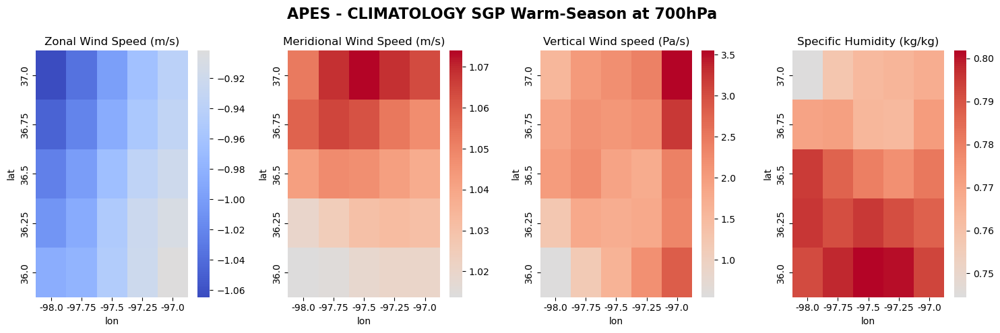

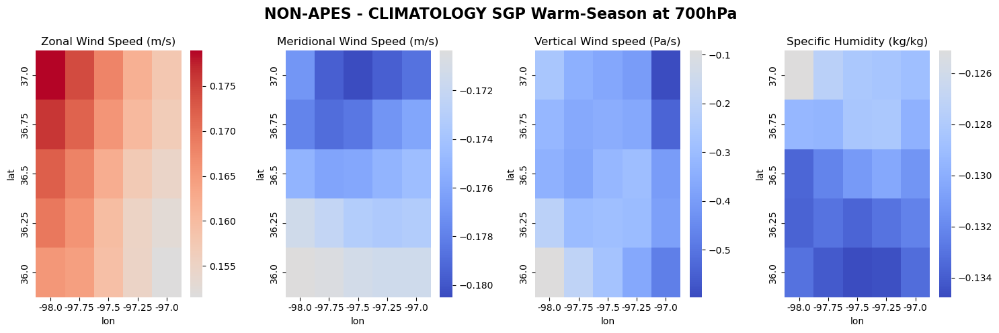

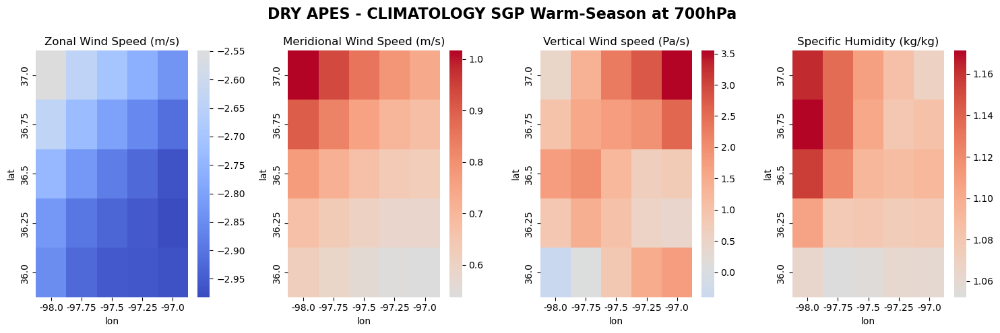

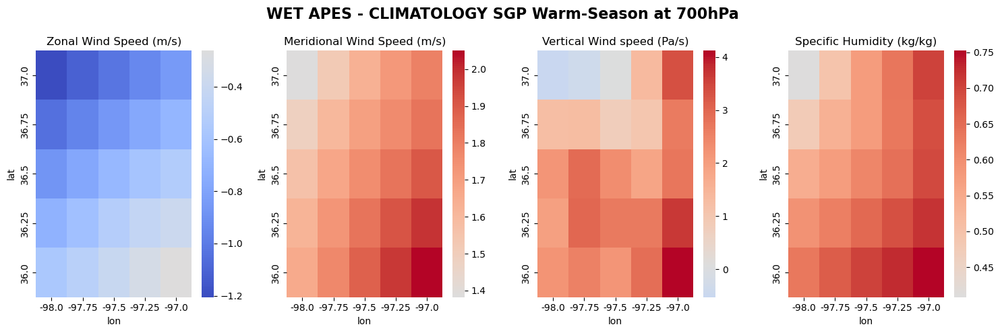

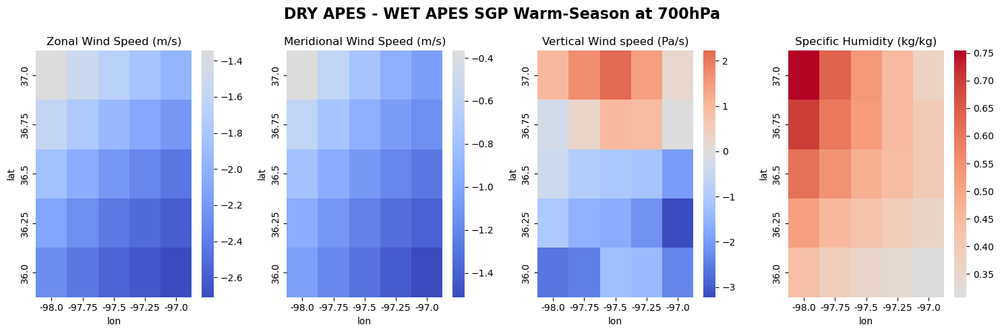

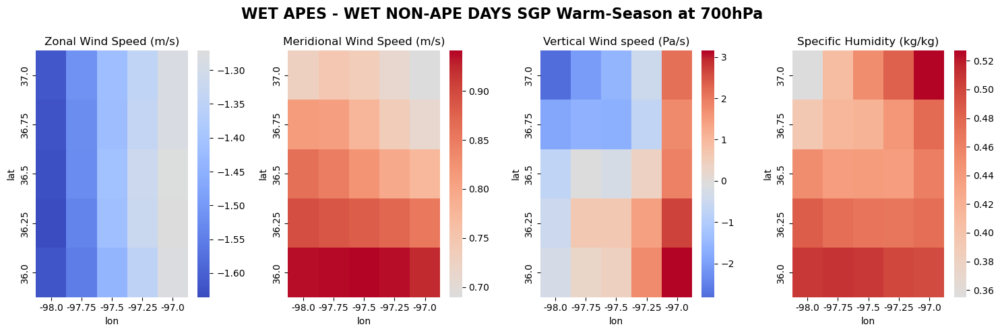

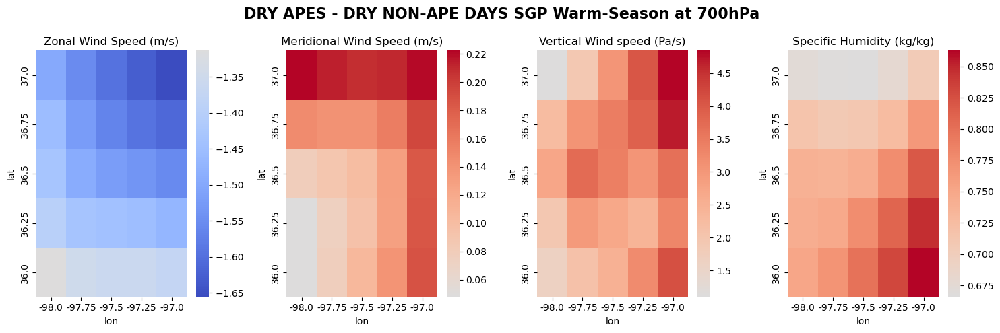

In [71]:
dfs = {
'APES - CLIMATOLOGY': ape_min_clim, 
'NON-APES - CLIMATOLOGY': nonape_min_clim,
'DRY APES - CLIMATOLOGY': dryape_min_clim,
'WET APES - CLIMATOLOGY': wetape_min_clim,
'DRY APES - WET APES': dryape_min_wetape,
'WET APES - WET NON-APE DAYS': wetape_min_wetnonape,       
'DRY APES - DRY NON-APE DAYS': dryape_min_drynonape}

for _name, _type in dfs.items():
    
    fig, axes = plt.subplots(1, 4, figsize=(15, 5))

    all_vars = ['u', 'v', 'w', 'q']

    for i, var in enumerate(all_vars):
        
        if var == 'u':
            
            title = 'Zonal Wind Speed (m/s)'
        
        elif var == 'v':
            
            title = 'Meridional Wind Speed (m/s)'
        
        elif var == 'w':
            
            title = 'Vertical Wind speed (Pa/s)'
            
        elif var == 'q':
            
            title = 'Specific Humidity (kg/kg)'
            

        heat = _type.pivot(index='lat', columns='lon', values=var)[::-1]
        
        flat = [value for row in heat.values for value in row]
        
        absolute = np.abs(flat)

        closest_index = np.argmin(absolute)

        center = flat[closest_index]
        
        vmin = np.nanmin(heat.values)
        
        vmax = np.nanmax(heat.values)
        
        cmap = sns.color_palette("coolwarm", as_cmap=True)
        
        sns.heatmap(heat, cmap=cmap, center=center, ax=axes[i], vmin=vmin, vmax=vmax)
    
        axes[i].set_title("{}".format(title))

    plt.tight_layout()

    fig.suptitle("{} SGP Warm-Season at 700hPa".format(_name), fontsize=16, fontweight='bold')

    plt.subplots_adjust(top=0.85)
    
    plt.show()


Observations:

- for all APE-climatology cases, specific humidity & meridional wind speeds are higher at 700hpa and zonal wind speeds are lower, despite column figure which shows zonal transport differential is higher & meridional transport differential is lower

- for dry-apes, zonal wind speeds are lower than climatology despite zonal transport differential (from column figure) being larger. meridional wind speeds are higher than climatology despite meridional transport differential (from column figure) being negative

- for wet-apes, zonal wind speeds are lower 